# Unet result close set seperate

In [2]:
# -- coding: utf-8 --
#1.load libraries
#from __future__ import print_function, division
import SimpleITK as sitk
import numpy as np
import csv
from glob import glob
import pandas as pd
import os
import scipy.ndimage
from tqdm import tqdm #progress tube
from skimage.morphology import ball, disk, dilation, binary_erosion, remove_small_objects, erosion, closing, reconstruction, binary_closing
from skimage import measure, morphology
from skimage.measure import label,regionprops, perimeter
from skimage.morphology import binary_dilation, binary_opening
from skimage.filters import roberts, sobel
from skimage import measure, feature
from skimage.segmentation import clear_border
from skimage import data
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
from scipy import ndimage as ndi

from keras.models import Model, Sequential, load_model
from keras.layers import Input, Dense, Dropout,Flatten, merge
from keras.optimizers import SGD, Adam
from keras.layers import Convolution2D, MaxPooling2D, Convolution3D, MaxPooling3D,UpSampling2D
from keras.layers import Conv2D
from keras.layers.merge import concatenate
from keras.utils import np_utils
from keras import backend as K

import tensorflow as tf
import matplotlib.pyplot as plt
import matplotlib.animation as animation



Using TensorFlow backend.


In [3]:
def get_segmented_lungs(im, show=False):  
    '''
    This funtion segments the lungs from the given 2D slice.
    '''
    if show == True:
        plot = plt.subplot()
        plot.imshow(im, cmap=plt.cm.bone)
        plt.show()
    '''
    Step 1: Convert into a binary image. 
    '''
    binary = im < -230
    if show == True:
        plot = plt.subplot()
        plot.imshow(binary, cmap=plt.cm.bone) 
        plt.show()
    cleared = clear_border(binary)

    if show == True:
        plot = plt.subplot()
        plot.imshow(cleared, cmap=plt.cm.bone) 
        print "3"
        plt.show()

    '''
    Step 3: Label the image.
    '''
    label_image = label(cleared)
    if show == True:
        plot = plt.subplot()
        plot.imshow(label_image, cmap=plt.cm.bone)
        plt.show()
    '''
    Step 4: Keep the labels with 2 largest areas.
    '''
    areas = [r.area for r in regionprops(label_image)]
    areas.sort()
    if len(areas) > 2:
        for region in regionprops(label_image):
            if region.area < areas[-2]:
                for coordinates in region.coords:                
                       label_image[coordinates[0], coordinates[1]] = 0

    binary = label_image > 0
    if show == True:
        plot = plt.subplot()
        plot.imshow(binary, cmap=plt.cm.bone)
        plt.show()
    '''
    Step 5: Erosion operation with a disk of radius 2. This operation is 
    seperate the lung nodules attached to the blood vessels.
    '''
    selem = disk(2)
    binary = binary_erosion(binary, selem)
    if show == True:
        plot = plt.subplot()
        plot.imshow(binary, cmap=plt.cm.bone)
        plt.show()
    '''
    Step 6: Closure operation with a disk of radius 10. This operation is 
    to keep nodules attached to the lung wall.
    '''
    selem = disk(10)
    binary = binary_closing(binary, selem)
    if show == True:
        plot = plt.subplot()
        plot.imshow(binary, cmap=plt.cm.bone)
        plt.show()
    '''
    Step 7: Fill in the small holes inside the binary mask of lungs.
    '''
    edges = roberts(binary)
    binary = ndi.binary_fill_holes(edges)
    if show == True:
        plot = plt.subplot()
        plot.imshow(binary, cmap=plt.cm.bone)
        plt.show()
    '''
    Step 8: Superimpose the binary mask on the input image.
    '''
    get_high_vals = binary == 0
    im[get_high_vals] = -1000
    
    
    if show == True:
        plot = plt.subplot()
        plot.imshow(im, cmap=plt.cm.bone)
        plt.show()
    
    im[im < threshold] = -1000
    if show == True:
        plot = plt.subplot()
        plot.imshow(im, cmap=plt.cm.bone)
        plt.show()
    
    return im



#####
# remove the two biggest vessels in the lung
#####


def get_filename(file_list, case):
    for f in file_list:
        if case in f:
            return(f)


def filt_vessels(segmented_ct_scan):
    print "filting vessels!"
    selem = ball(2)
    
    segmented_ct_scan0 = segmented_ct_scan.copy() 
    linking_scan = segmented_ct_scan0.copy()
    linking_scan[linking_scan >= -350] = 1
    linking_scan[linking_scan < -350] = 0

    binary = binary_closing(linking_scan, selem)
    label_scan = label(binary, neighbors=8)
    #label_scan = label(segmented_ct_scan, neighbors=4) 

    rr =  regionprops(label_scan)
    areas = [r.area for r in rr]
    areas.sort()
    print "areas: ", areas[-6:-1]


    for r in rr:
        max_x, max_y, max_z = 0, 0, 0
        min_x, min_y, min_z = 1000, 1000, 1000

        rds = r.coords

        for c in rds:
            max_z = max(c[0], max_z)
            max_y = max(c[1], max_y)
            max_x = max(c[2], max_x)

            min_z = min(c[0], min_z)
            min_y = min(c[1], min_y)
            min_x = min(c[2], min_x)
        if (min_z == max_z or min_y == max_y or min_x == max_x or r.area > areas[-3]):
            for c in rds:
                segmented_ct_scan0[c[0], c[1], c[2]] = -1000
        else:
            index = (max((max_x - min_x), (max_y - min_y), (max_z - min_z))) / (min((max_x - min_x), (max_y - min_y) , (max_z - min_z)))
    return segmented_ct_scan0

In [4]:
def plot_3d(image, name, threshold=-1000):
    # Position the scan upright, 
    # so the head of the patient would be at the top facing the camera
    p = image.transpose(2,1,0)
    p = p[:,:,::-1]    
    #print len(measure.marching_cubes(p, threshold))
    verts, faces, a, b = measure.marching_cubes(p, threshold)

    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')
    # Fancy indexing: `verts[faces]` to generate a collection of triangles
    mesh = Poly3DCollection(verts[faces], alpha=0.1)
    face_color = [0.5, 0.5, 1]
    mesh.set_facecolor(face_color)
    ax.add_collection3d(mesh)

    ax.set_xlim(0, p.shape[0])
    ax.set_ylim(0, p.shape[1])
    ax.set_zlim(0, p.shape[2])
    plt.savefig(outpath + 'pics/' + name +'.png')
    print "plotting : ", name
    #plt.show()
    plt.close()


def unet(inputs_shape, kernel_size=3, pool_size=2):
    """
    :param inputs_shape: tuple,e.g.(bs,512,512)
    :param kernel_size:
    :param pool_size:
    :return:
    """   
    inputs = Input(inputs_shape, name='inputs')  # (bs,512,512)
    conv1 = Convolution2D(24, 3, 3, activation='relu', border_mode='same')(inputs)
    conv1 = Dropout(0.5)(conv1)
    conv1 = Convolution2D(24, 3, 3, activation='relu', border_mode='same')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Convolution2D(32, 3, 3, activation='relu', border_mode='same')(pool1)
    conv2 = Dropout(0.5)(conv2)
    conv2 = Convolution2D(32, 3, 3, activation='relu', border_mode='same')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)
               
    conv3 = Convolution2D(16, 3, 3, activation='relu', border_mode='same')(pool2)
    conv3 = Dropout(0.5)(conv3)
    conv3 = Convolution2D(16, 3, 3, activation='relu', border_mode='same')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)
                         

    conv4 = Convolution2D(24, 3, 3, activation='relu', border_mode='same')(pool3)
    conv4 = Dropout(0.5)(conv4)
    conv4 = Convolution2D(24, 3, 3, activation='relu', border_mode='same')(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(conv4)

    
    conv5 = Convolution2D(48, 3, 3, activation='relu', border_mode='same')(pool4)
    conv5 = Dropout(0.5)(conv5)
    conv5 = Convolution2D(48, 3, 3, activation='relu', border_mode='same')(conv5)

    
    up6 = merge([UpSampling2D(size=(2, 2))(conv5), conv4], mode='concat', concat_axis=3)
    conv6 = Convolution2D(24, 3, 3, activation='relu', border_mode='same')(up6)
    conv6 = Dropout(0.5)(conv6)
    conv6 = Convolution2D(24, 3, 3, activation='relu', border_mode='same')(conv6)

    up7 = merge([UpSampling2D(size=(2, 2))(conv6), conv3], mode='concat', concat_axis=3)
    conv7 = Convolution2D(16, 3, 3, activation='relu', border_mode='same')(up7)
    conv7 = Dropout(0.5)(conv7)
    conv7 = Convolution2D(16, 3, 3, activation='relu', border_mode='same')(conv7)

    up8 = merge([UpSampling2D(size=(2, 2))(conv7), conv2], mode='concat', concat_axis=3)
    conv8 = Convolution2D(32, 3, 3, activation='relu', border_mode='same')(up8)
    conv8 = Dropout(0.5)(conv8)
    conv8 = Convolution2D(32, 3, 3, activation='relu', border_mode='same')(conv8)

    up9 = merge([UpSampling2D(size=(2, 2))(conv8), conv1], mode='concat', concat_axis=3)
    conv9 = Convolution2D(24, 3, 3, activation='relu', border_mode='same')(up9)
    conv9 = Dropout(0.5)(conv9)
    conv9 = Convolution2D(24, 3, 3, activation='relu', border_mode='same')(conv9)

    conv10 = Convolution2D(1, 1, 1, activation='sigmoid')(conv9)

    model = Model(inputs=inputs, outputs=conv10)
    model.summary()
    return model
  

In [5]:
#model = unet(inputs_shape=(512, 512, 512, 1))
model = unet(inputs_shape=(512,512, 1))
model.load_weights('model/unet-filt-model/unet-filt-0.58.mdl')

/usr/local/lib/python2.7/dist-packages/keras/legacy/interfaces.py:86: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(24, (3, 3), padding="same", activation="relu")`
  '` call to the Keras 2 API: ' + signature)
/usr/local/lib/python2.7/dist-packages/keras/legacy/interfaces.py:86: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(32, (3, 3), padding="same", activation="relu")`
  '` call to the Keras 2 API: ' + signature)
/usr/local/lib/python2.7/dist-packages/keras/legacy/interfaces.py:86: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(16, (3, 3), padding="same", activation="relu")`
  '` call to the Keras 2 API: ' + signature)
/usr/local/lib/python2.7/dist-packages/keras/legacy/interfaces.py:86: UserWarning: Update your `Conv2D` call to the Keras 2 API: `Conv2D(48, (3, 3), padding="same", activation="relu")`
  '` call to the Keras 2 API: ' + signature)
/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:61: UserWarning: Th

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
inputs (InputLayer)          (None, 512, 512, 1)       0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 512, 512, 24)      240       
_________________________________________________________________
dropout_1 (Dropout)          (None, 512, 512, 24)      0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 512, 512, 24)      5208      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 256, 256, 24)      0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 256, 256, 32)      6944      
_________________________________________________________________
dropout_2 (Dropout)          (None, 256, 256, 32)      0         
__________

In [6]:
def seperate_nodule(origin, filt, unet_mask ,nodules,diams):
    selem = ball(2)
    segmented_ct_scan = unet_mask.copy()
    #segmented_ct_scan = segmented_ct_scan0.copy()
    segmented_ct_scan[segmented_ct_scan >= 0.9999] = 1
    segmented_ct_scan[segmented_ct_scan < 0.9999] = 0

    #binary = binary_closing(segmented_ct_scan, selem)
    label_scan = label(binary, neighbors=8)

    rr =  regionprops(label_scan)
    areas = [r.area for r in rr]
    areas.sort()
    
    visit = [0 for i in nodules]
    print visit
    
    areas = []
    orig_data = []
    filt_data = []
    res_lb = []
    res_center = []
    #traverse all the center of seperated condinate nodules
    print unet_mask.shape
    for r in rr:
        if r.area < 24 or r.area > 34000:    #the condinate nodule is too small or too big and skip it
            continue
            
        rds = r.coords
        
        #get the geometrical center of nthe nodule
        x = y = z = cnt = 0
        for point in rds:
            x += point[2]
            y += point[1]
            z += point[0]
            cnt += 1
        x = int(np.rint(x/cnt))
        y = int(np.rint(y/cnt))
        z = int(np.rint(z/cnt))
        
        #build a cube to get the seperated nodule
        cube = np.zeros([49,49,49], dtype = int)
        cube1 = np.zeros([49,49,49], dtype = int)
        cube[:][:][:] = -1000
        cube1[:][:][:] = -1000
        cnt = 0
        for point in rds:
            xx = int(np.rint((point[2]-x)+24))
            yy = int(np.rint((point[1]-y)+24))
            zz = int(np.rint((point[0]-z)+24))
            if xx>=0 and xx<49 and yy>=0 and yy<49 and zz>=0 and zz<49:
                cnt += 1
                cube[zz][yy][xx] = origin[z][y][x]
                cube1[zz][yy][xx] = filt[z][y][x]
        if cnt < 20 or np.max(cube) < -990:
            print 'noting! = ',rds
            continue
            
        areas.append(r.area)                
        orig_data.append(cube)
        filt_data.append(cube1)
        res_center.append([x, y, z])
        
        #judge whether the condinate nodule is the real nodule
        mx = 66
        get = -1
        for idx, nd in enumerate(nodules):
            dist = (x-nd[0])*(x-nd[0])+(y-nd[1])*(y-nd[1])+(z-nd[2])*(z-nd[2])
            dd = diams[idx]
            true_area = 3.1415/6*dd*dd*dd
            if dist < mx and visit[idx] < 1 and r.area < 3 * true_area:
                if get > -1:
                    visit[get] = 0
                get = idx
                mx = dist
                visit[idx] = 1
                
        if get >= 0:
            res_lb.append(1)    #it's the real nodule
        else:
            res_lb.append(0)    #it's the false nodule
    print areas        
    print 'all nodule:', len(visit), 'detected:', np.sum(visit)
    print 'condinate nodule:', len(res_lb)
    return np.array(orig_data), np.array(filt_data), np.array(res_lb), np.array(res_center)

###Run to 155 of 00-04

In [7]:
#------------------------------------------------------------------------------------------
#read in the mhd file and csv
train_path = '/media/izm/Normal/train_subset00-04/'
#train_path = '/media/izm/Entertain/fjj/train_subset00-04/'
file_list = glob(train_path + "*.mhd")
#file_list = ['/home/izm/work/fjj/data/train_subset00/LKDS-00066.mhd']
df_node = pd.read_csv('annotations.csv')
pic_path = ''
#4.1 将数据关联至csv
df_node["file"] = df_node["seriesuid"].map(lambda file_name: get_filename(file_list, file_name))
df_node = df_node.dropna()

print file_list


#-----------------some parameters------------#
threshold = -320
thick = 32
batch = 4
zfile = open("output/z-area.txt", 'w')
outpath = '/media/izm/Entertain/fjj/classify/'
cnt = 0
for fcount, img_file in enumerate(tqdm(file_list)):
    mini_df = df_node[df_node["file"]==img_file] #get all nodules associate with file
    #if fcount < 40:
    #   continue
    if mini_df.shape[0]>0:                      # some files may not have a nodule--skipping those 
        # load the data once
        itk_img = sitk.ReadImage(img_file)
        img_array = sitk.GetArrayFromImage(itk_img) # indexes are z,y,x (notice the ordering)
        print img_array.shape
        num_z, height, width = img_array.shape        #heightXwidth constitute the transverse plane
        if img_array.shape[1] != 512 or img_array.shape[0] > 850:
            continue

        origin = np.array(itk_img.GetOrigin())      # x,y,z  Origin in world coordinates (mm)
        spacing = np.array(itk_img.GetSpacing())    # spacing of voxels in world coor. (mm)
        print "origin center = ", origin, "; scaling = ", spacing
        # go through all nodes (why just the biggest?)
        count = 0

        #### create the delt_scan from the original scans as u-net input
        img_cp = img_array.copy()
        mask_array = []
        for slc in img_cp:
            mask_array.append(get_segmented_lungs(slc))
        segmented = np.array(mask_array, np.int16)
        delt_scan = filt_vessels(segmented)
        name = img_file.split('/')[-1]
        
        nodules = []
        diams = []
        for node_idx, cur_row in mini_df.iterrows():			
            node_x = cur_row["coordX"]
            node_y = cur_row["coordY"]
            node_z = cur_row["coordZ"]
            diam = cur_row["diameter_mm"]

            center = np.array([node_x, node_y, node_z])   # nodule center
            v_center = np.rint((center-origin)/spacing)  # nodule center in voxel space (still x,y,z ordering)
            nodules.append(v_center)
            diams.append(diam)
            print "v_center = ", v_center, "diam=", diam
            count += 1
            idx_str = '-'+str(count)            
        
        input_scan = np.array([delt_scan]).transpose((1,2,3,0))
        
        unet_sgm = model.predict(input_scan, batch_size = 4)
        unet_sgm = unet_sgm.transpose(3,0,1,2)
        unet_sgm = unet_sgm[0]
        print 'seperating: ',name
        org_cubes, segment_cubes, labels, centers = seperate_nodule(img_array, delt_scan, unet_sgm, nodules, diams)
        #np.save(outpath+'origin/org-'+name, org_cubes)
        np.save(outpath+'delted/dlt-'+name, segment_cubes)
        np.save(outpath+'labels/lb-'+name, labels)
        np.save(outpath+'centers/ctr-'+name, centers)
        for idx,cb in enumerate(org_cubes):
            plot_3d(cb, name+'-'+str(idx)+'-'+str(labels[idx]), -1000)
        print 'finish file', fcount
        


0it [00:00, ?it/s]

[]


[array([ 126.,  238.,  262.]), array([ 154.,  290.,  421.])]
[[346, 214, 106], [311, 193, 119], [290, 336, 152], [191, 213, 175], [314, 233, 180], [207, 228, 193], [194, 186, 195], [285, 486, 205], [194, 152, 322], [359, 159, 333], [219, 192, 324], [350, 161, 346], [270, 227, 349], [295, 212, 358], [304, 111, 444], [304, 122, 447], [299, 116, 452], [228, 143, 467]]
i
18
-------- 0


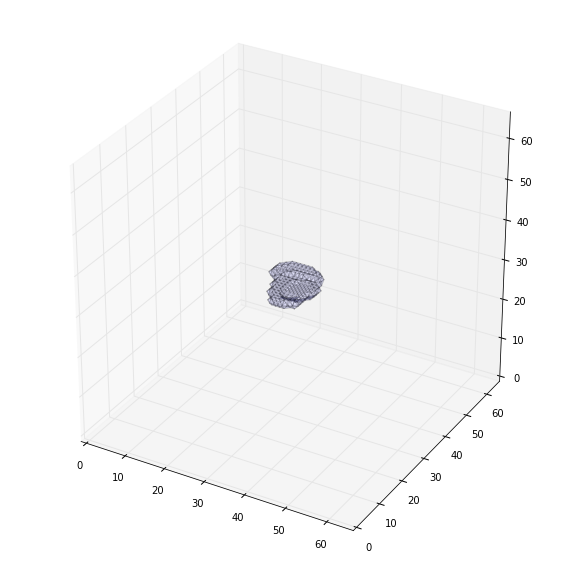

-------- 0


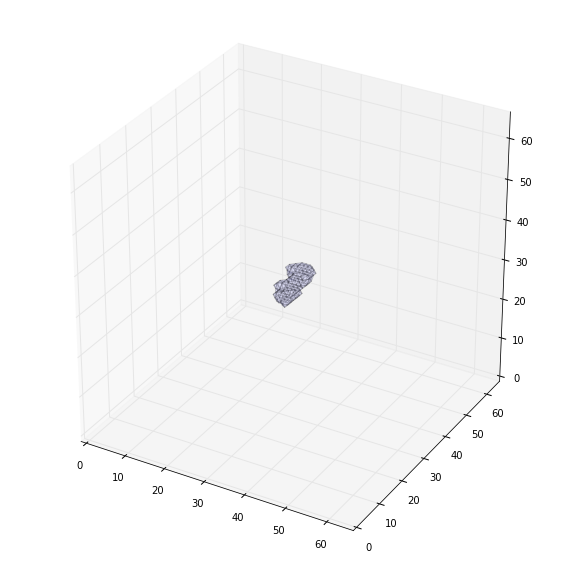

-------- 0


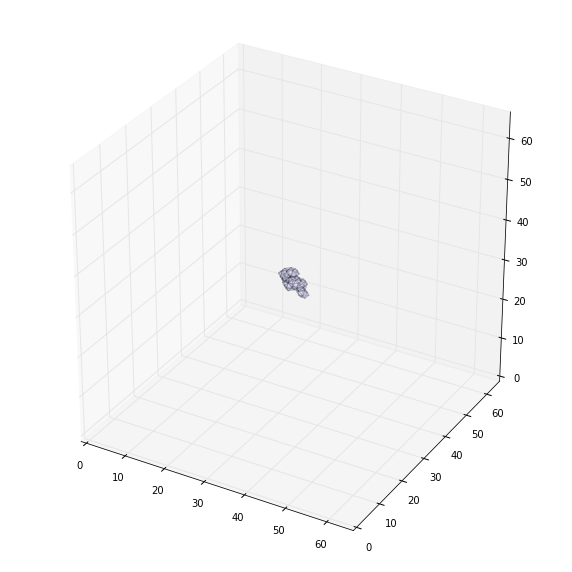

-------- 0


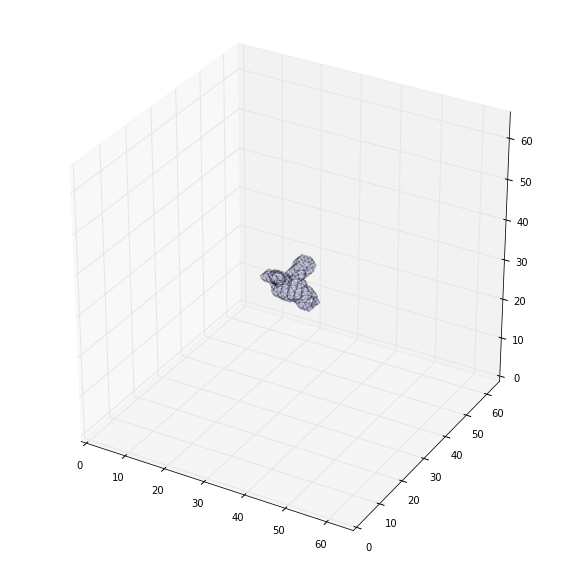

-------- 0


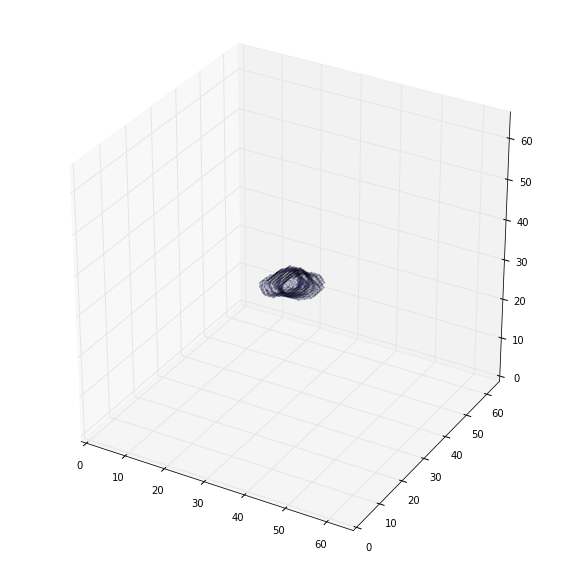

-------- 0


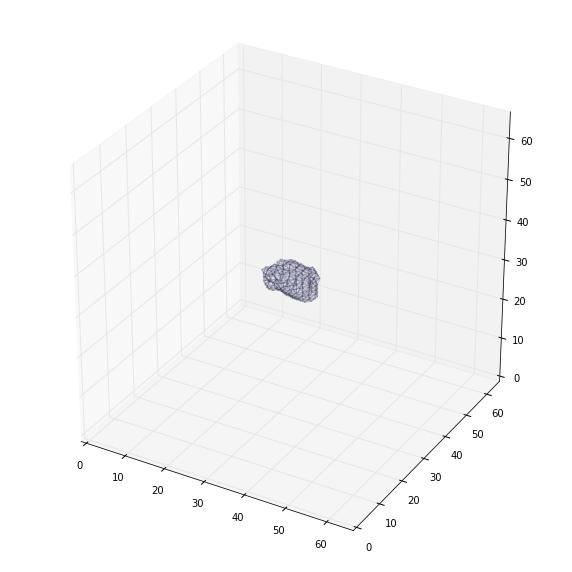

-------- 0


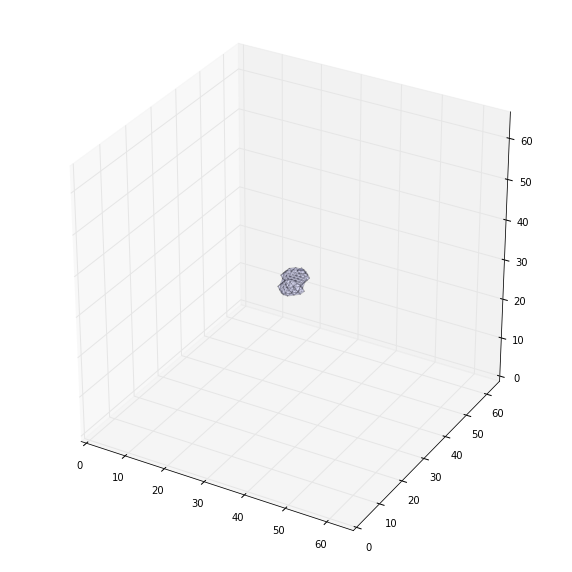

-------- 0


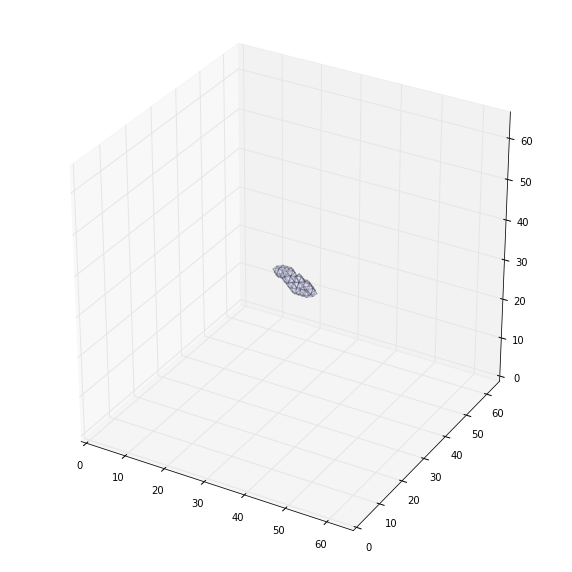

-------- 0


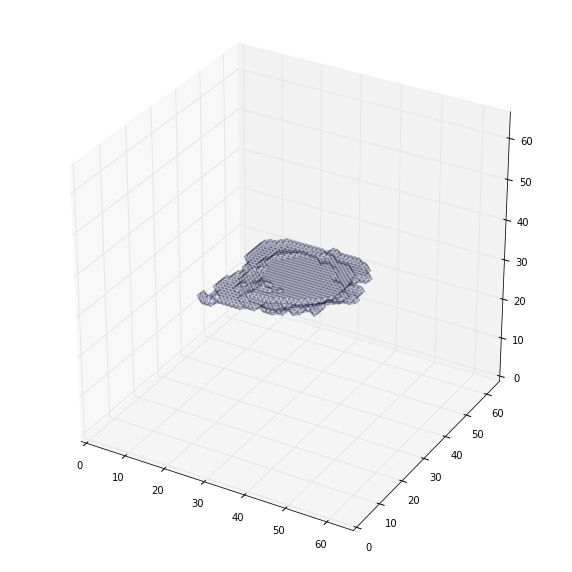

-------- 0


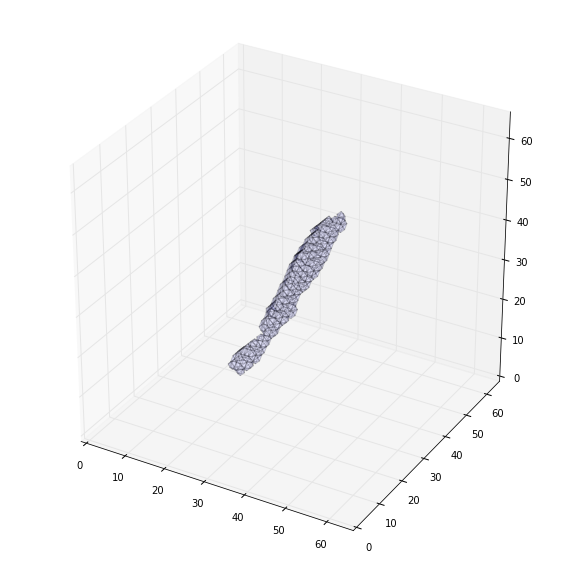

-------- 0


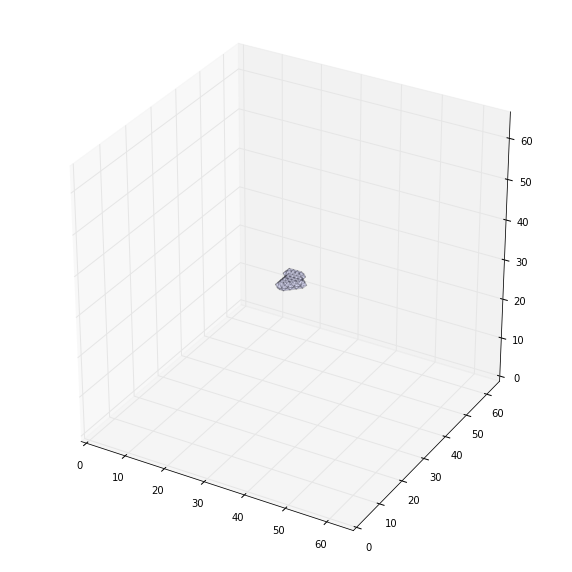

-------- 0


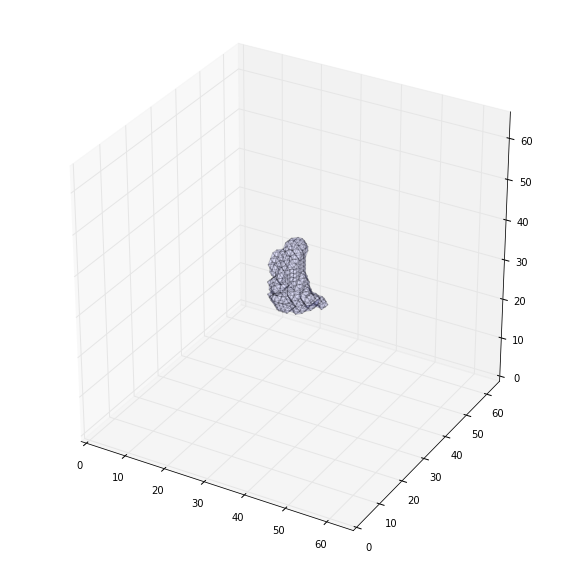

-------- 0


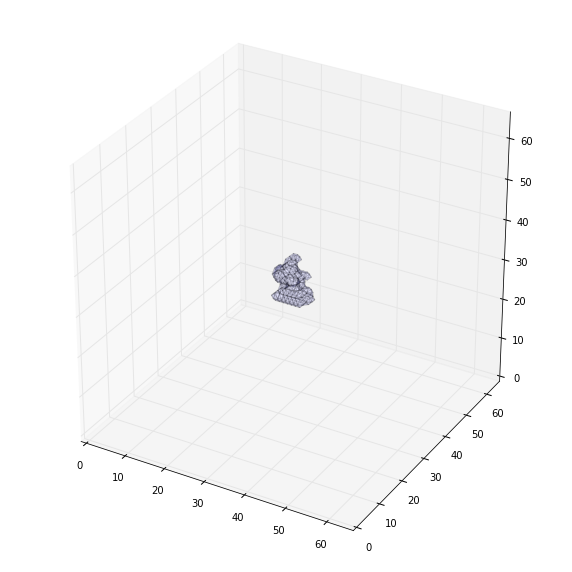

-------- 0


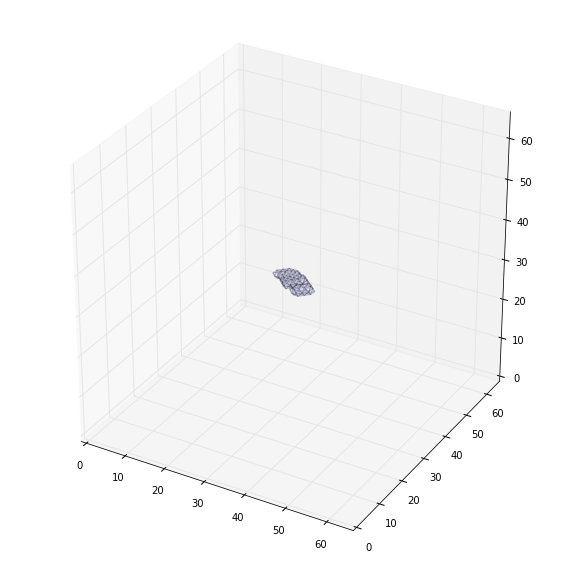

-------- 0


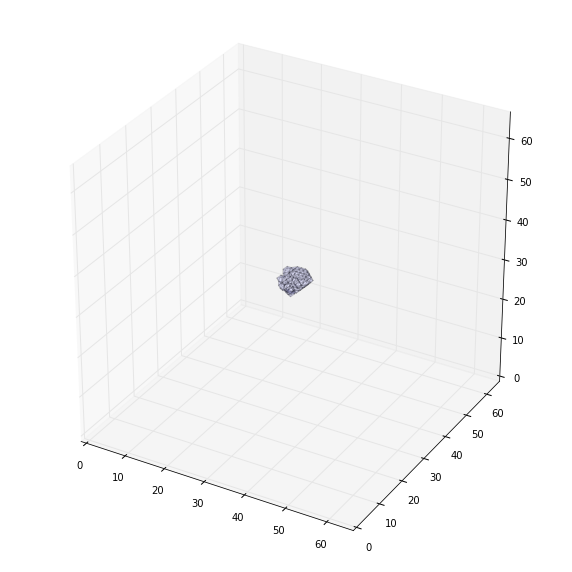

-------- 0


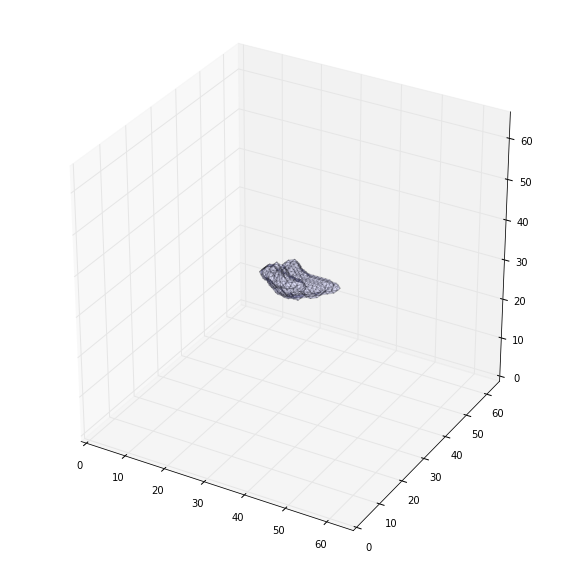

-------- 0


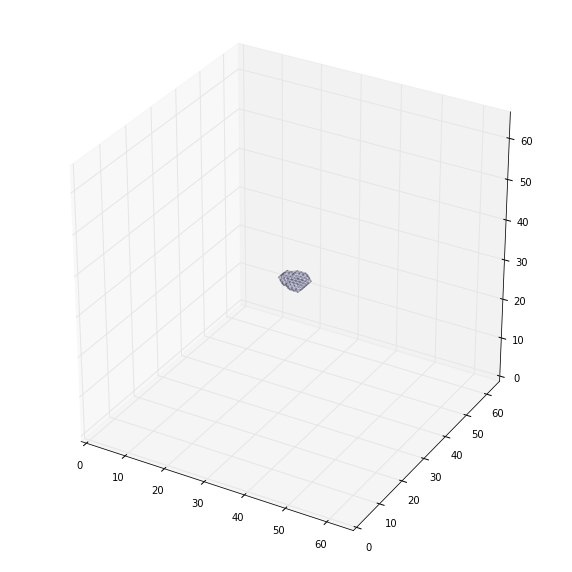

-------- 0


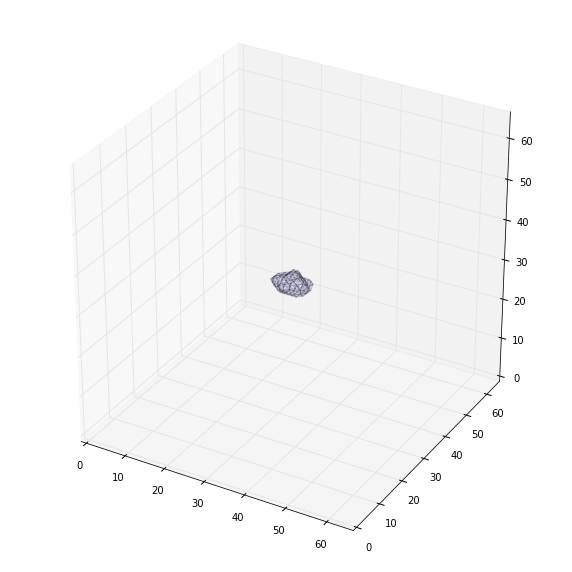

In [17]:

#orig_cubes, segment_cubes, labels, center = seperate_nodule(img_array, delt_scan, unet_sgm, nodules)
print nodules
print center
raw_input()
print len(orig_cubes)
for idx, cc in enumerate(orig_cubes):
    print '--------', labels[idx]
    plot_3d(cc, -1000)

In [19]:
res = np.load('segment.npy')
print res.shape
filt_vessels(res[0])

(1, 32, 512, 512)
[1, 1, 1, 1, 1, 1, 9, 9, 9, 16, 27, 32, 50, 151, 242]
3.0 207.0 227.0
6.0 242.0 222.0
6.0 204.0 233.0
6.0 240.0 222.0
7.0 202.0 234.0
12.0 199.0 244.0
12.0 248.0 200.0
13.0 247.0 197.0
19.0 260.0 389.0
19.0 183.0 245.0
20.0 199.0 186.0
20.0 200.0 188.0
23.0 277.0 395.0
26.0 252.0 221.0
25.0 257.0 228.0


array([[[ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        ..., 
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.]],

       [[ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        ..., 
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.]],

       [[ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        ..., 
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.]],

       ..., 
       [[ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0.,  0.],
        [ 0.,  0.,  0., ...,  0.,  0., 

size= 379


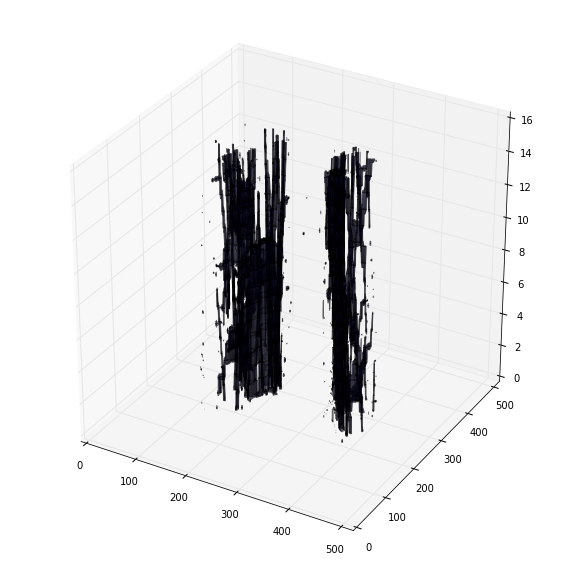

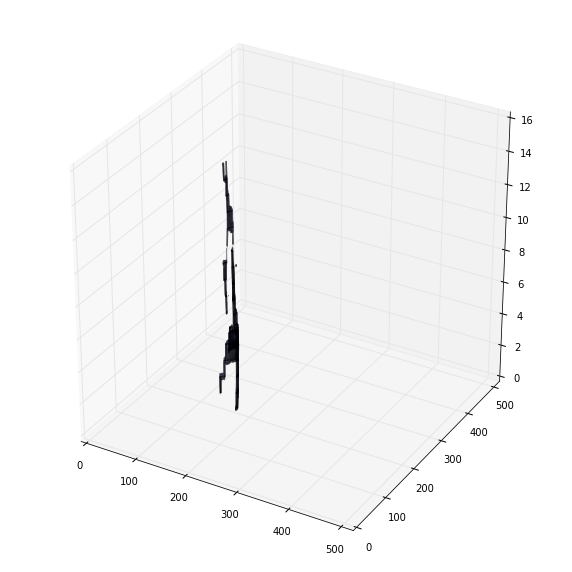

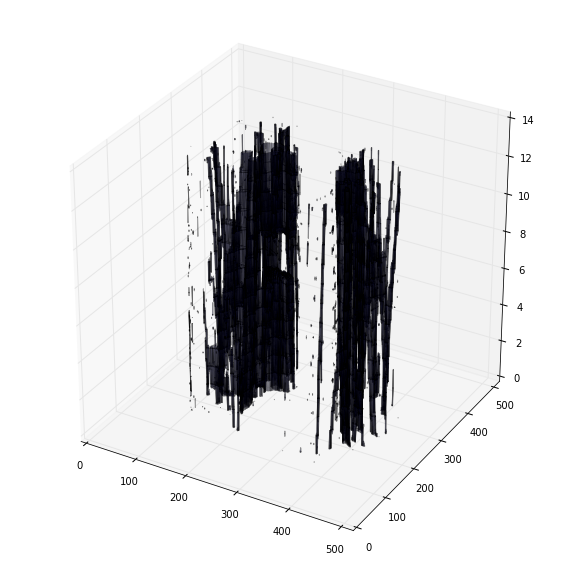

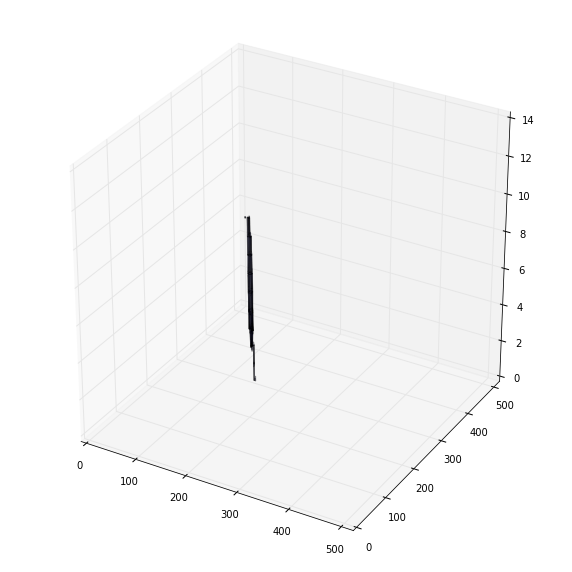

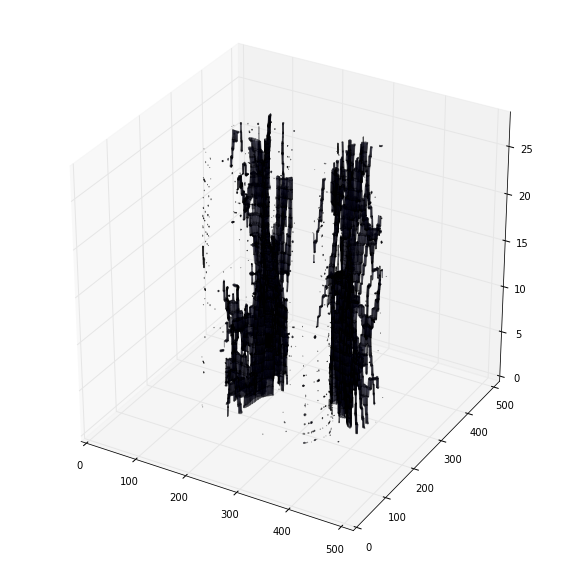

...

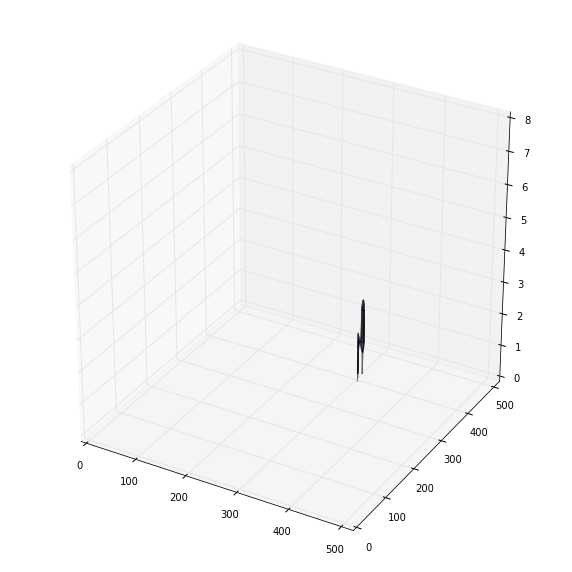

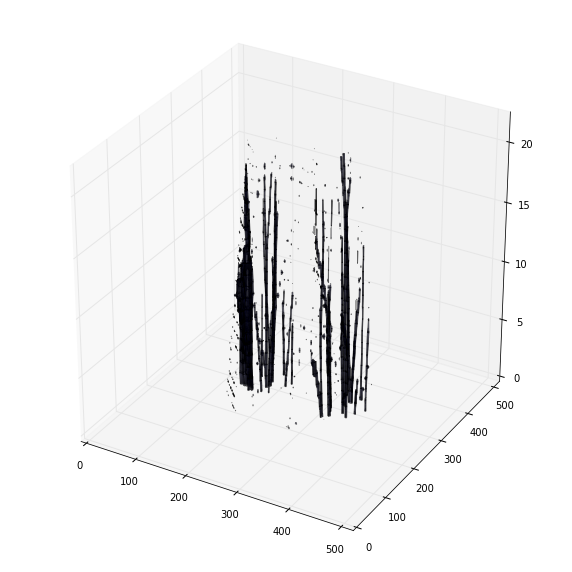

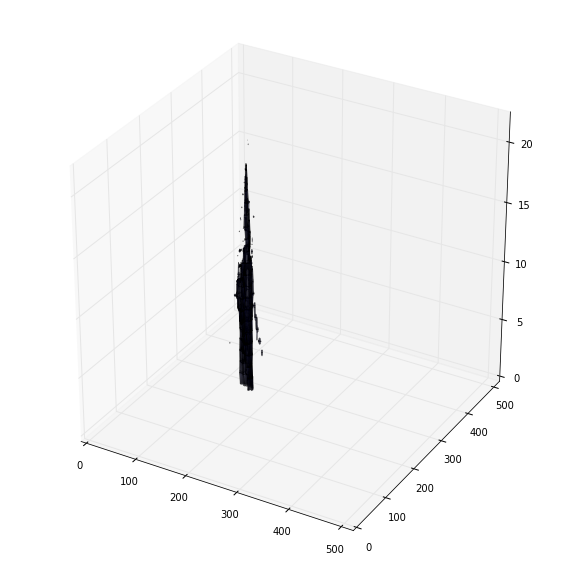

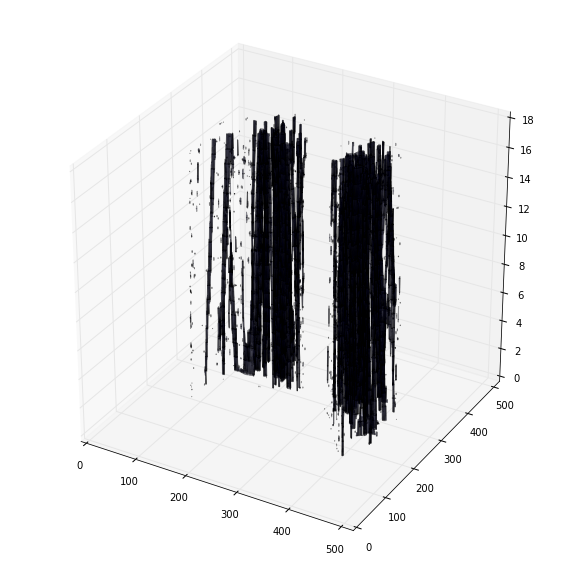

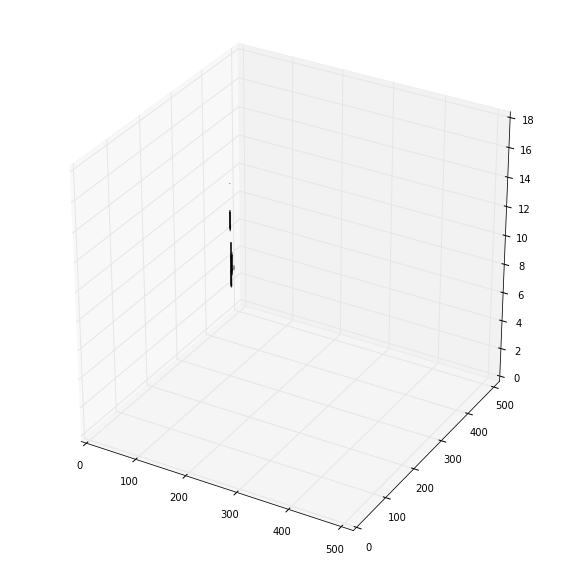

size= 379


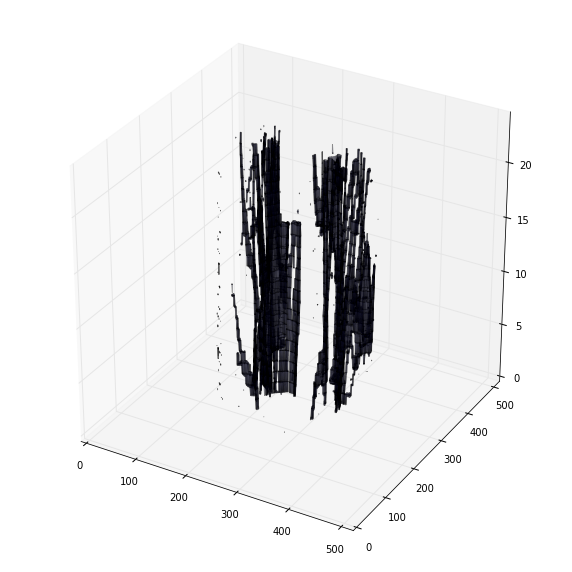

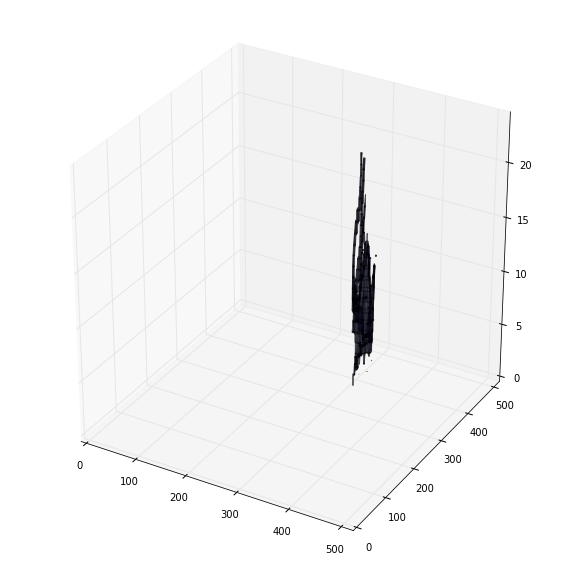

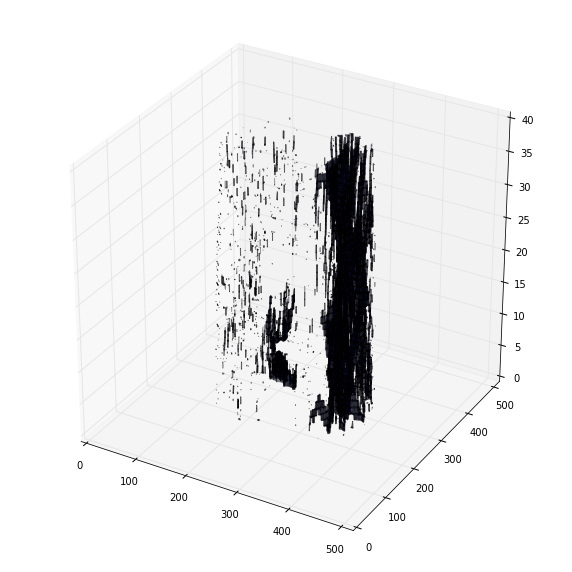

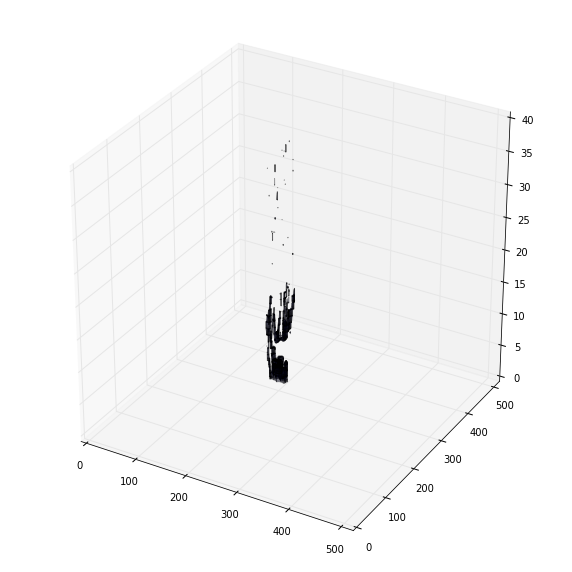

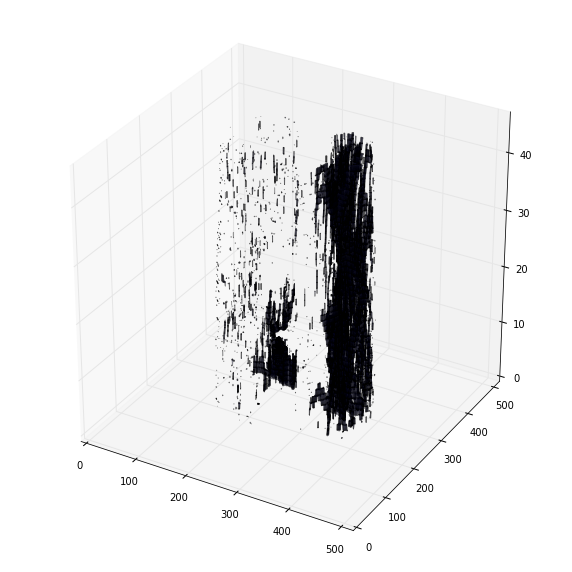

...

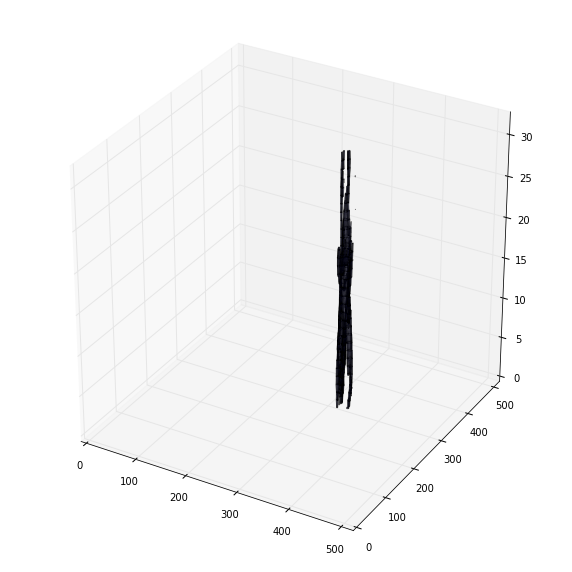

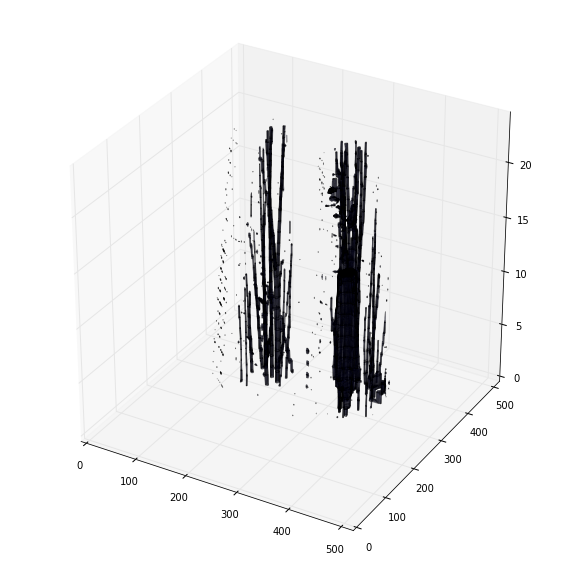

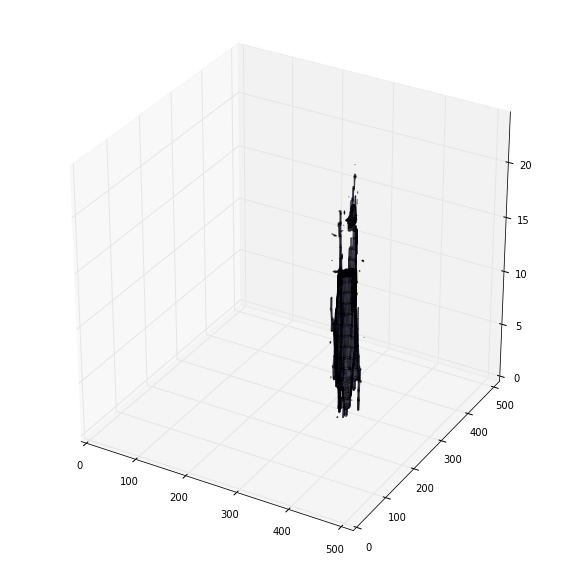

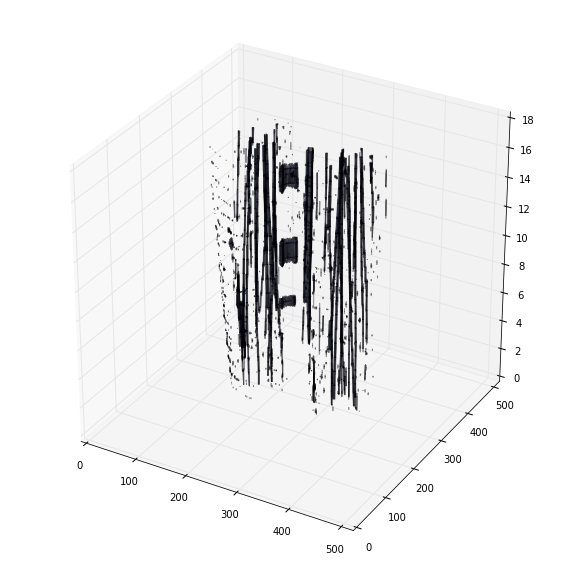

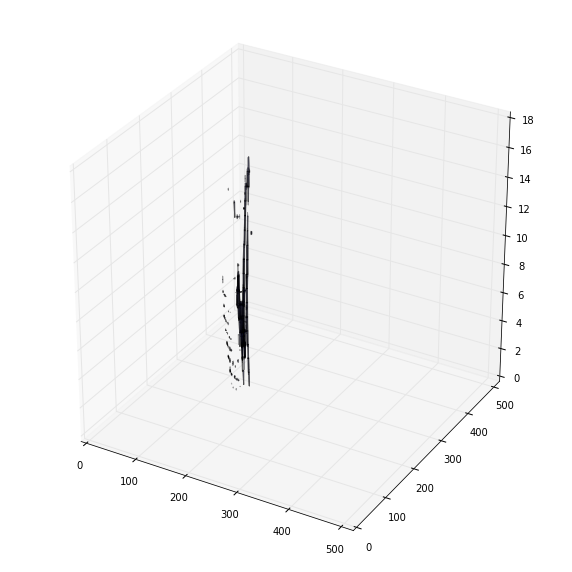

(174, 512, 512, 1)
(722, 512, 512, 1)


/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:93: UserWarning: The `merge` function is deprecated and will be removed after 08/2017. Use instead layers from `keras.layers.merge`, e.g. `sum`, `concatenate`, etc.
/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:98: UserWarning: The `merge` function is deprecated and will be removed after 08/2017. Use instead layers from `keras.layers.merge`, e.g. `sum`, `concatenate`, etc.
/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:103: UserWarning: The `merge` function is deprecated and will be removed after 08/2017. Use instead layers from `keras.layers.merge`, e.g. `sum`, `concatenate`, etc.
/usr/local/lib/python2.7/dist-packages/ipykernel_launcher.py:108: UserWarning: The `merge` function is deprecated and will be removed after 08/2017. Use instead layers from `keras.layers.merge`, e.g. `sum`, `concatenate`, etc.


_________________________________________________________________
Layer (type)                 Output Shape              Param #   
inputs (InputLayer)          (None, 512, 512, 1)       0         
_________________________________________________________________
conv2d_20 (Conv2D)           (None, 512, 512, 24)      240       
_________________________________________________________________
dropout_10 (Dropout)         (None, 512, 512, 24)      0         
_________________________________________________________________
conv2d_21 (Conv2D)           (None, 512, 512, 24)      5208      
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 256, 256, 24)      0         
_________________________________________________________________
conv2d_22 (Conv2D)           (None, 256, 256, 32)      6944      
_________________________________________________________________
dropout_11 (Dropout)         (None, 256, 256, 32)      0         
__________

IOError: Unable to open file (Unable to open file: name = 'model/vessel/0-370_batch-12_eph-2', errno = 2, error message = 'no such file or directory', flags = 0, o_flags = 0)

In [3]:

     






################## main ops 
#totally there are 450 cases, [0-350] for train, [350-450] for test
data, lb = load_data(0,10)

shuffle_idx = range(data.shape[0])
data = data[shuffle_idx]
lb = lb[shuffle_idx]

test_data, test_lb = load_data(310,352)
shuffle_idx = range(test_data.shape[0])
test_data = test_data[shuffle_idx]
test_lb = test_lb[shuffle_idx]

print data.shape
print test_data.shape





def main():
    optimizer = Adam(lr=5e-4)
    loss = dice_coef_loss
    metrics = [dice_coef]
    bs = 12
    nb_epochs = 2
    input_h, input_w = 512, 512

    model = unet(inputs_shape=(input_h, input_w, input_h, 1))
    model.compile(optimizer=optimizer, loss=loss, metrics=metrics)    
    model.load_weights('model/'+'vessel/'+'0-370_batch-12_eph-2')

   
    print "start fitting"
    with tf.device("/cpu:0"):
        model.fit(data, lb, batch_size = bs, epochs = nb_epochs, validation_data=(test_data, test_lb))  
        save_name = "vessel-"+"eph-"+str(nb_epochs)       
        model.save_weights("model/"+'vessel/'+save_name)

        print "model finish trianning and save weights: ", save_name

        
    return model

model = main()

# #Use model do prediction

In [21]:
plt.clear()

AttributeError: 'module' object has no attribute 'clear'

(315, 512, 512)


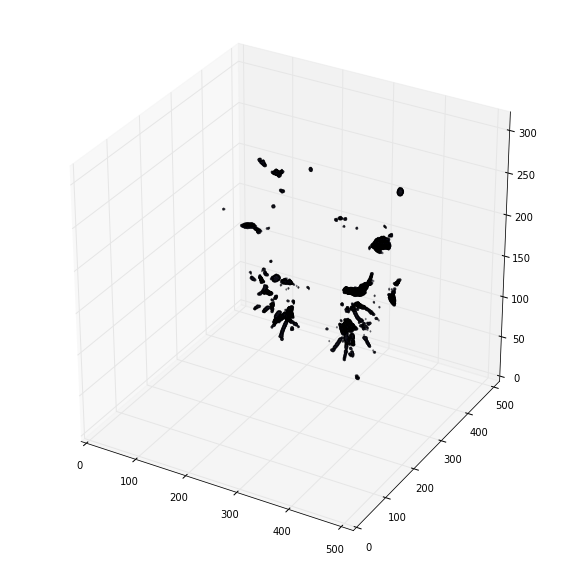

NotImplementedError: Only for images of dimension 1-3 are supported, got a 4D one

In [25]:
ll = unet_sgm.transpose(3,0,1,2)
ll = ll[0]
ll[ll > 0.9] = 1
ll[ll <= 0.9] = 0
print ll.shape
plot_3d(ll, 0)
orig_cubes, segment_cubes, labels, center = seperate_nodule(img_array, delt_scan, unet_sgm, nodules)

In [36]:
orig_cubes, segment_cubes, labels, center = seperate_nodule(img_array, delt_scan, unet_sgm, nodules)

[0, 0, 0, 0, 0]
186
[ 134.  397.  133.] (8.0, 198.0, 230.0)
64886.0
[ 235.  350.   58.] (8.0, 198.0, 230.0)
104217.0
[ 381.  401.   75.] (8.0, 198.0, 230.0)
204363.0
[ 342.  353.  119.] (8.0, 198.0, 230.0)
147902.0
[ 128.  384.   63.] (8.0, 198.0, 230.0)
76885.0
80
[ 134.  397.  133.] (7.0, 183.0, 275.0)
82089.0
[ 235.  350.   58.] (7.0, 183.0, 275.0)
126962.0
[ 381.  401.   75.] (7.0, 183.0, 275.0)
227400.0
[ 342.  353.  119.] (7.0, 183.0, 275.0)
165461.0
[ 128.  384.   63.] (7.0, 183.0, 275.0)
99986.0
444
[ 134.  397.  133.] (15.0, 197.0, 258.0)
69786.0
[ 235.  350.   58.] (15.0, 197.0, 258.0)
111809.0
[ 381.  401.   75.] (15.0, 197.0, 258.0)
209061.0
[ 342.  353.  119.] (15.0, 197.0, 258.0)
150586.0
[ 128.  384.   63.] (15.0, 197.0, 258.0)
85763.0
50
[ 134.  397.  133.] (28.0, 182.0, 277.0)
78197.0
[ 235.  350.   58.] (28.0, 182.0, 277.0)
119034.0
[ 381.  401.   75.] (28.0, 182.0, 277.0)
213374.0
[ 342.  353.  119.] (28.0, 182.0, 277.0)
152801.0
[ 128.  384.   63.] (28.0, 182.0, 277

# LOOK AT THE PICS

In [20]:
def read_data(prefix):
    data_list = glob(prefix + "origin/*")[300:400]
    lb_list = glob(prefix + 'labels/*')[300:400]
    data_list.sort()
    lb_list.sort()

    print 'files=', len(data_list)
#    print lb_list[:200]

    cnt = [0,0]
    all_data = []
    all_lb = []

    for idx, nm in enumerate (data_list):
        ndls = np.load(nm)
        lbs = np.load(lb_list[idx])

        for jdx, ndl in enumerate (ndls):
            all_data.append(ndl)
            all_lb.append(lbs[jdx])
	    cnt[lbs[jdx]] += 1
	    if lbs[jdx] == 1:
                all_data.append(ndl.transpose([0,2,1]))
                all_data.append(ndl.transpose([2,1,0]))
                all_data.append(ndl.transpose([1,2,0]))
                all_data.append(ndl.transpose([1,2,0]))
                all_data.append(ndl.transpose([2,0,1]))
                all_lb.append(1)
                all_lb.append(1)
                all_lb.append(1)
                all_lb.append(1)
                all_lb.append(1)
                all_lb.append(1)
	        cnt[lbs[jdx]] += 6
		

    nn = len(all_data)    
    all_data = np.array([all_data]).transpose((1,2,3,4,0))
    #all_lb = to_categorical(np.array(all_lb), 2)
    all_lb = np.array(all_lb)
    print 'false/true: ', cnt
    return all_data[:nn*3/4], all_lb[:nn*3/4],all_data[nn*3/4:],all_lb[nn*3/4:]

prefix = '/media/izm/Entertain/fjj/classify/'
train_data, train_lb, test_data, test_lb = read_data(prefix)



files= 100
false/true:  [2105, 364]


(49, 49, 49)
132 -1000


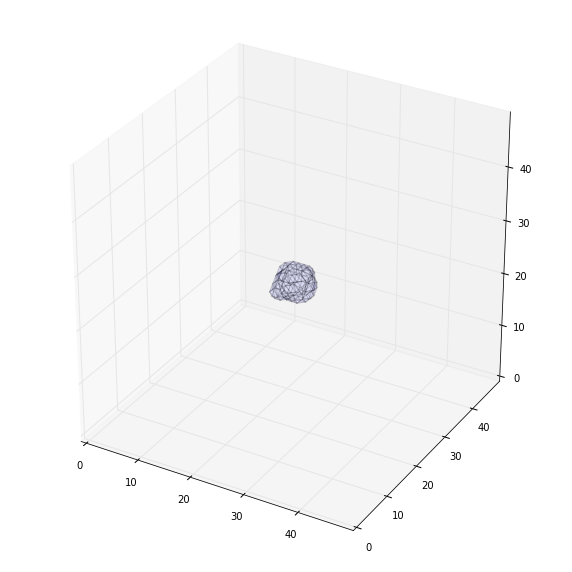

(49, 49, 49)
132 -1000


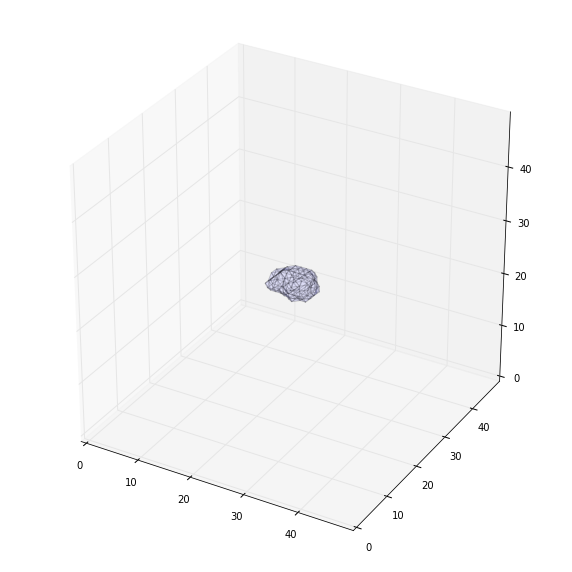

(49, 49, 49)
132 -1000


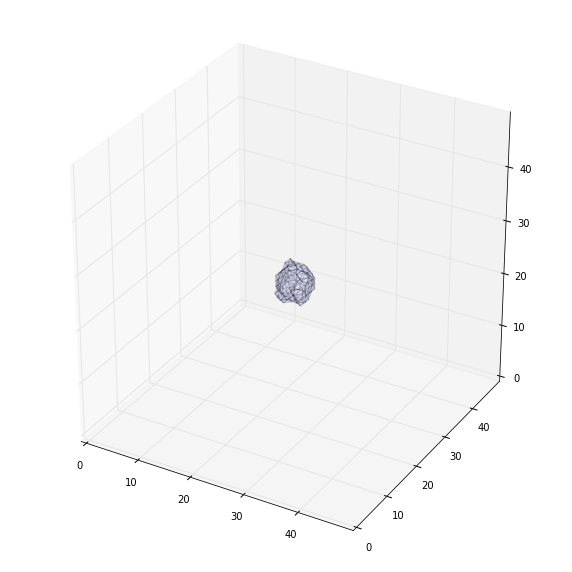

(49, 49, 49)
132 -1000


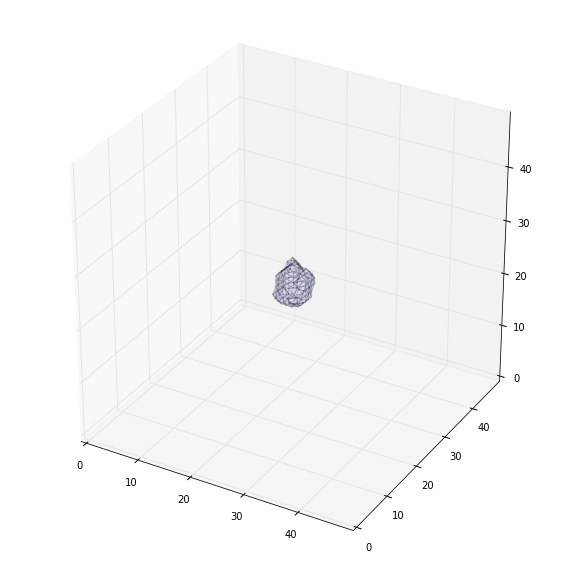

(49, 49, 49)
132 -1000


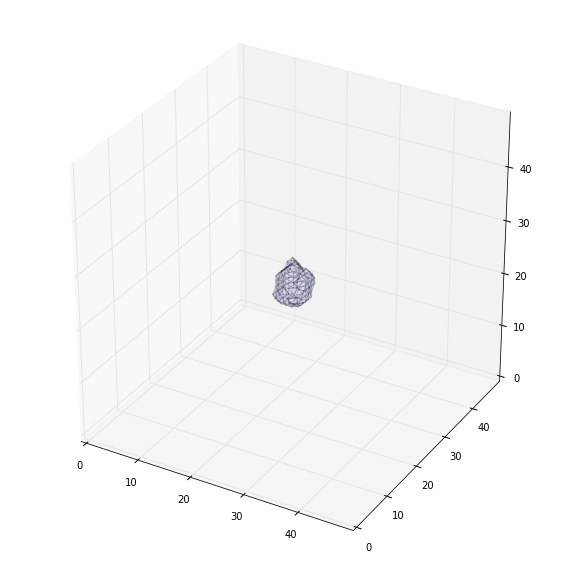

(49, 49, 49)
132 -1000


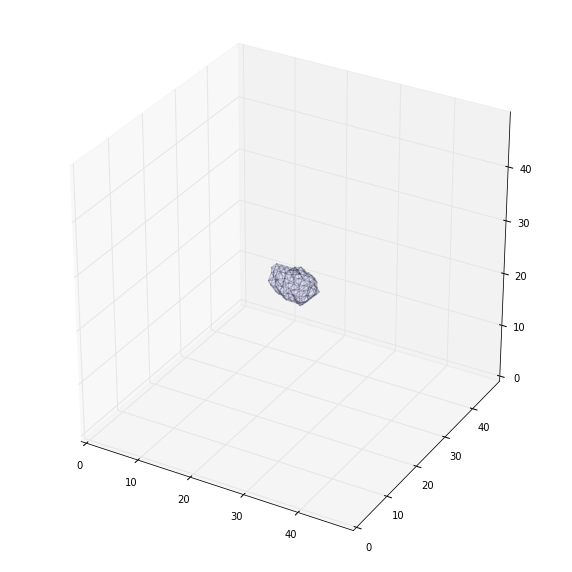

(49, 49, 49)
-128 -1000


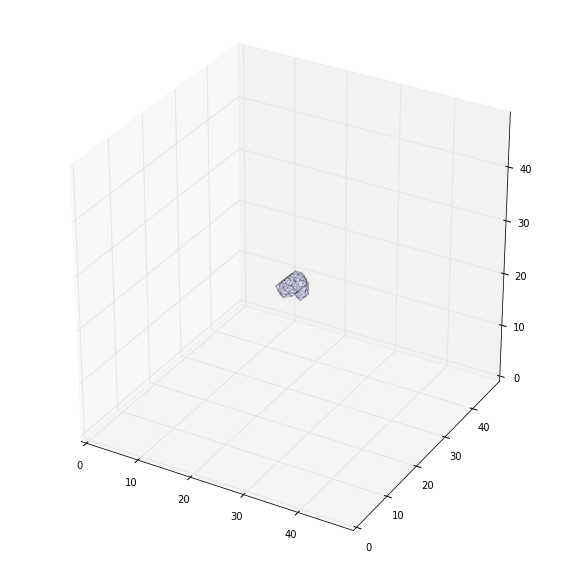

(49, 49, 49)
72 -1000


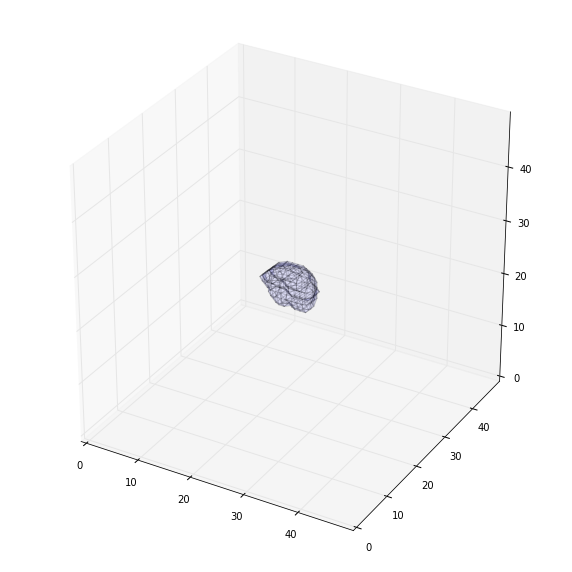

(49, 49, 49)
72 -1000


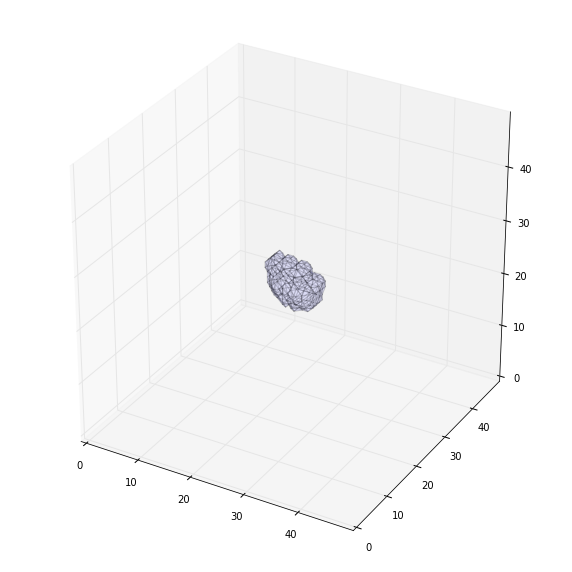

(49, 49, 49)
72 -1000


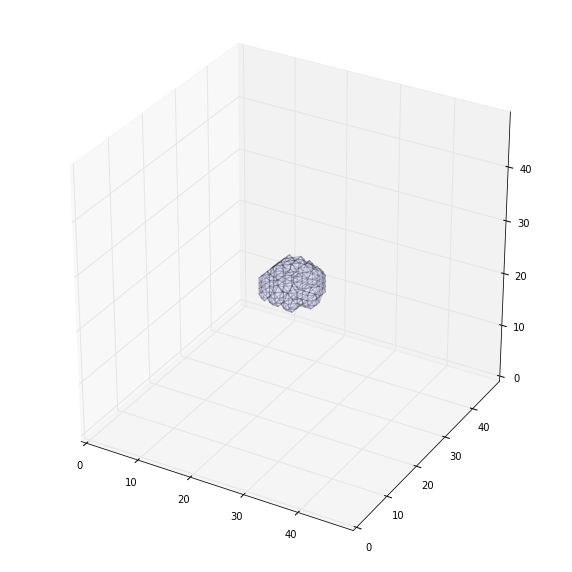

(49, 49, 49)
72 -1000


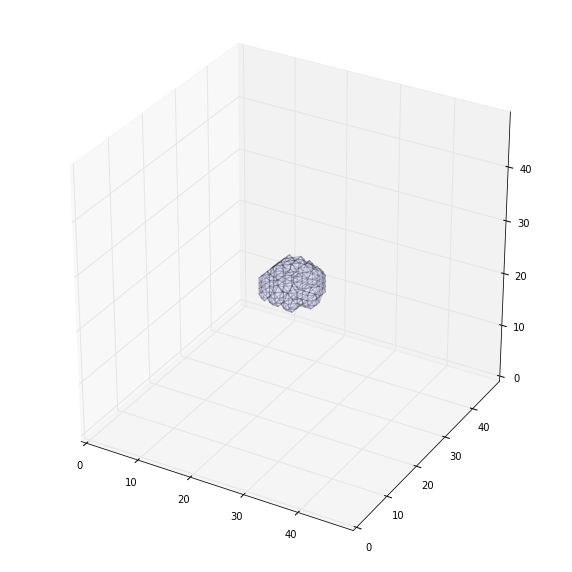

(49, 49, 49)
72 -1000


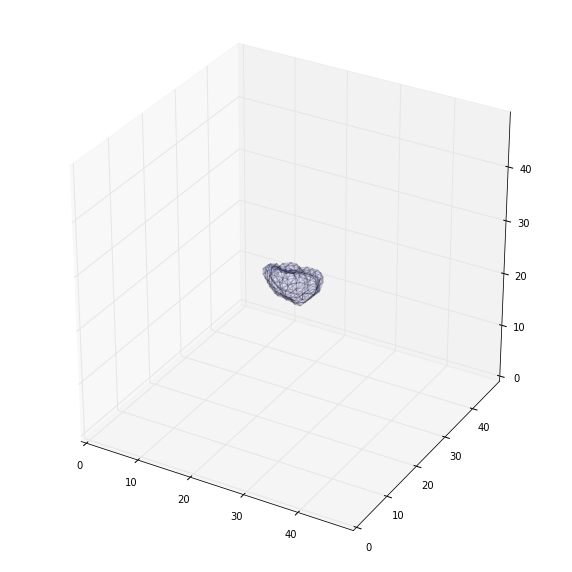

(49, 49, 49)
12 -1000


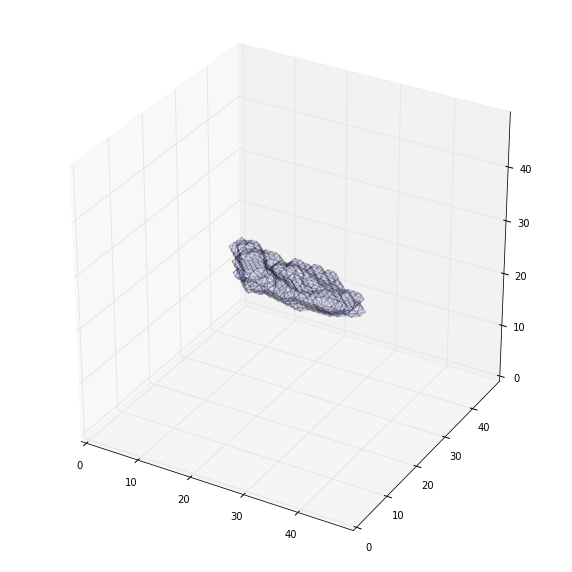

(49, 49, 49)
94 -1000


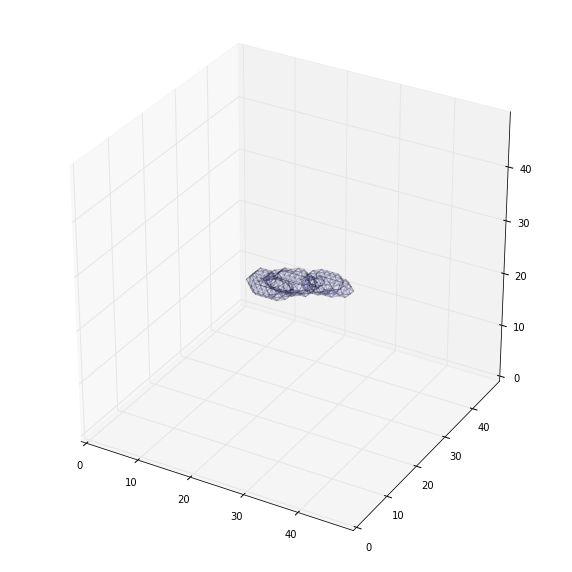

(49, 49, 49)
90 -1000


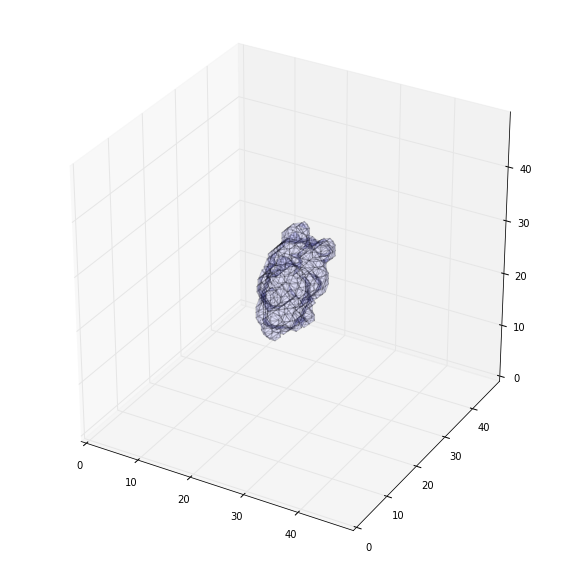

(49, 49, 49)
90 -1000


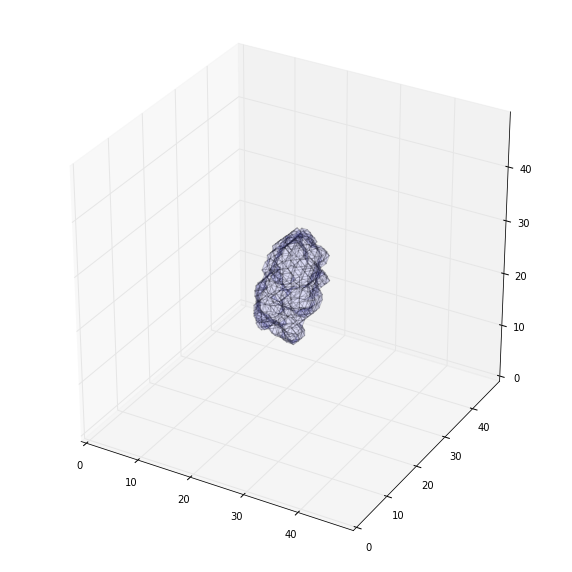

(49, 49, 49)
90 -1000


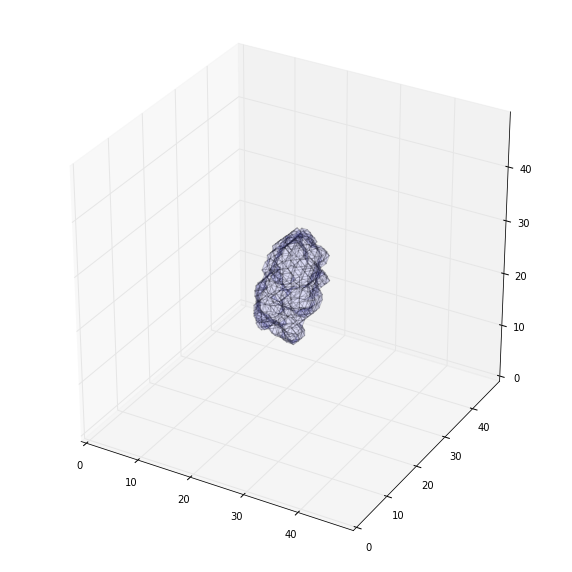

(49, 49, 49)
90 -1000


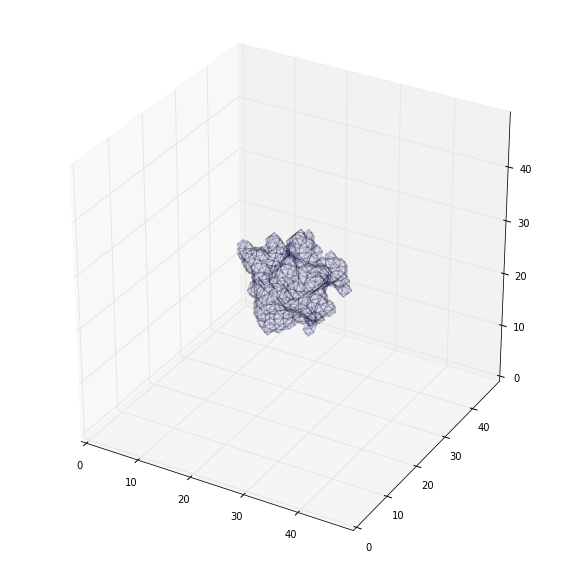

(49, 49, 49)
148 -1000


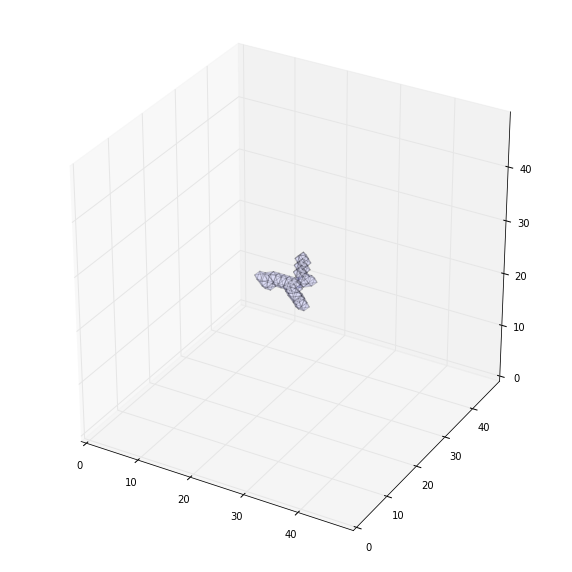

(49, 49, 49)
-1000 -1000
(49, 49, 49)
421 -1000


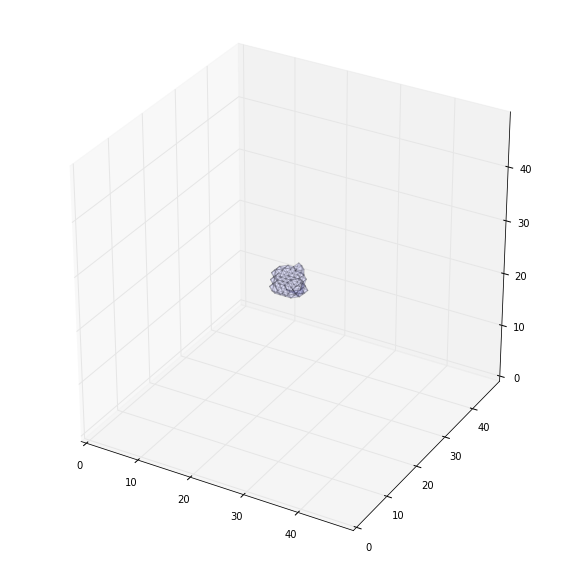

(49, 49, 49)
1840 -1000


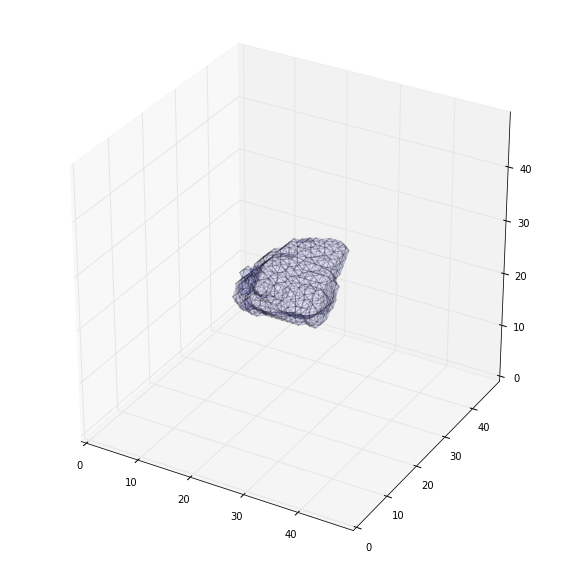

(49, 49, 49)
1840 -1000


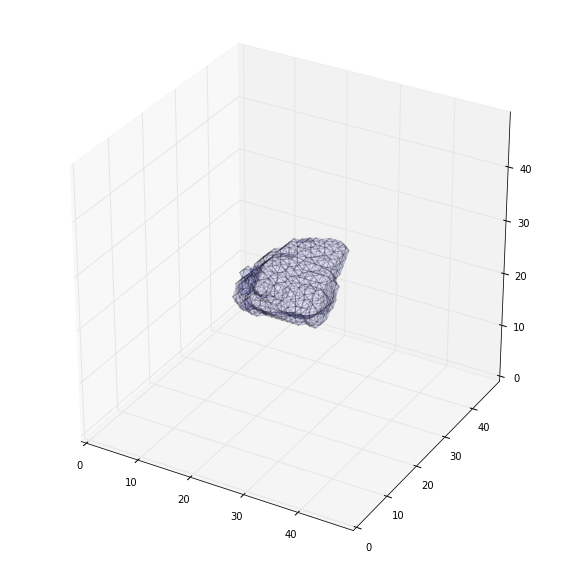

(49, 49, 49)
1840 -1000


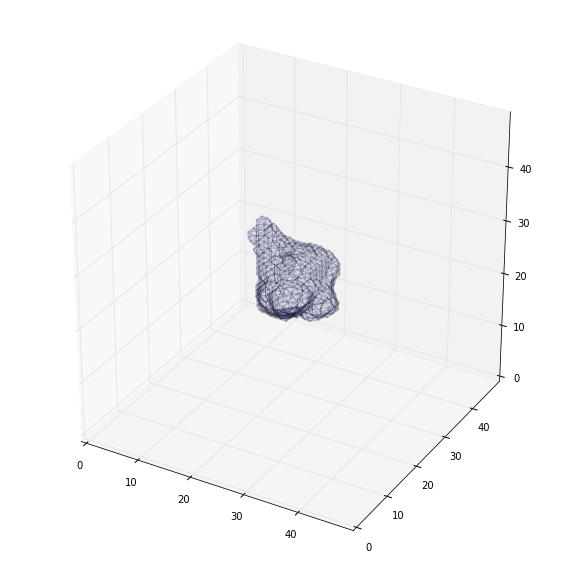

(49, 49, 49)
-197 -1000


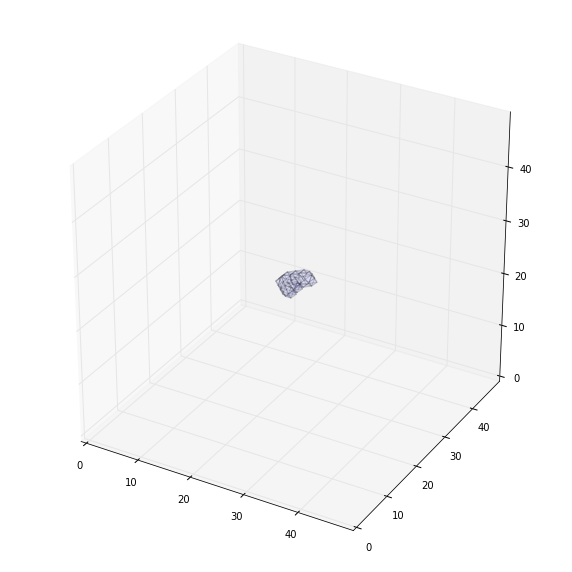

(49, 49, 49)
-74 -1000


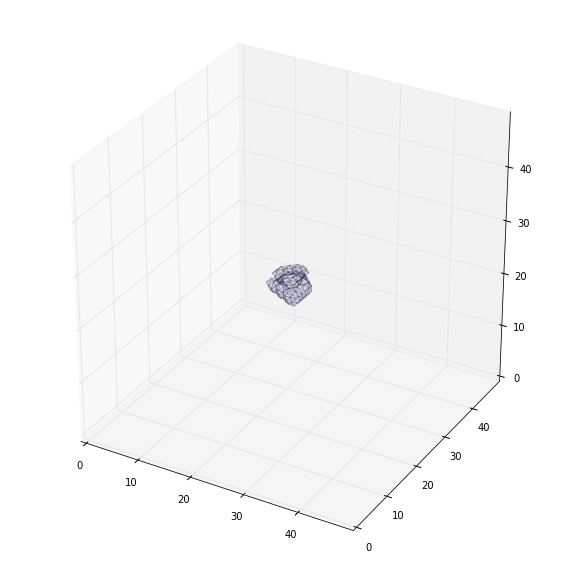

(49, 49, 49)
70 -1000


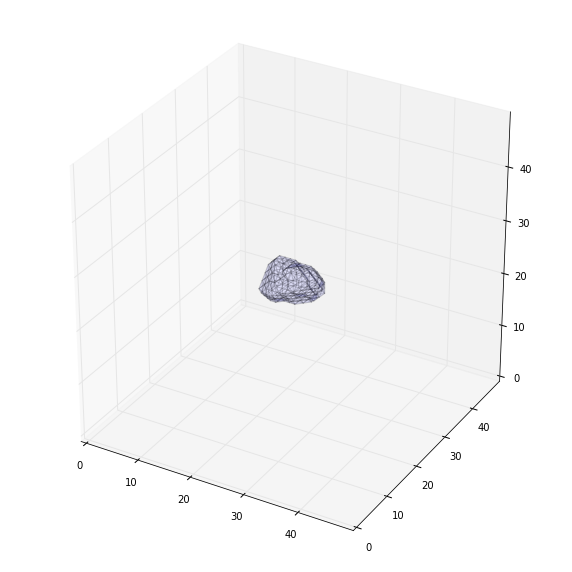

(49, 49, 49)
70 -1000


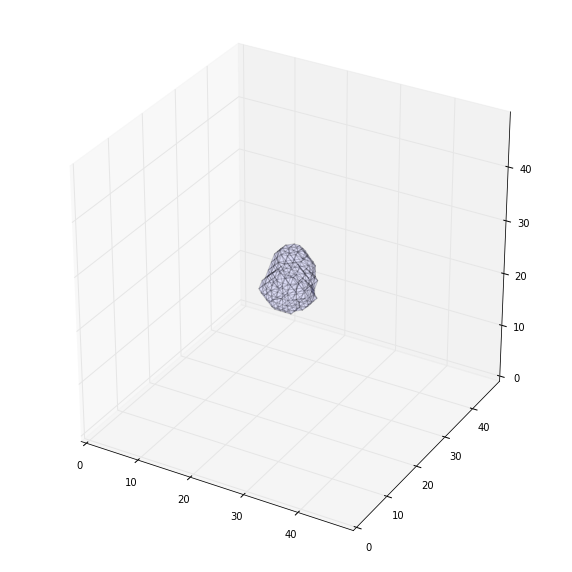

(49, 49, 49)
70 -1000


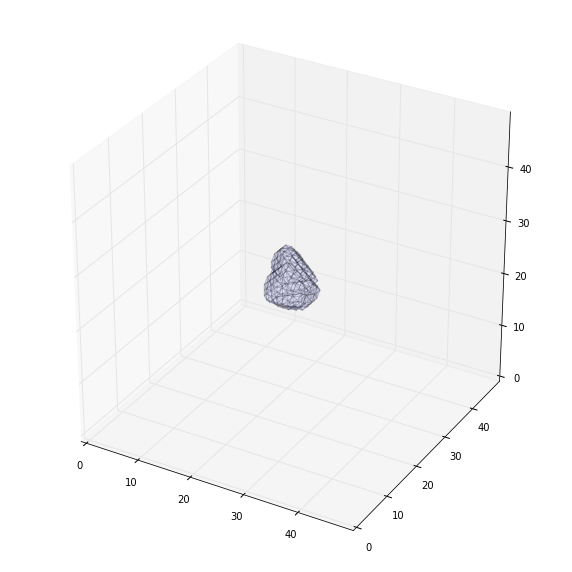

(49, 49, 49)
70 -1000


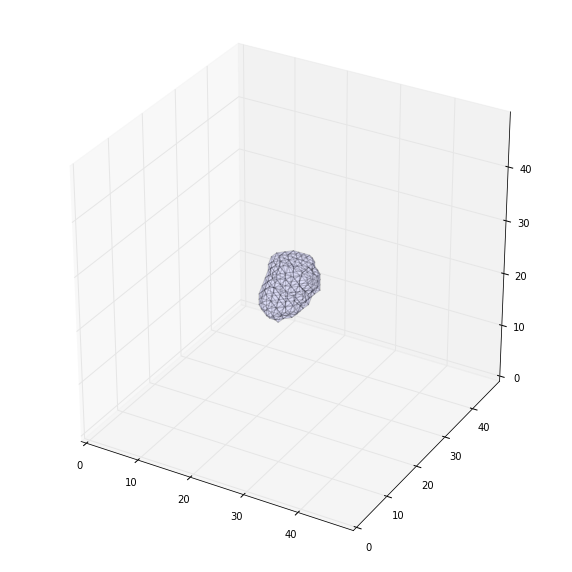

(49, 49, 49)
44 -1000


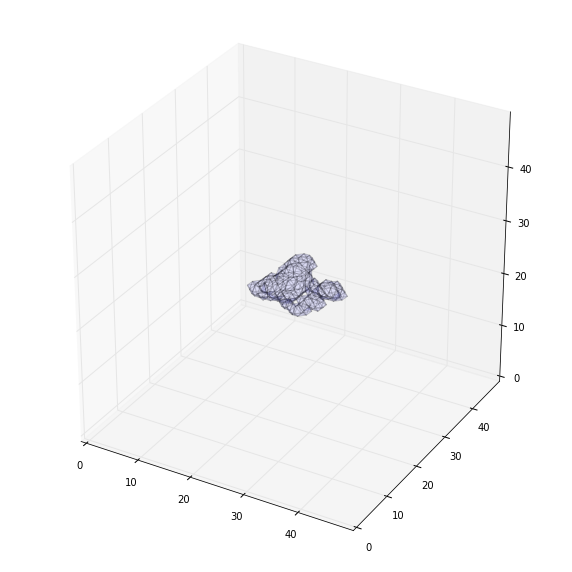

(49, 49, 49)
-233 -1000


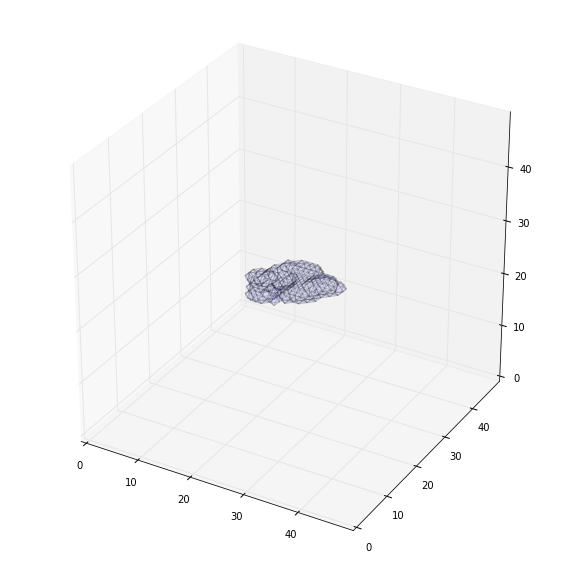

(49, 49, 49)
13 -1000


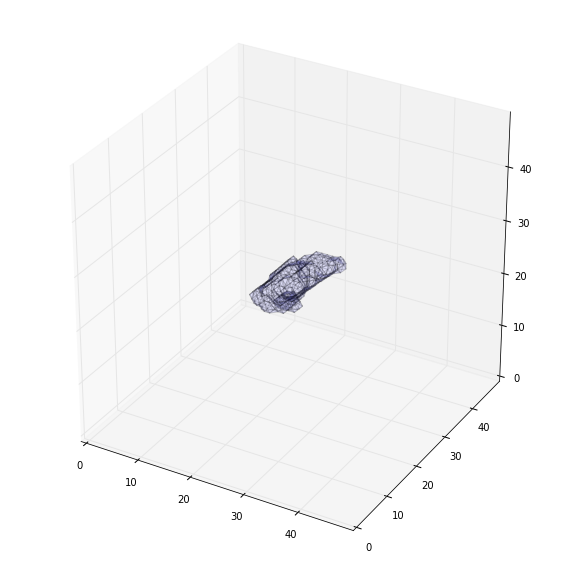

(49, 49, 49)
-48 -1000


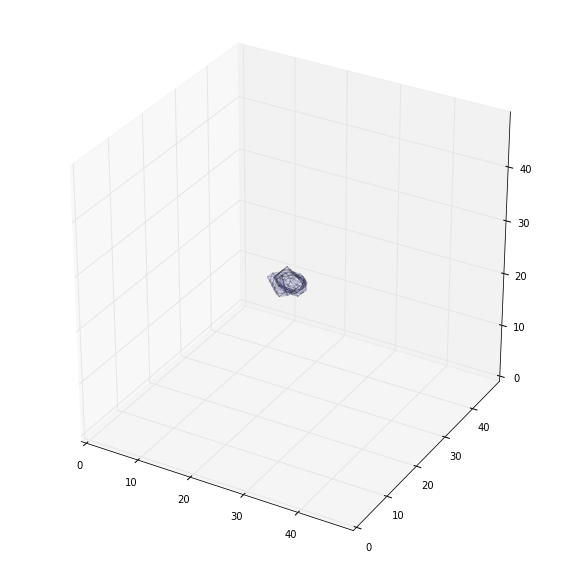

(49, 49, 49)
-171 -1000


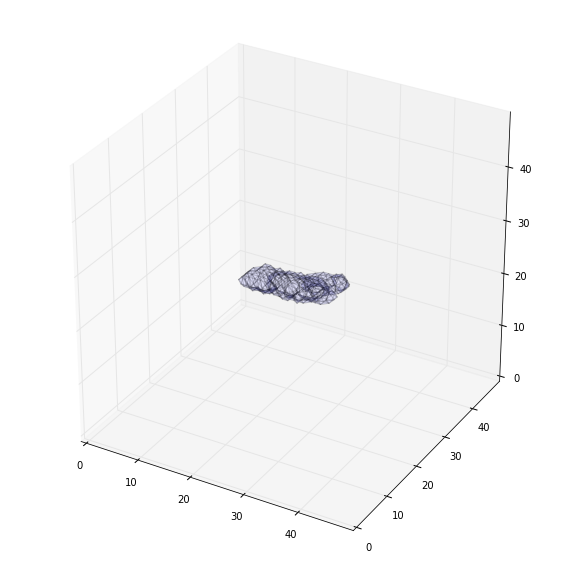

(49, 49, 49)
0 -1000


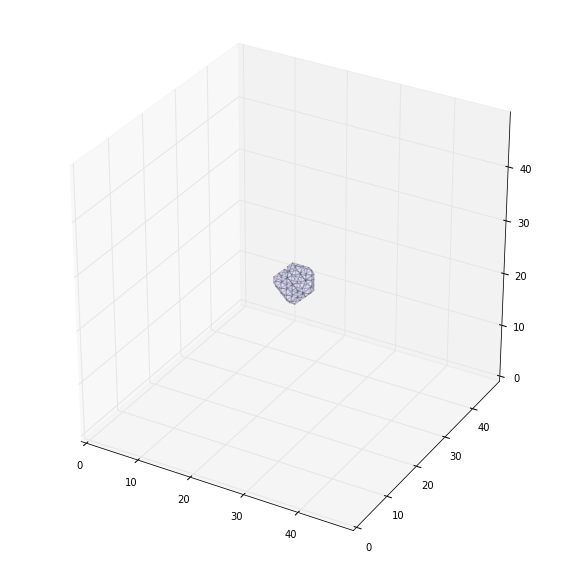

(49, 49, 49)
-44 -1000


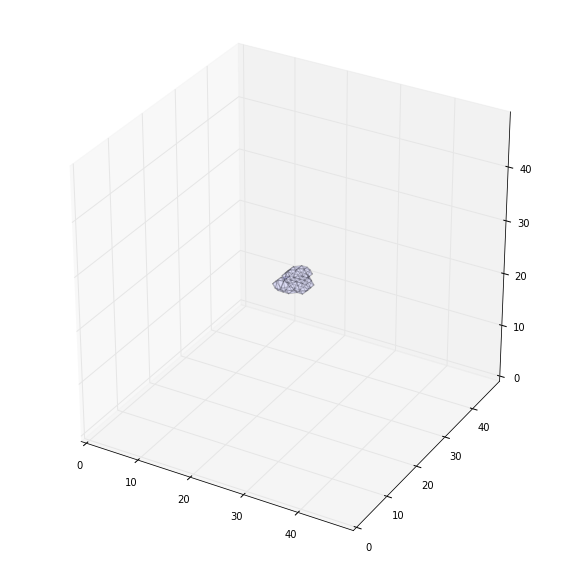

(49, 49, 49)
-6 -1000


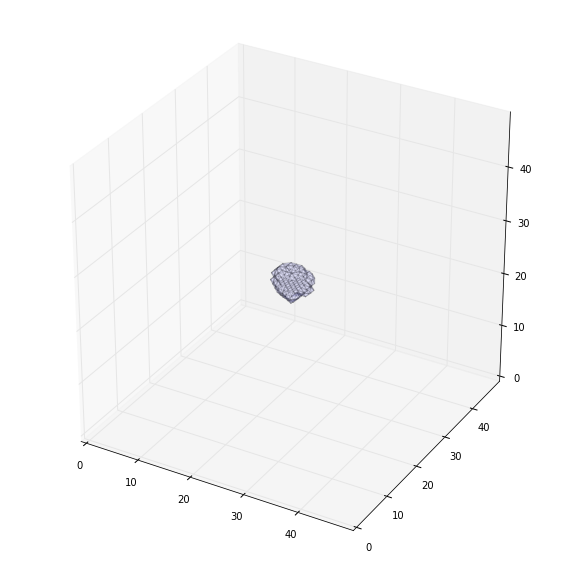

(49, 49, 49)
22 -1000


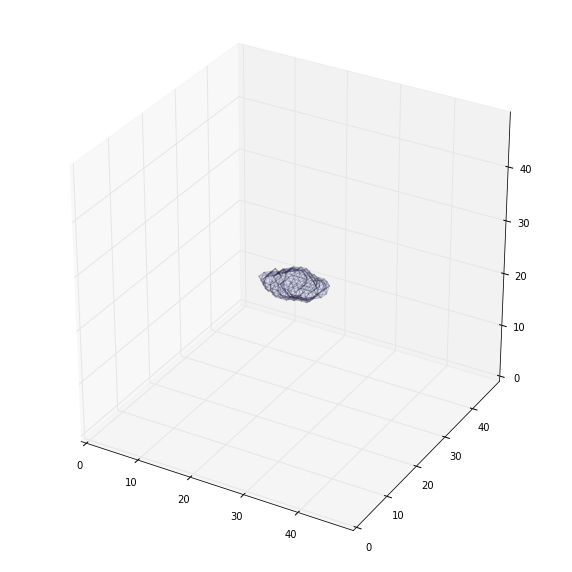

(49, 49, 49)
-221 -1000


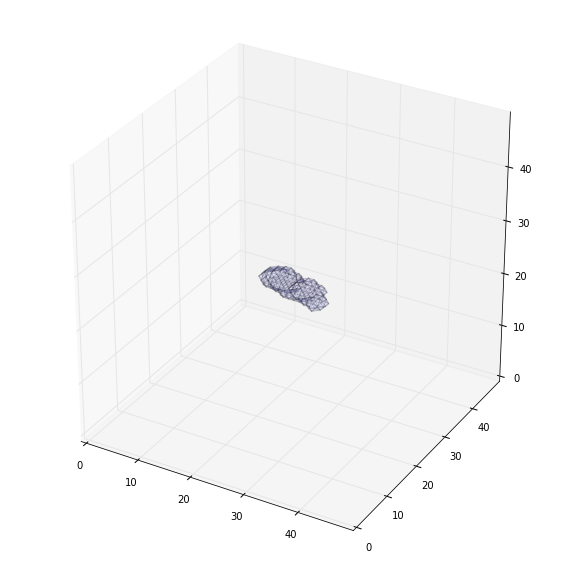

(49, 49, 49)
475 -1000


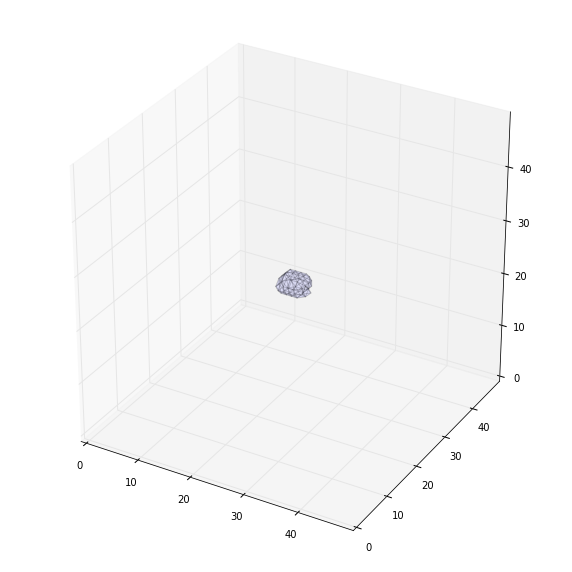

(49, 49, 49)
1588 -1000


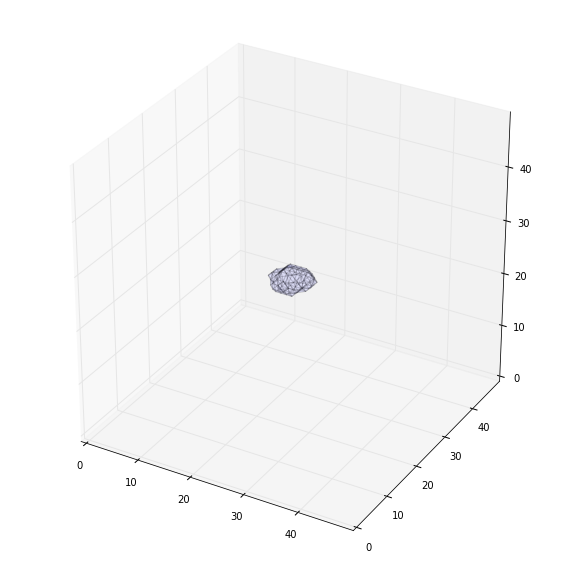

(49, 49, 49)
-48 -1000


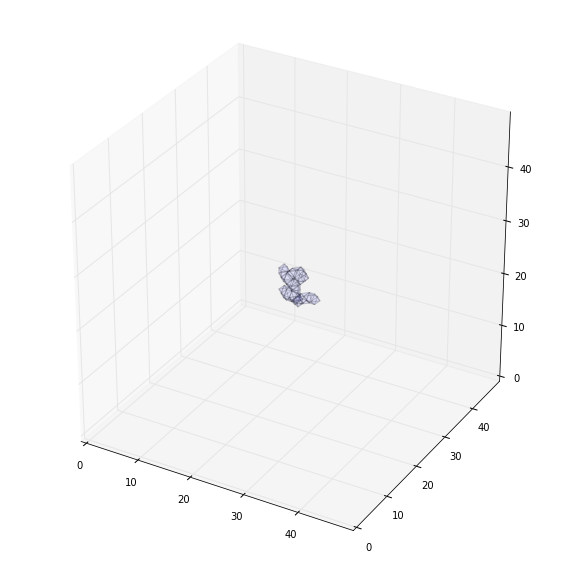

(49, 49, 49)
37 -1000


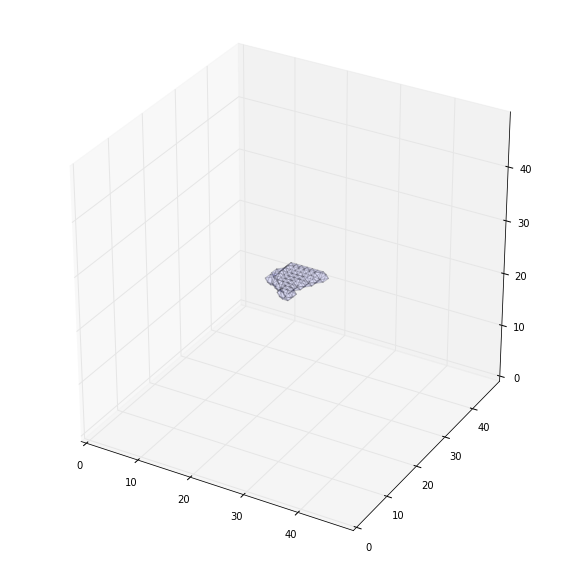

(49, 49, 49)
-136 -1000


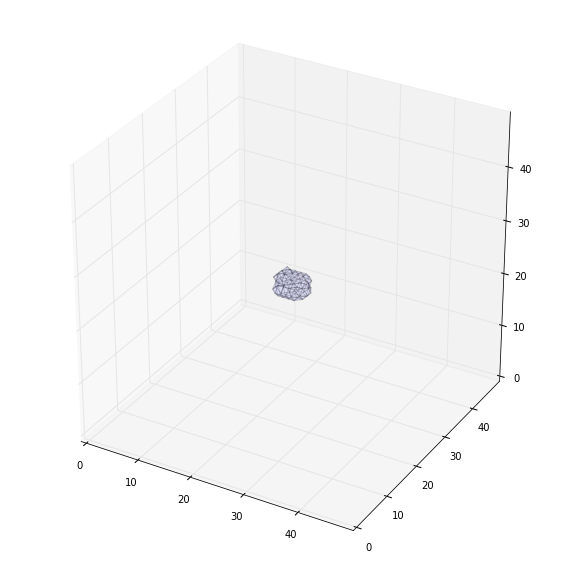

(49, 49, 49)
-123 -1000


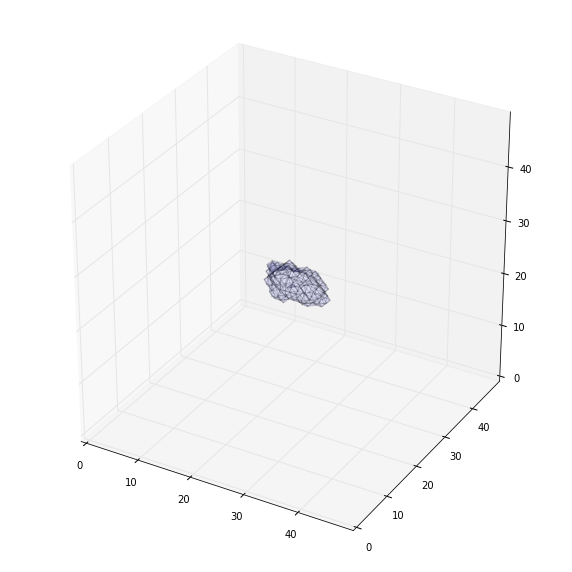

(49, 49, 49)
-75 -1000


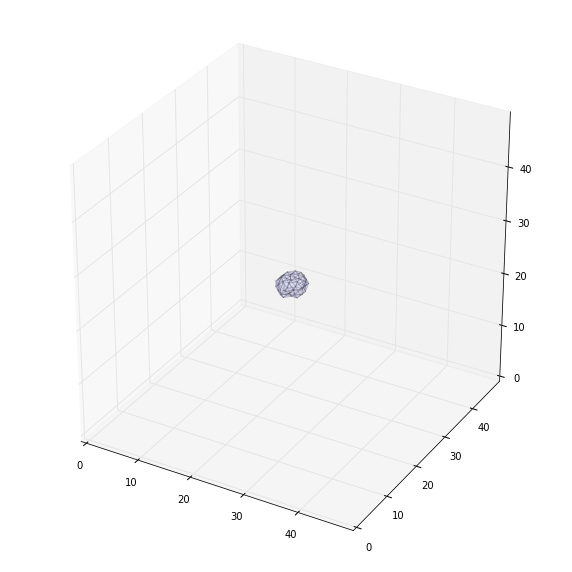

(49, 49, 49)
-75 -1000


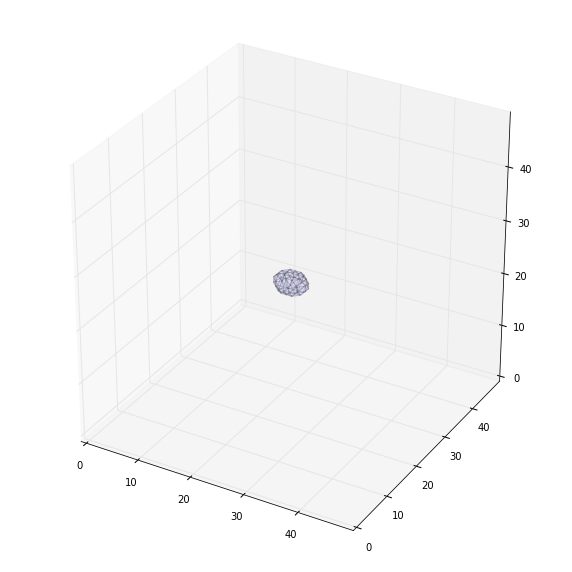

(49, 49, 49)
-75 -1000


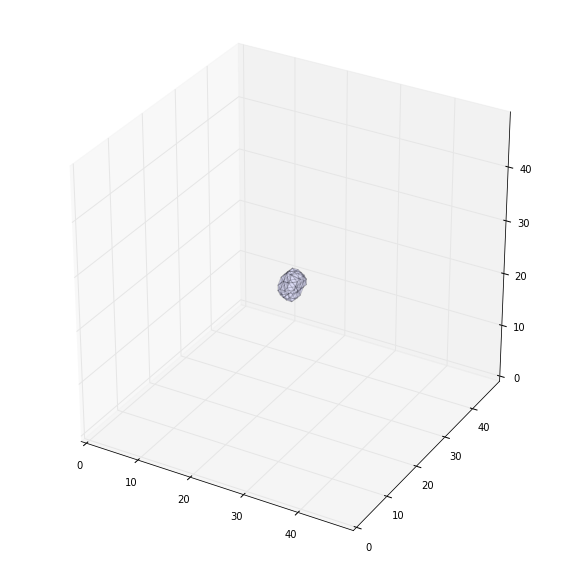

(49, 49, 49)
44 -1000


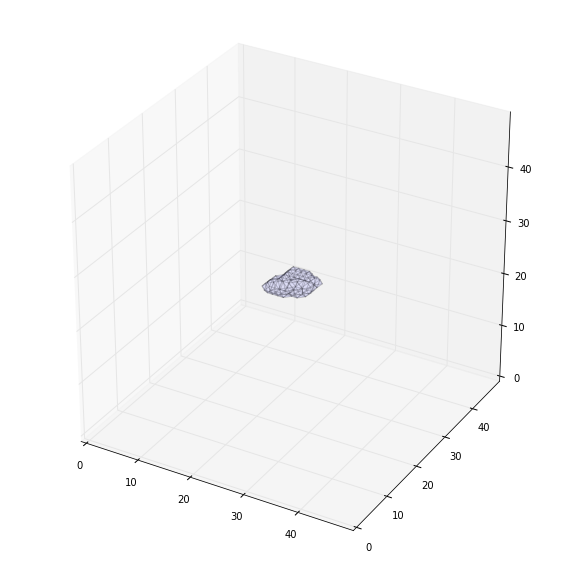

(49, 49, 49)
44 -1000


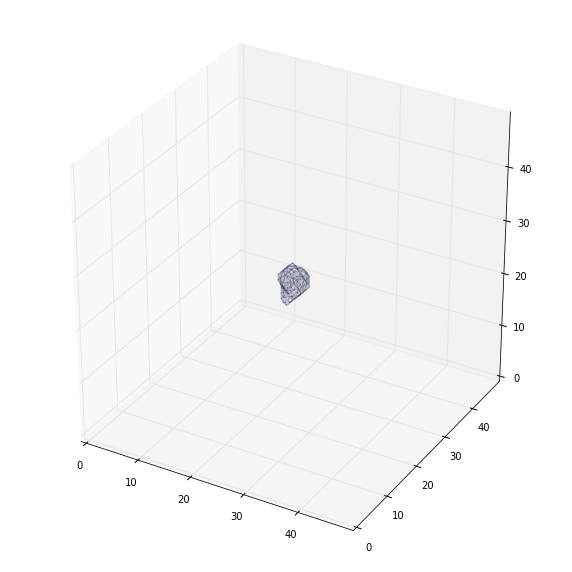

(49, 49, 49)
44 -1000


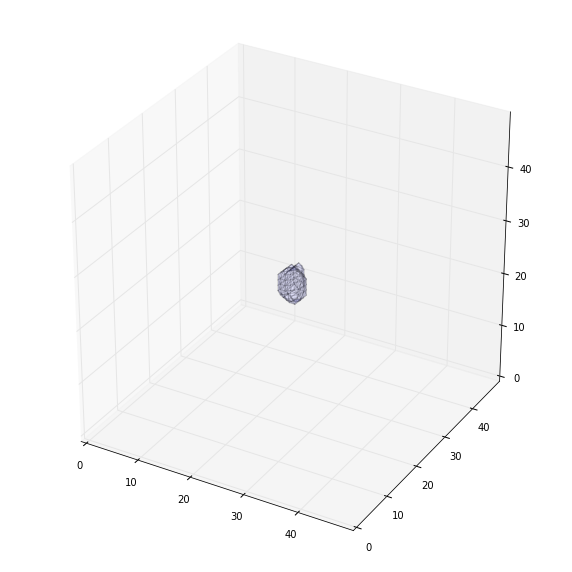

(49, 49, 49)
44 -1000


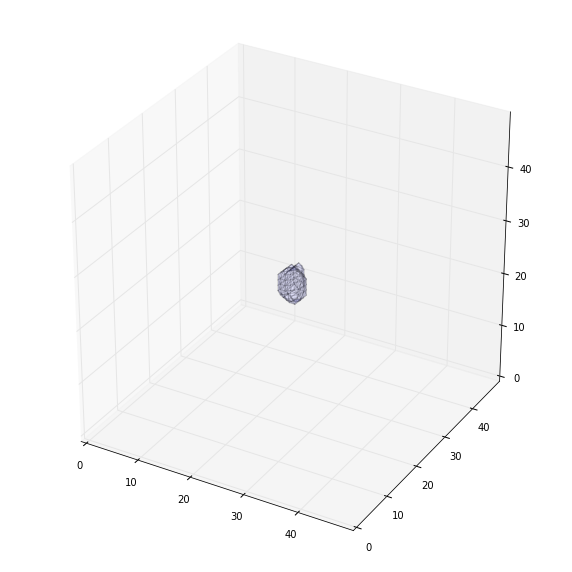

(49, 49, 49)
44 -1000


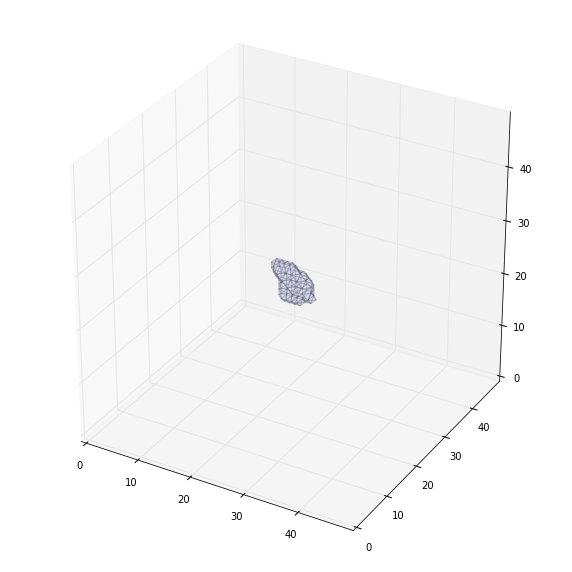

(49, 49, 49)
-144 -1000


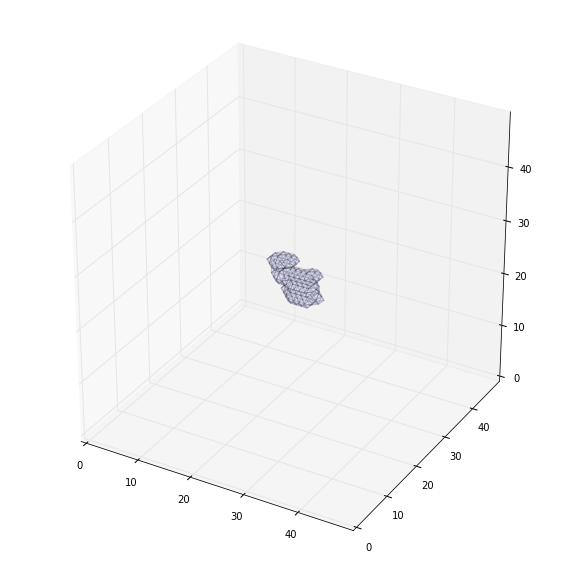

(49, 49, 49)
-207 -1000


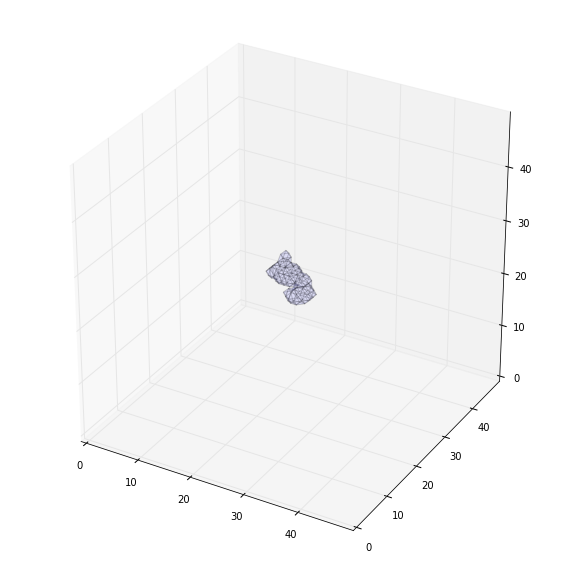

(49, 49, 49)
-86 -1000


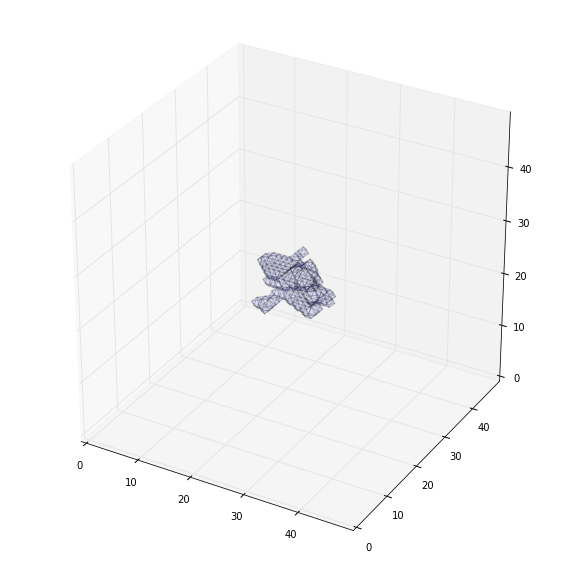

(49, 49, 49)
-1000 -1000
(49, 49, 49)
-80 -1000


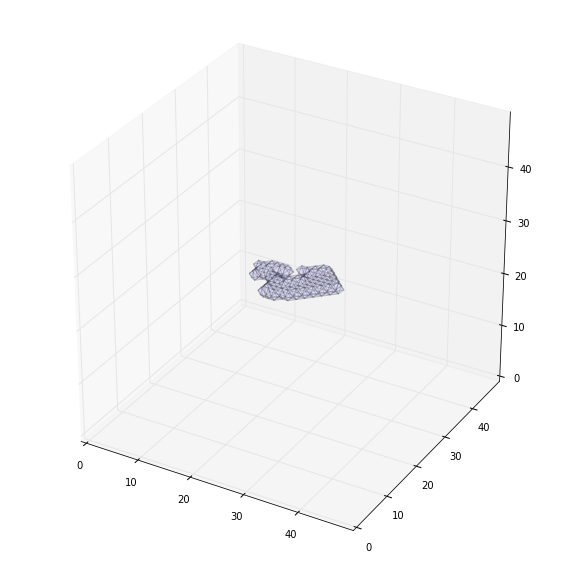

(49, 49, 49)
-182 -1000


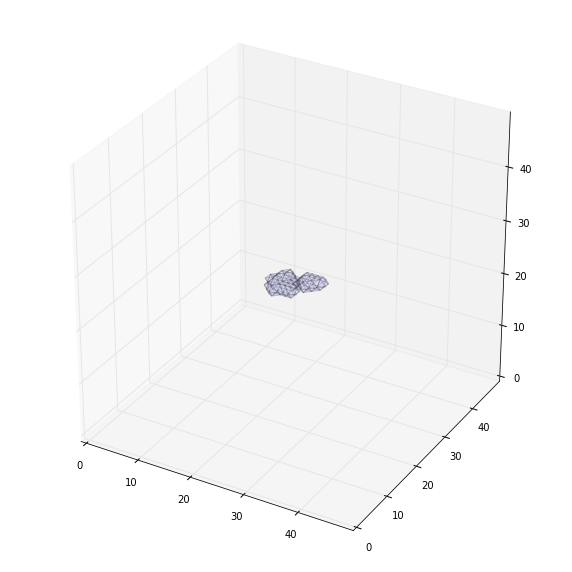

(49, 49, 49)
-133 -1000


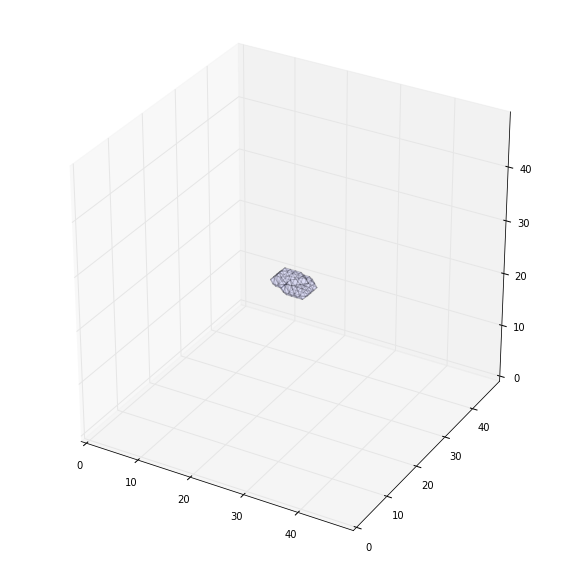

(49, 49, 49)
-59 -1000


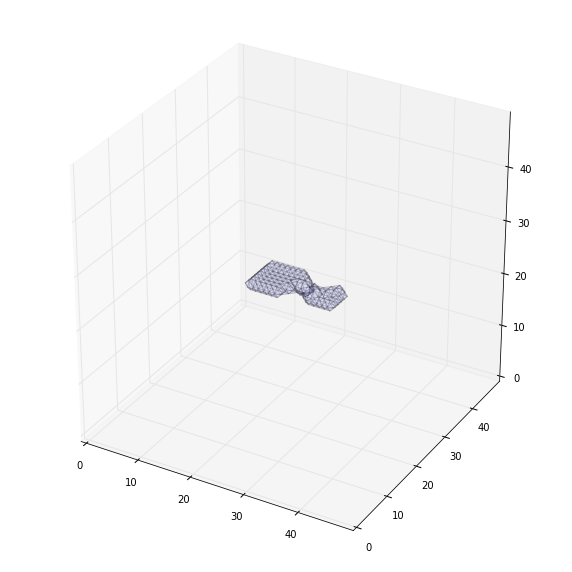

(49, 49, 49)
-163 -1000


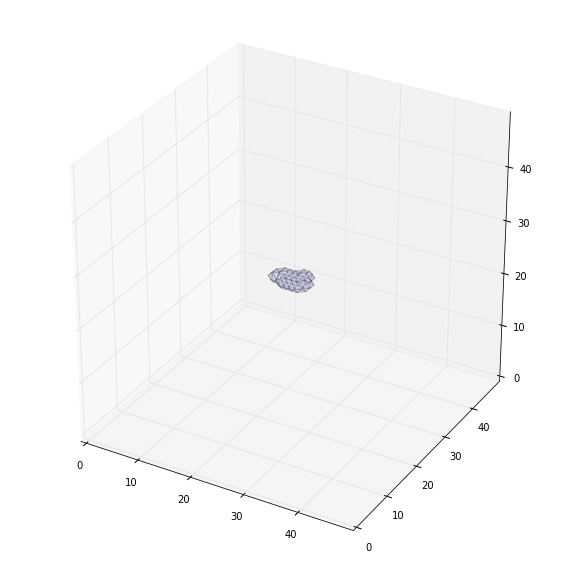

(49, 49, 49)
110 -1000


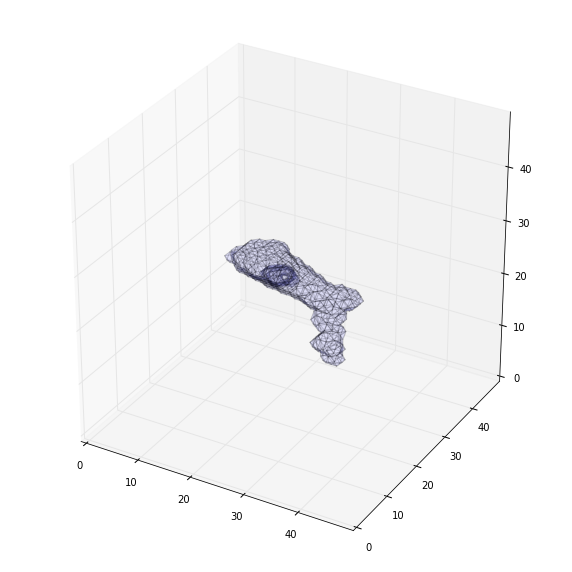

(49, 49, 49)
-1000 -1000
(49, 49, 49)
187 -1000


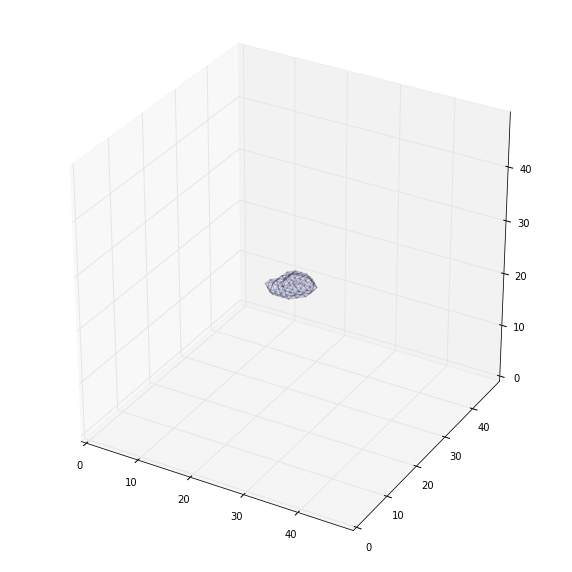

(49, 49, 49)
187 -1000


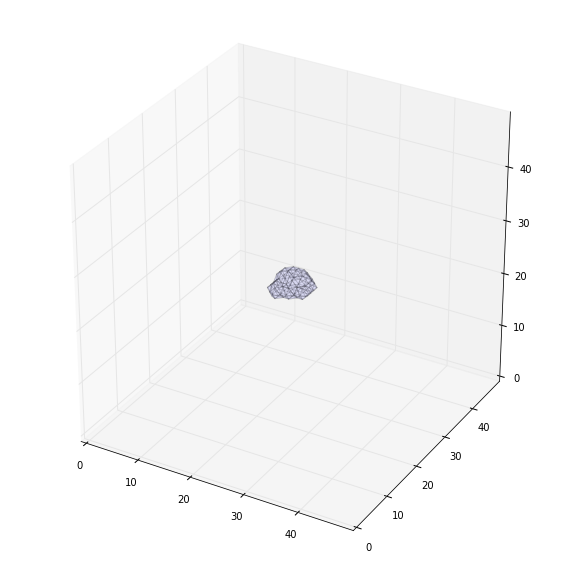

(49, 49, 49)
187 -1000


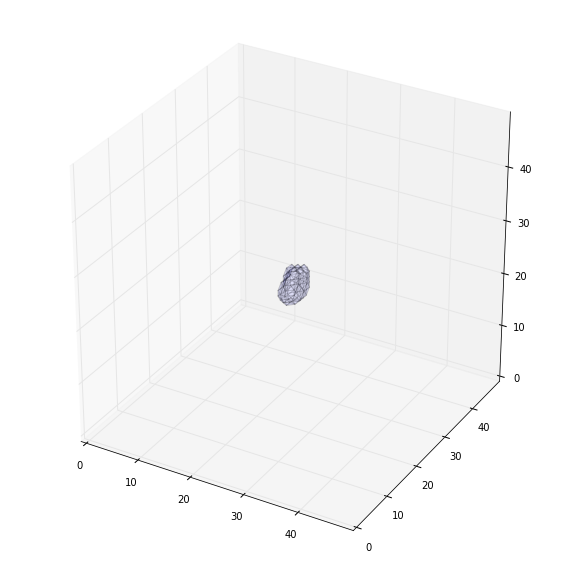

(49, 49, 49)
187 -1000


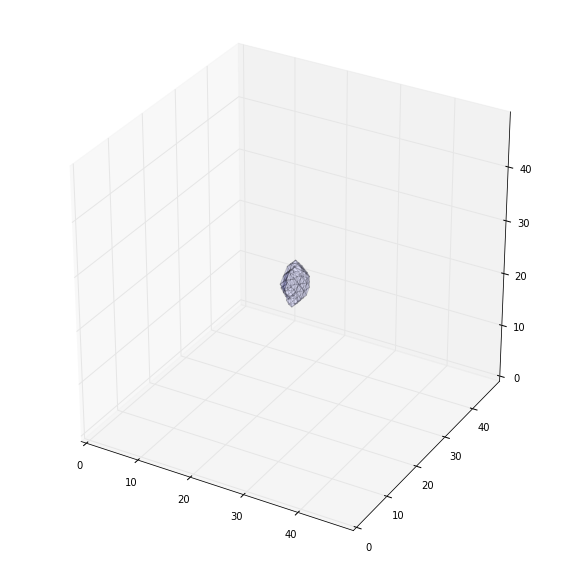

(49, 49, 49)
187 -1000


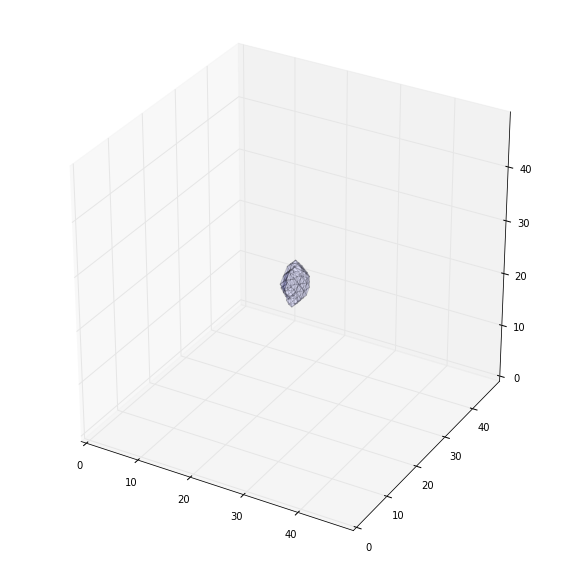

(49, 49, 49)
-159 -1000


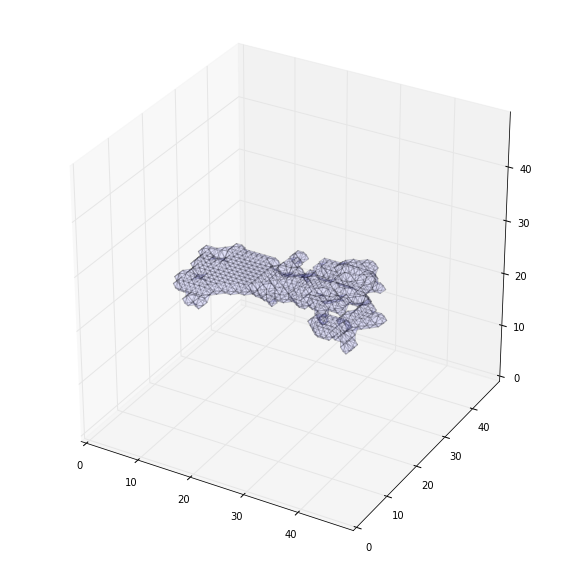

(49, 49, 49)
-240 -1000


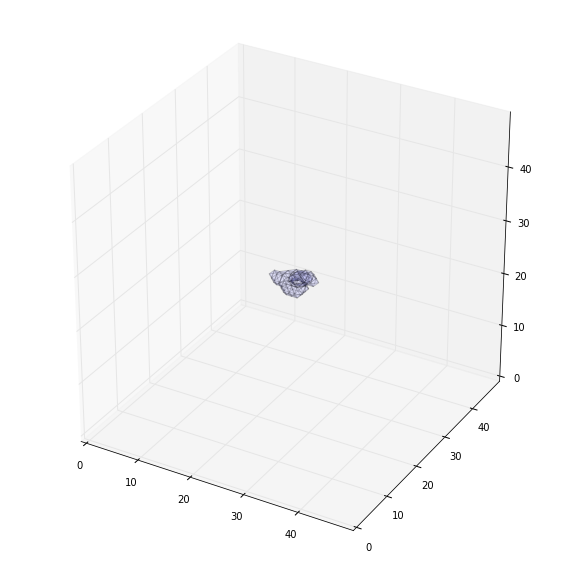

(49, 49, 49)
-122 -1000


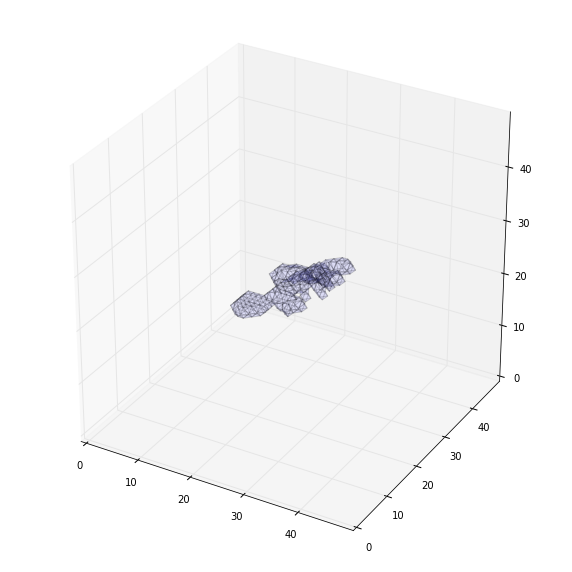

(49, 49, 49)
-156 -1000


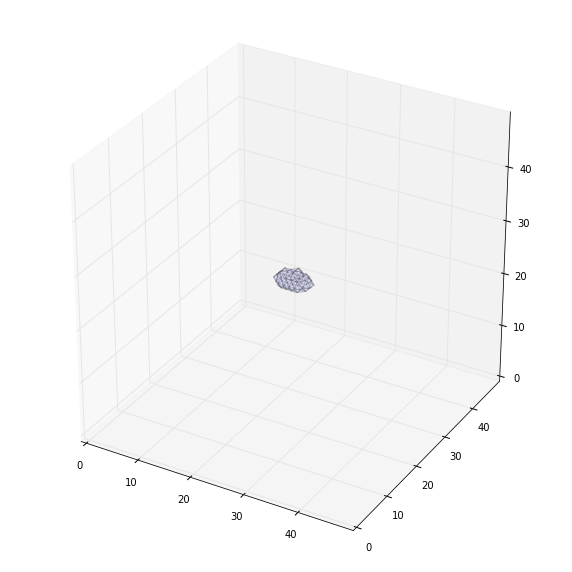

(49, 49, 49)
-1000 -1000
(49, 49, 49)
-1000 -1000
(49, 49, 49)
-302 -1000


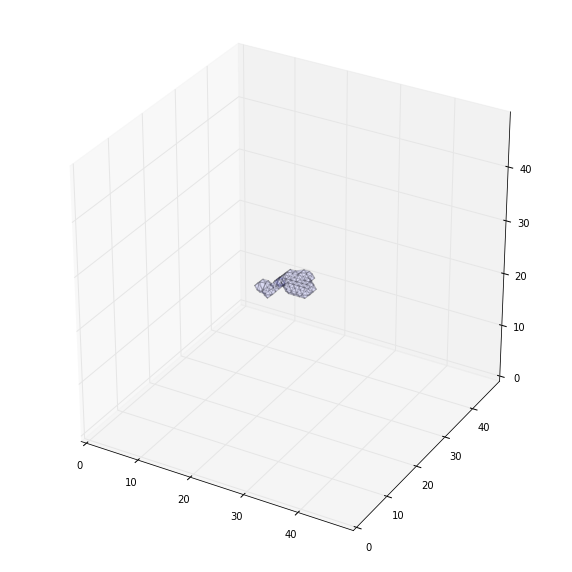

(49, 49, 49)
-153 -1000


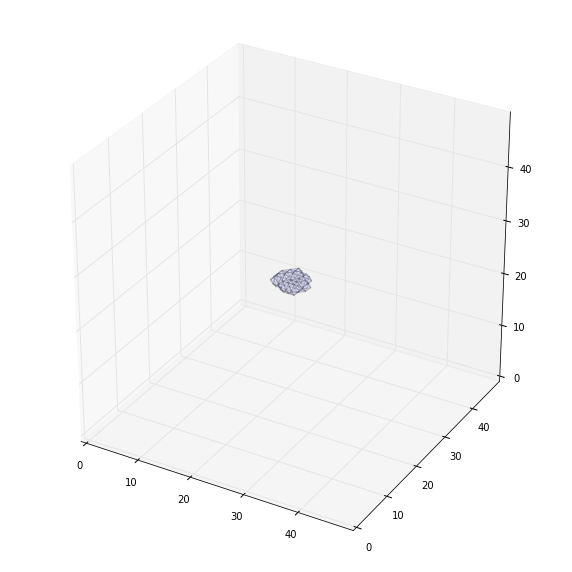

(49, 49, 49)
-232 -1000


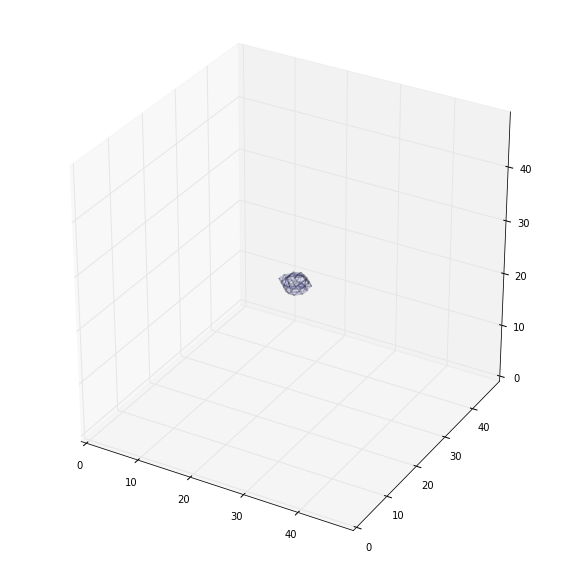

(49, 49, 49)
50 -1000


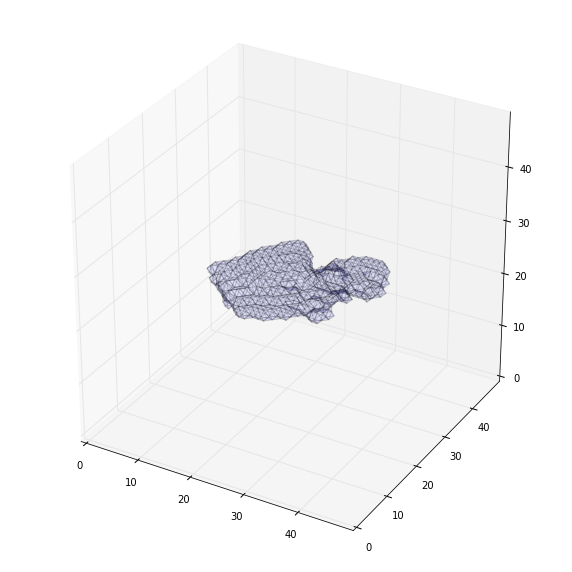

(49, 49, 49)
143 -1000


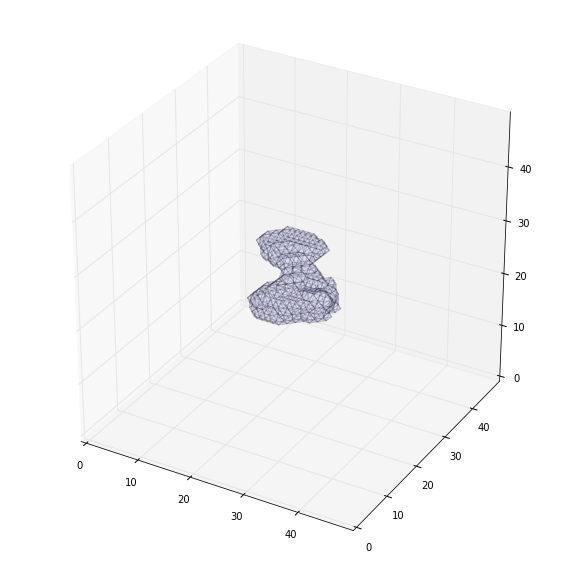

(49, 49, 49)
-49 -1000


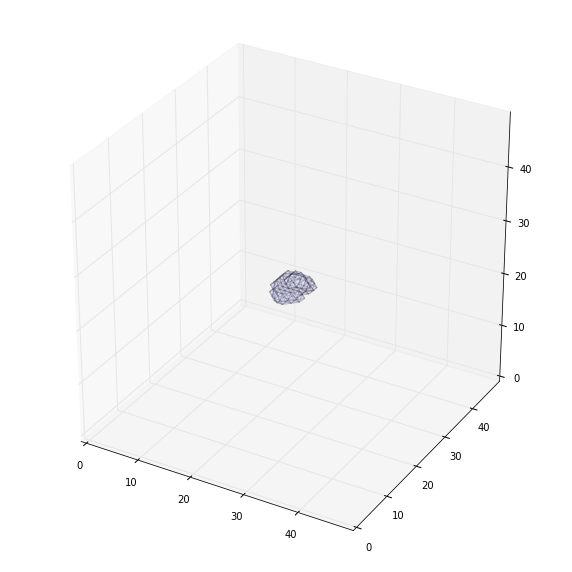

(49, 49, 49)
-171 -1000


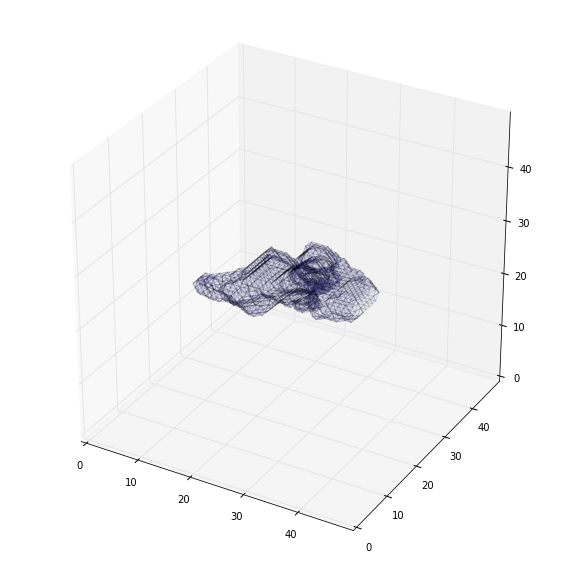

(49, 49, 49)
75 -1000


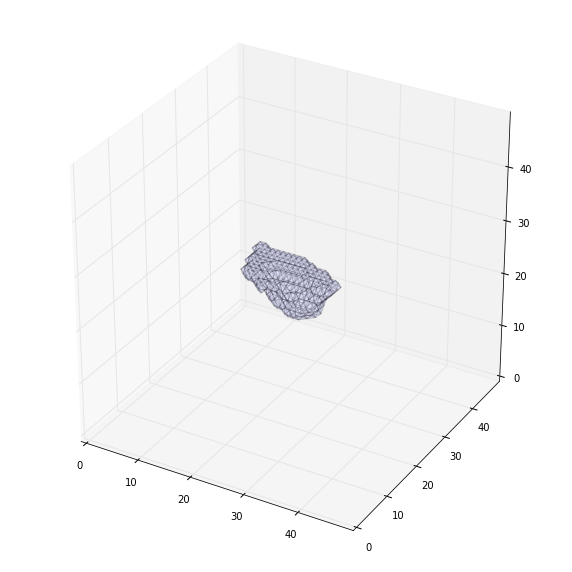

(49, 49, 49)
-307 -1000


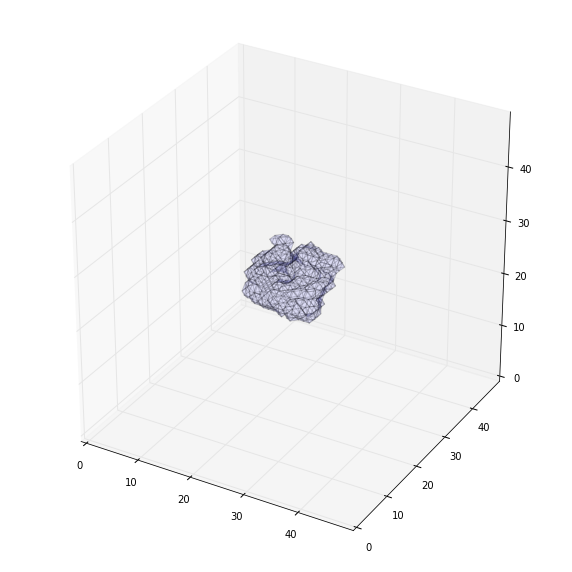

(49, 49, 49)
-1000 -1000
(49, 49, 49)
51 -1000


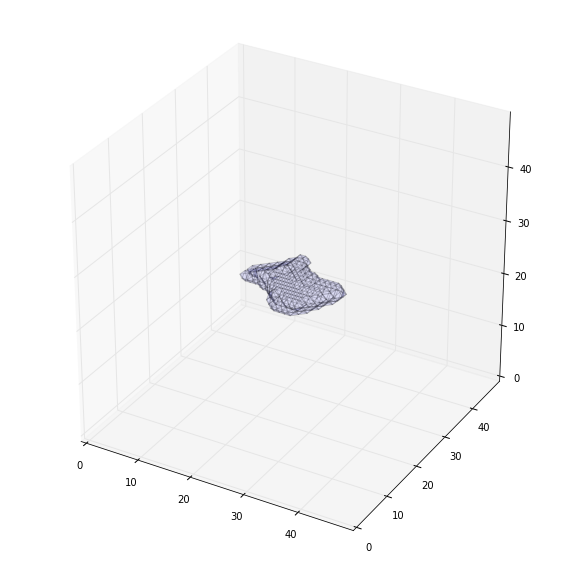

(49, 49, 49)
-1000 -1000
(49, 49, 49)
153 -1000


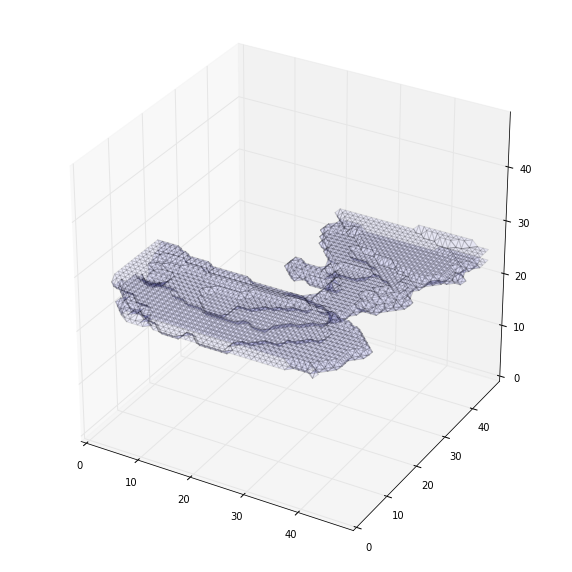

(49, 49, 49)
12 -1000


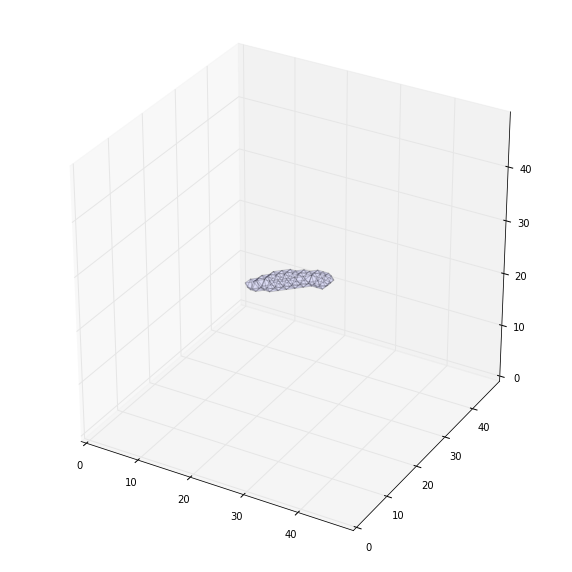

(49, 49, 49)
-262 -1000


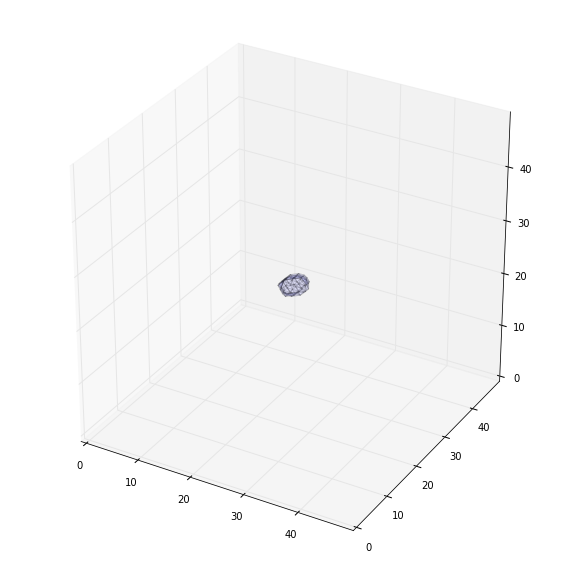

(49, 49, 49)
-239 -1000


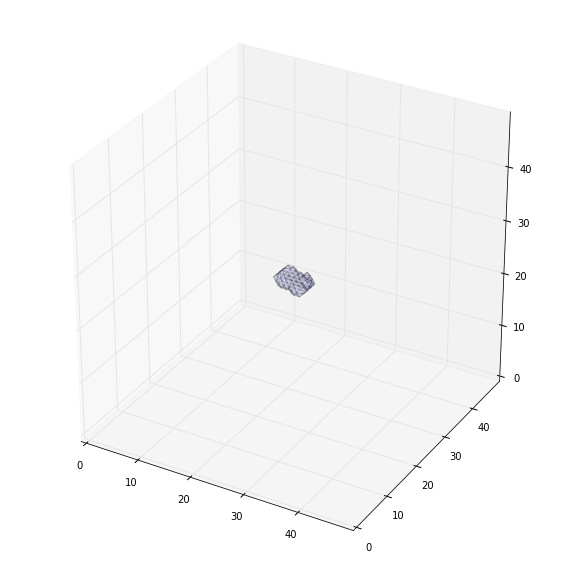

(49, 49, 49)
-255 -1000


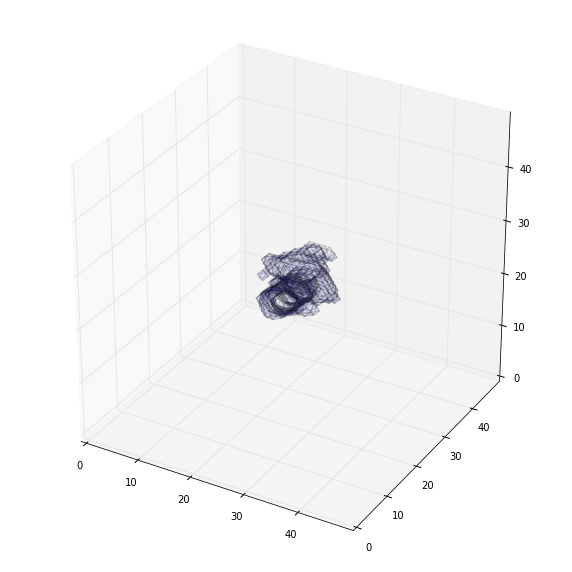

(49, 49, 49)
-292 -1000


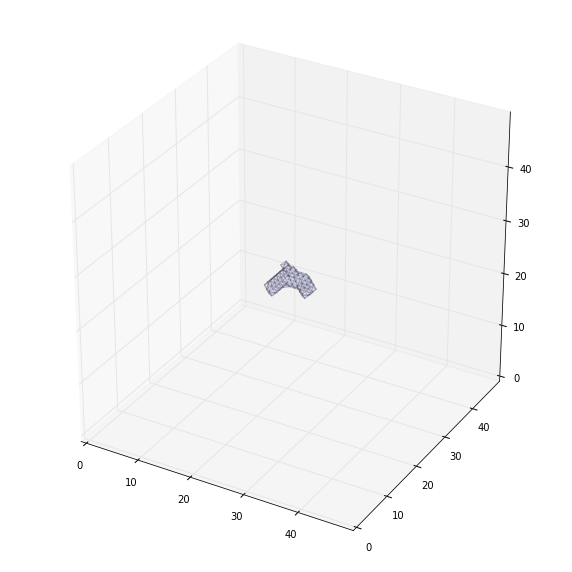

(49, 49, 49)
-94 -1000


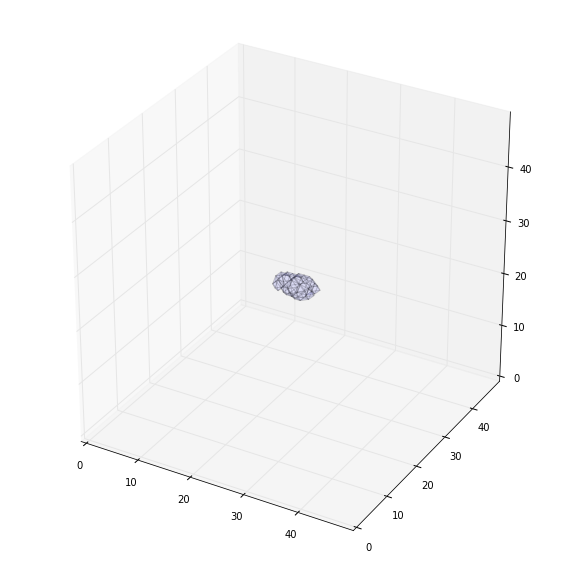

(49, 49, 49)
4 -1000


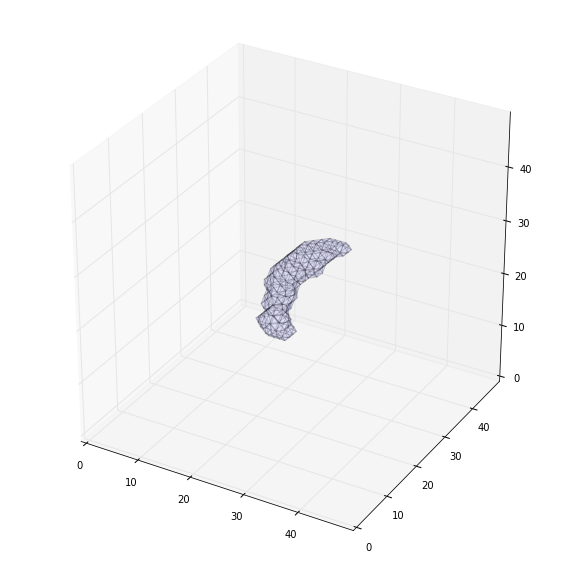

(49, 49, 49)
-1000 -1000
(49, 49, 49)
96 -1000


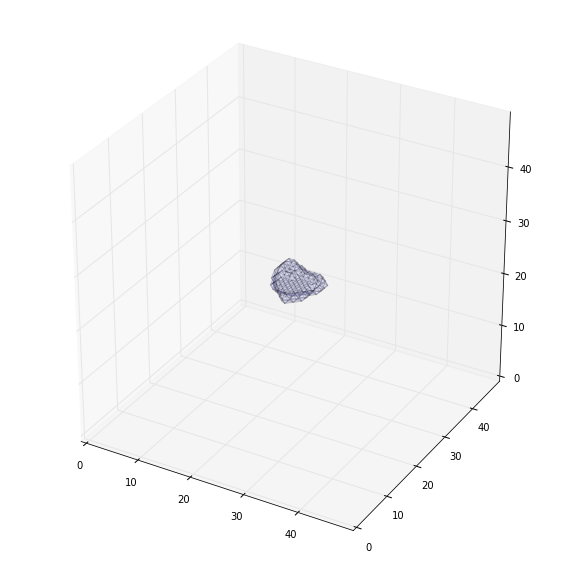

(49, 49, 49)
-46 -1000


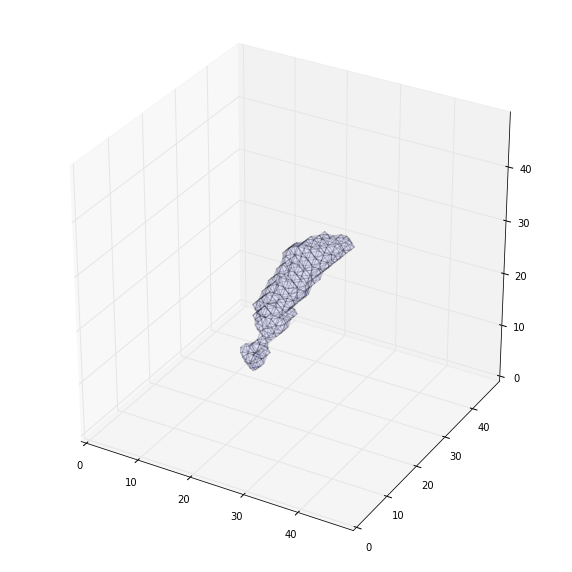

(49, 49, 49)
-49 -1000


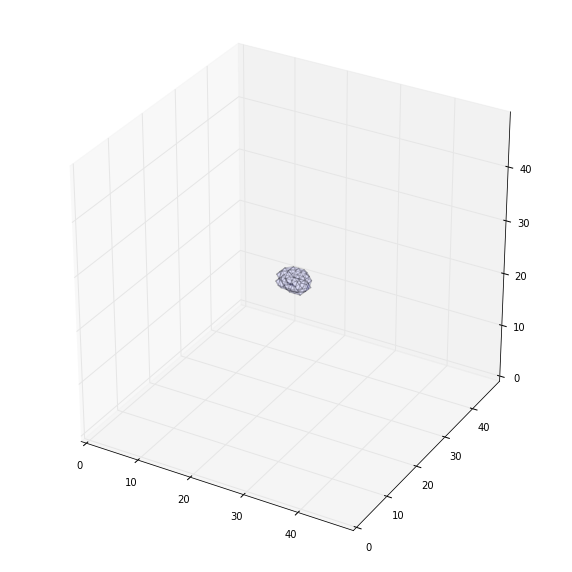

(49, 49, 49)
-100 -1000


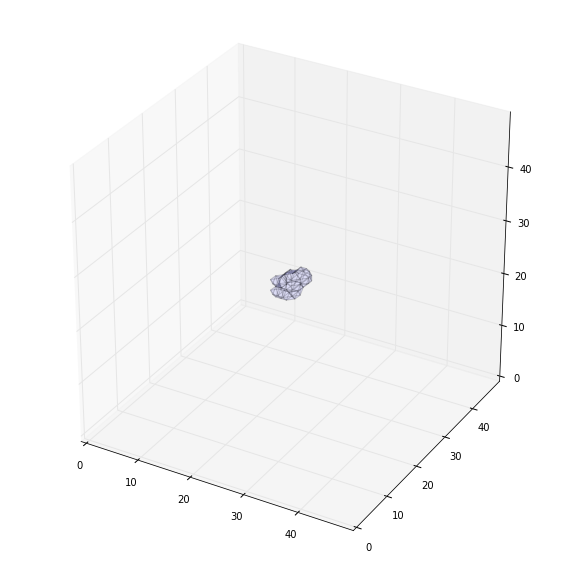

(49, 49, 49)
246 -1000


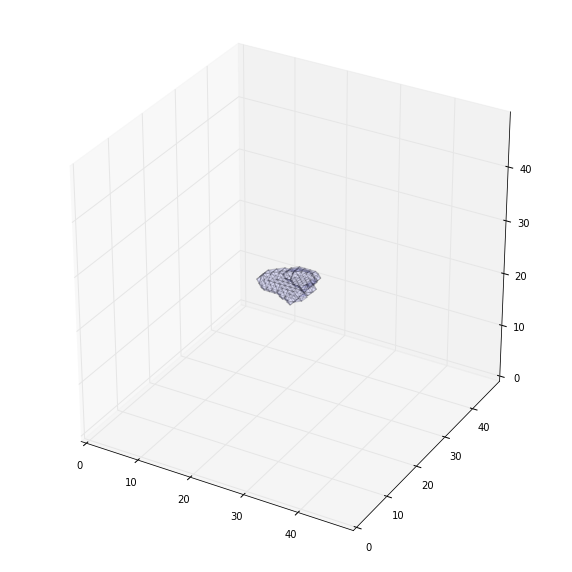

(49, 49, 49)
-215 -1000


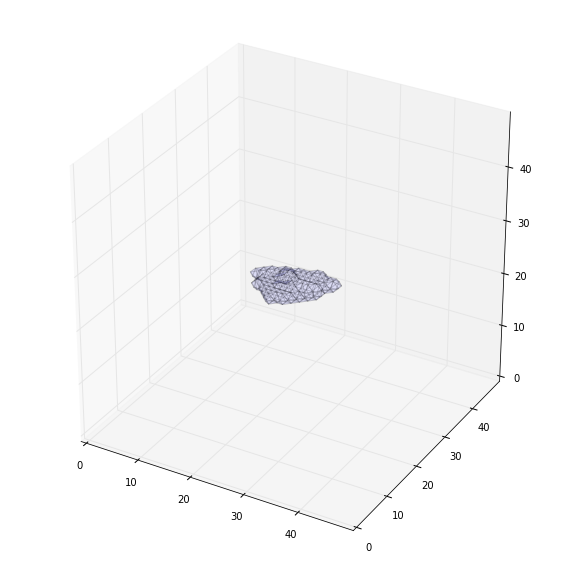

(49, 49, 49)
-110 -1000


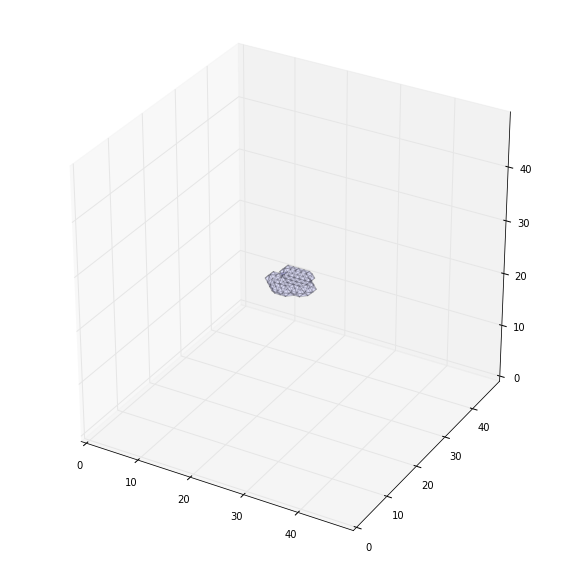

(49, 49, 49)
-91 -1000


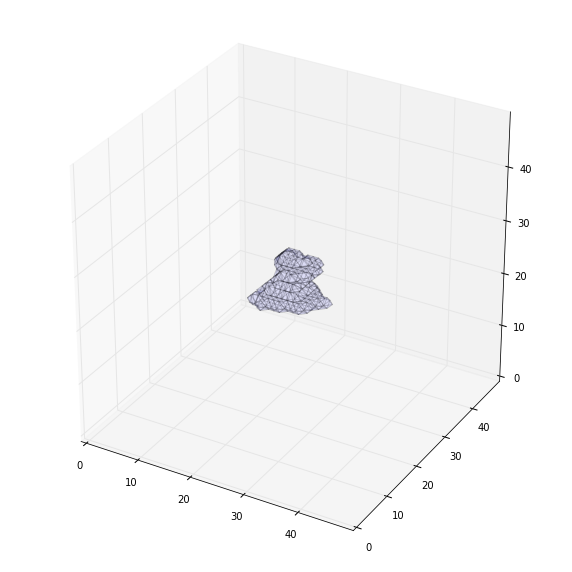

(49, 49, 49)
9 -1000


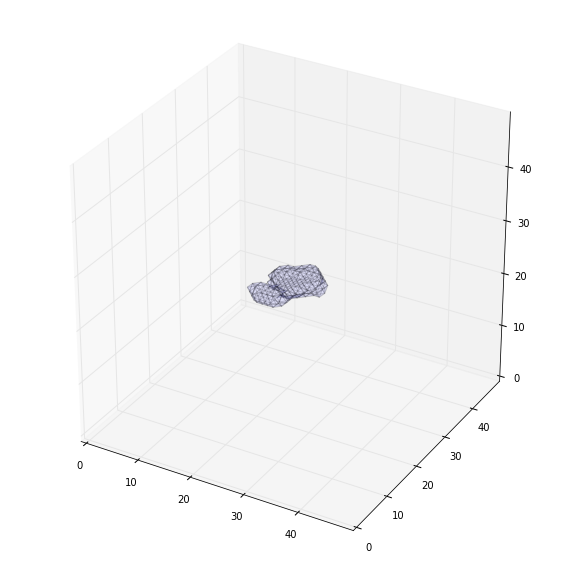

(49, 49, 49)
-23 -1000


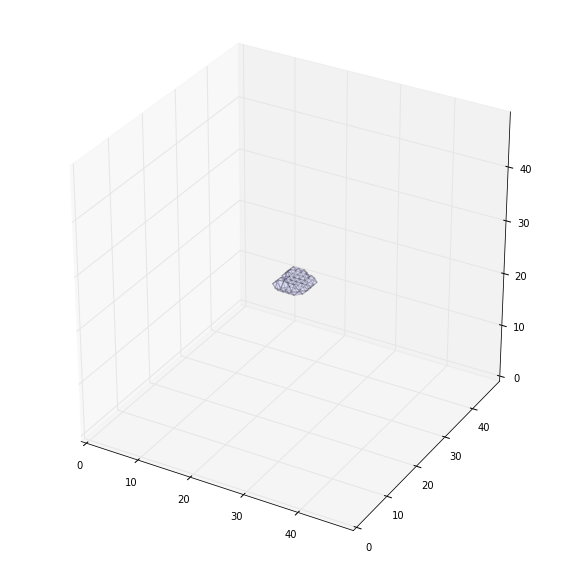

(49, 49, 49)
-39 -1000


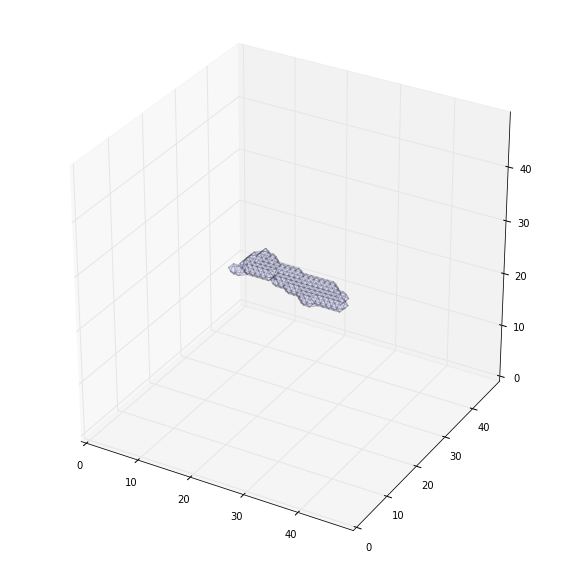

(49, 49, 49)
79 -1000


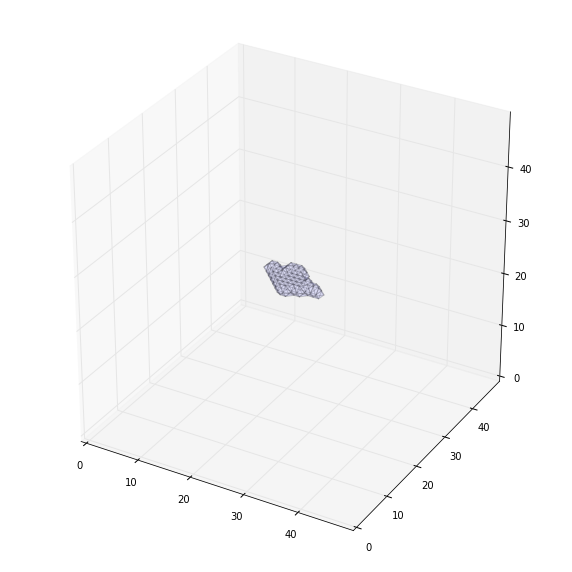

(49, 49, 49)
-1000 -1000
(49, 49, 49)
-302 -1000


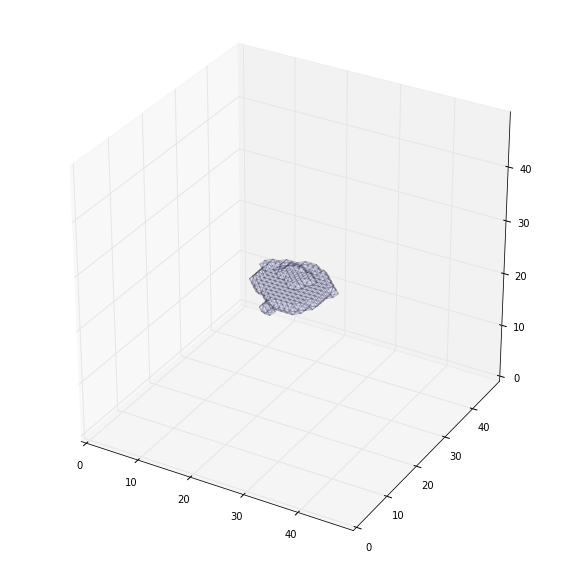

(49, 49, 49)
-1000 -1000
(49, 49, 49)
80 -1000


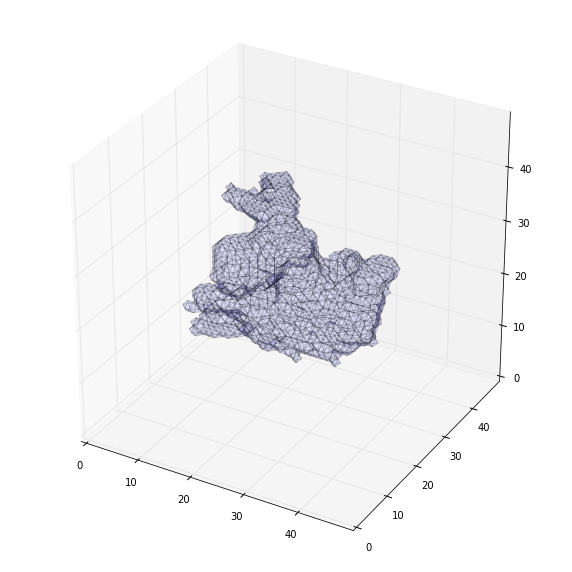

(49, 49, 49)
-19 -1000


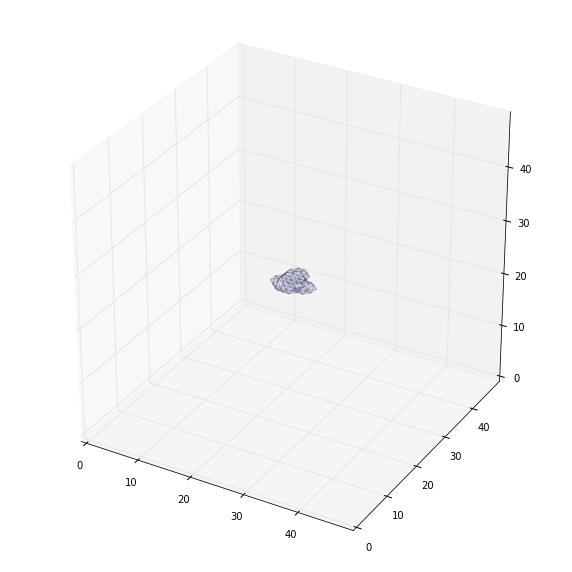

(49, 49, 49)
67 -1000


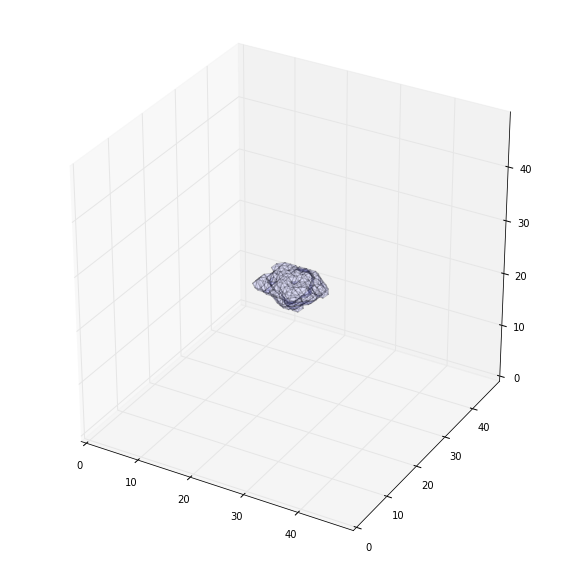

(49, 49, 49)
87 -1000


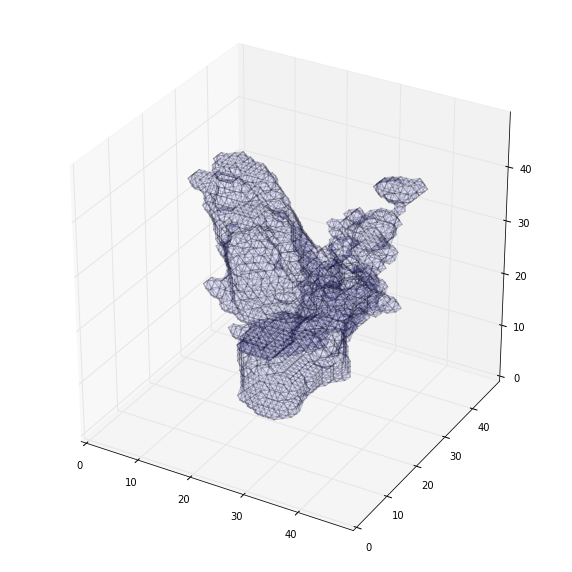

(49, 49, 49)
-149 -1000


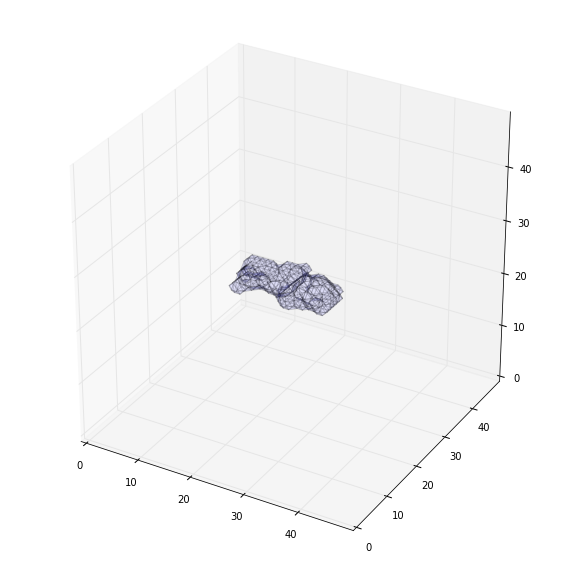

(49, 49, 49)
178 -1000


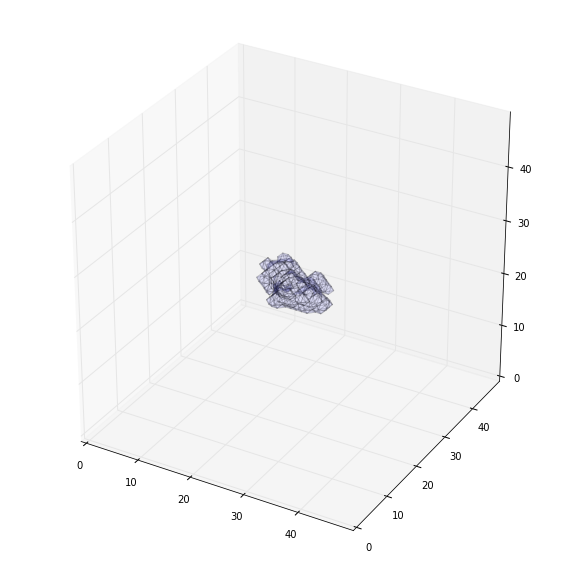

(49, 49, 49)
69 -1000


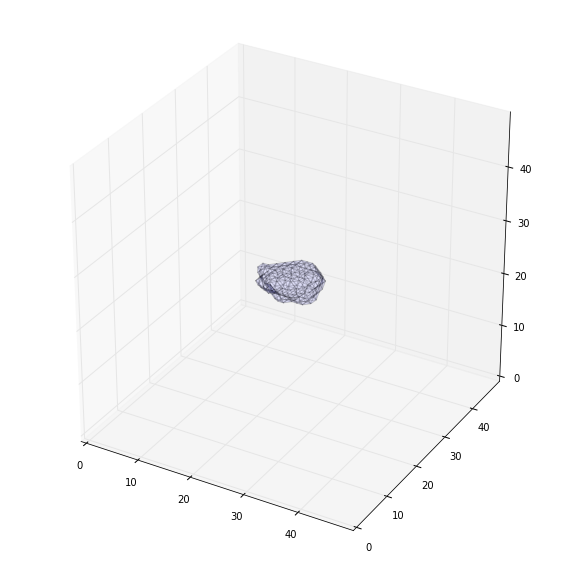

(49, 49, 49)
6 -1000


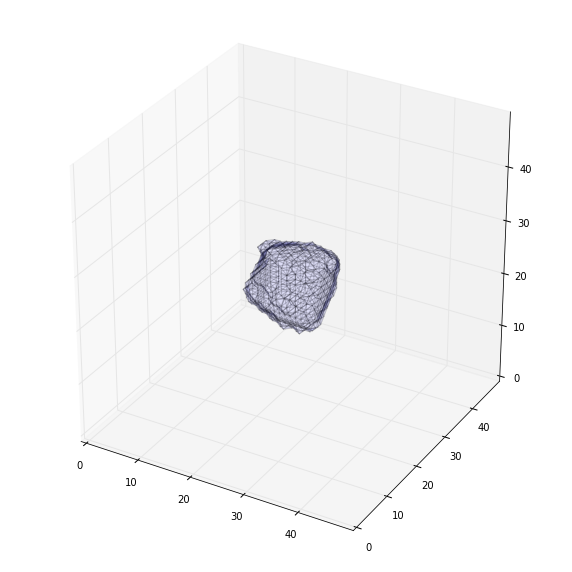

(49, 49, 49)
6 -1000


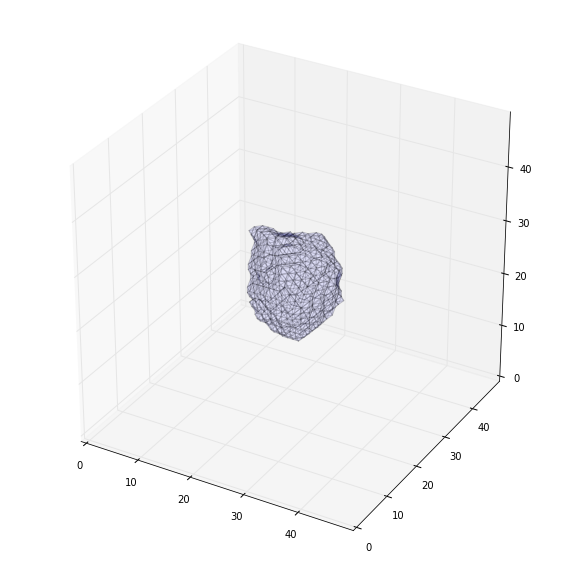

(49, 49, 49)
6 -1000


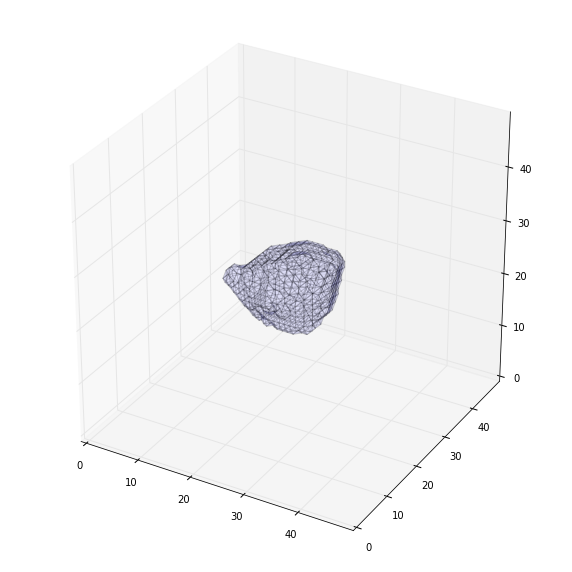

(49, 49, 49)
6 -1000


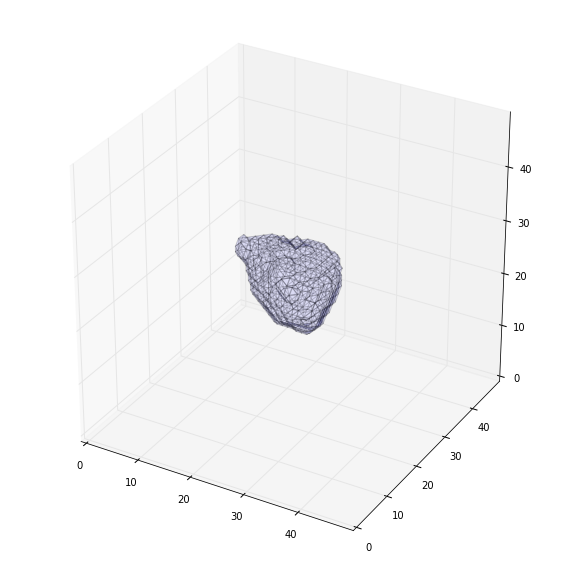

(49, 49, 49)
6 -1000


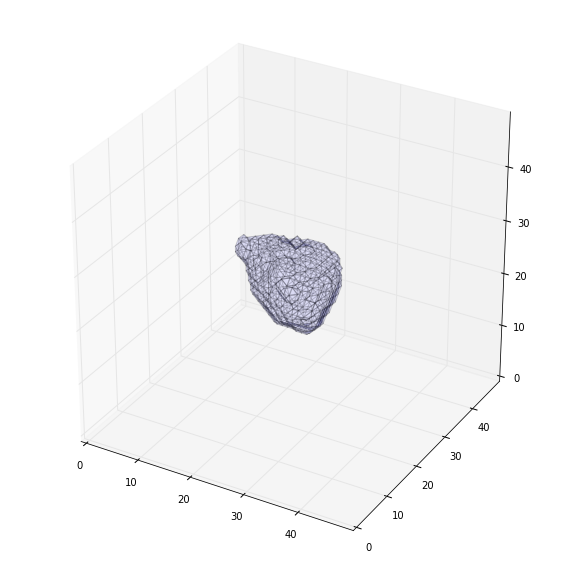

(49, 49, 49)
6 -1000


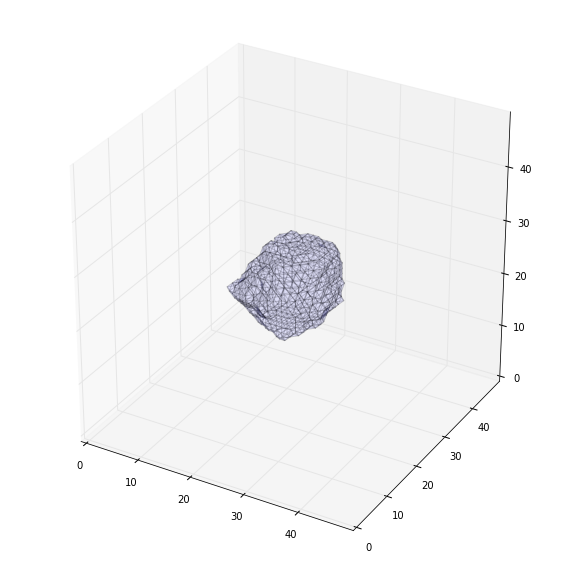

(49, 49, 49)
-138 -1000


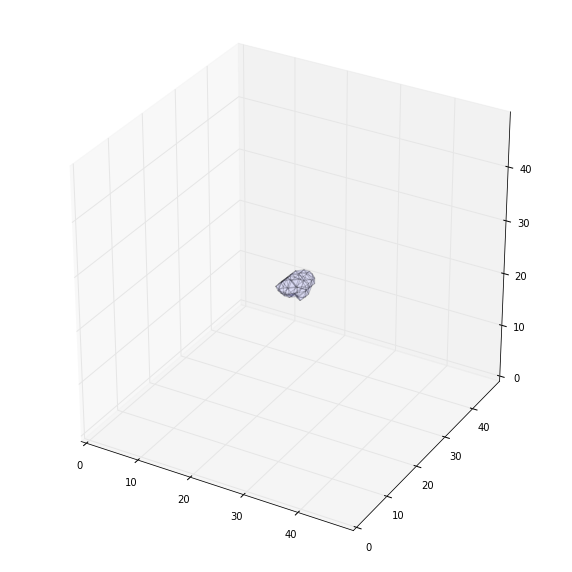

(49, 49, 49)
-110 -1000


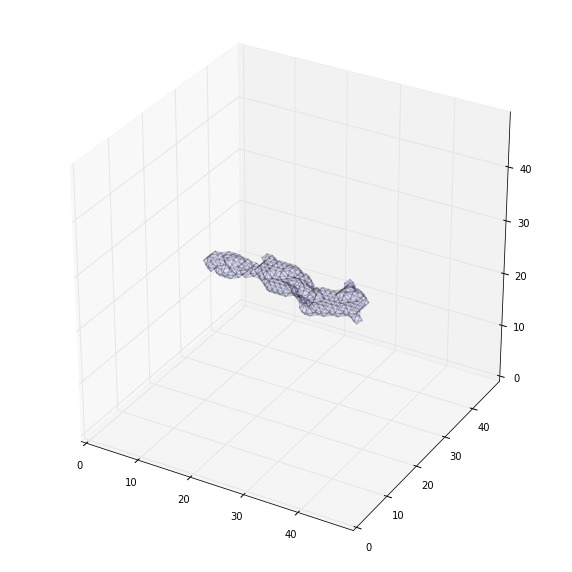

(49, 49, 49)
-176 -1000


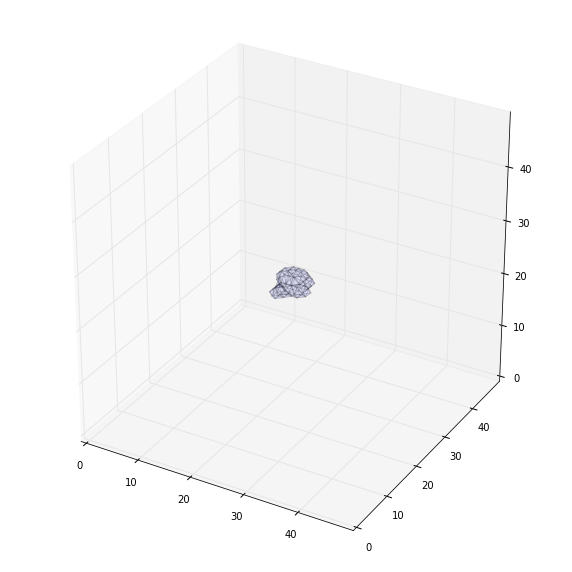

(49, 49, 49)
16 -1000


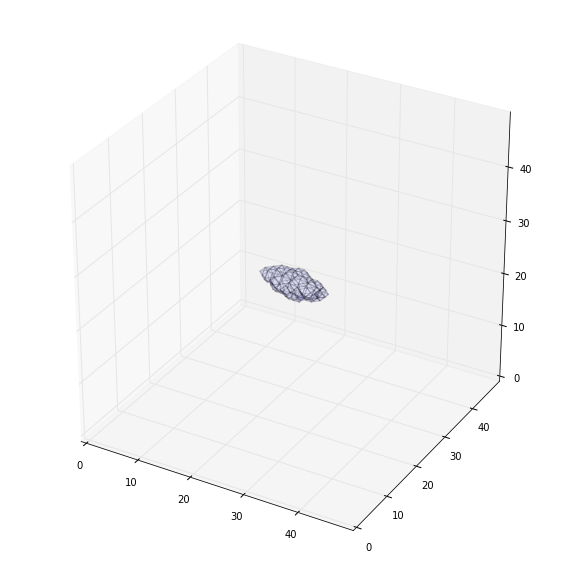

(49, 49, 49)
100 -1000


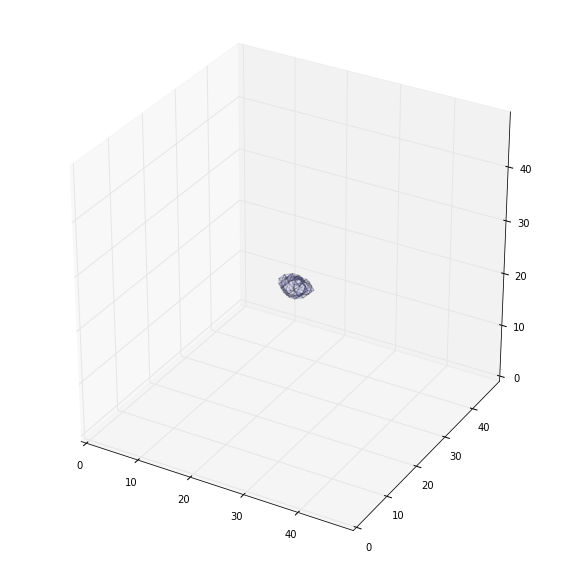

(49, 49, 49)
-121 -1000


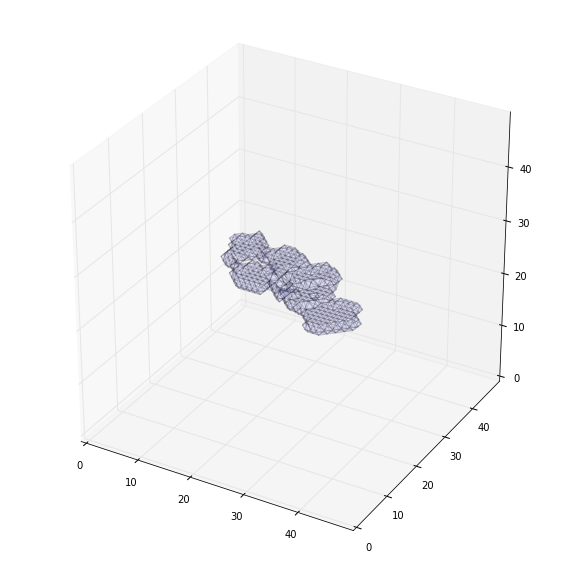

(49, 49, 49)
8 -1000


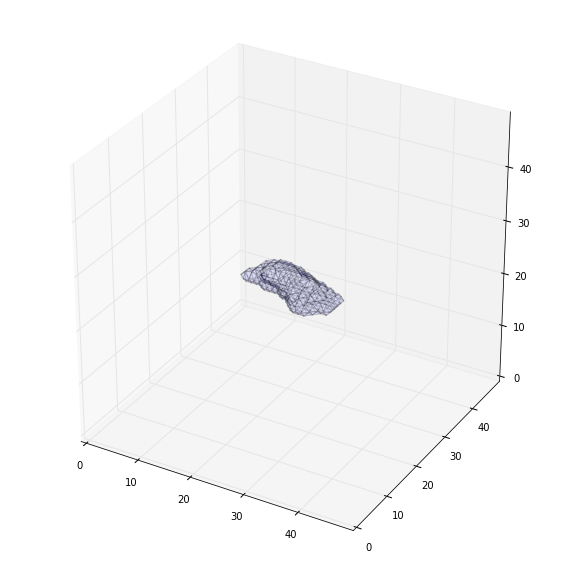

(49, 49, 49)
17 -1000


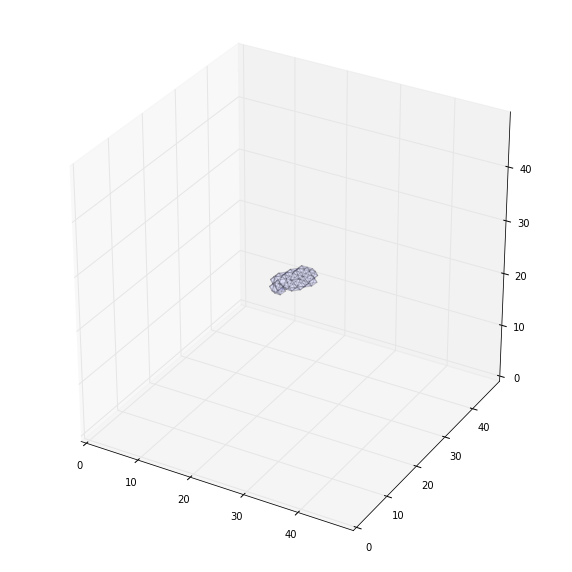

(49, 49, 49)
-1000 -1000
(49, 49, 49)
-1000 -1000
(49, 49, 49)
-87 -1000


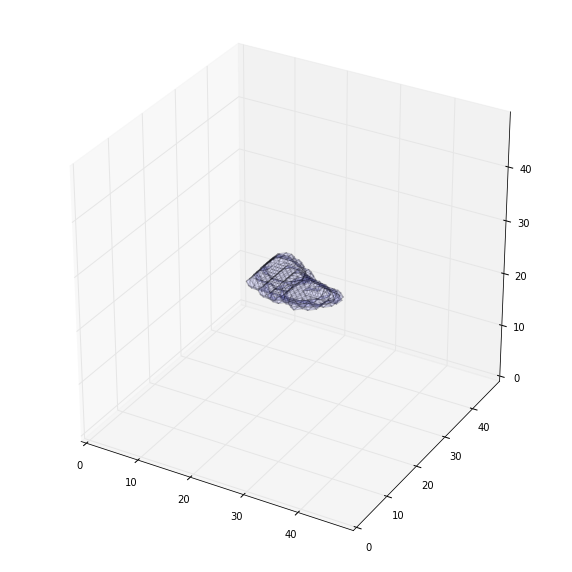

(49, 49, 49)
-97 -1000


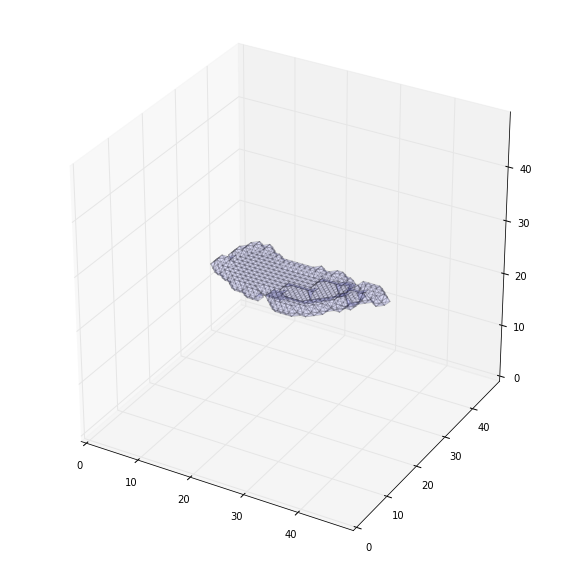

(49, 49, 49)
-89 -1000


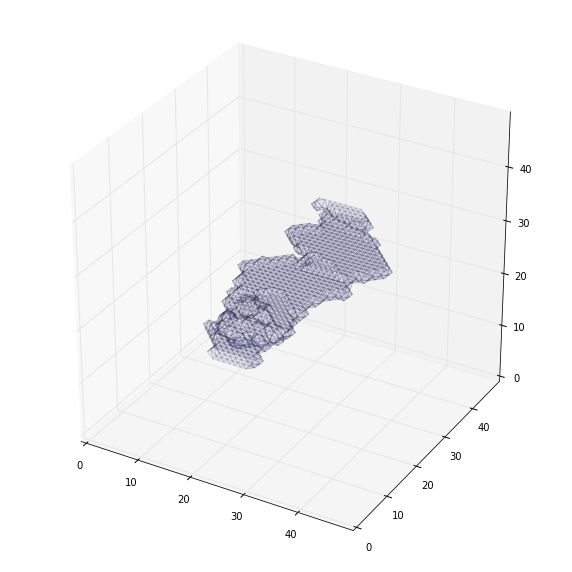

(49, 49, 49)
-6 -1000


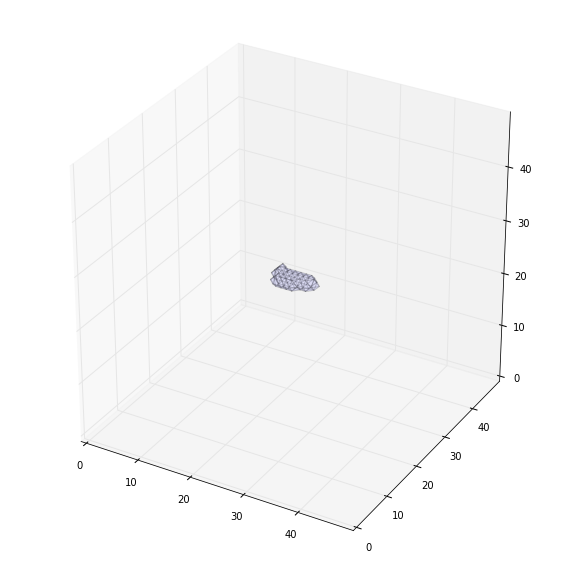

(49, 49, 49)
-76 -1000


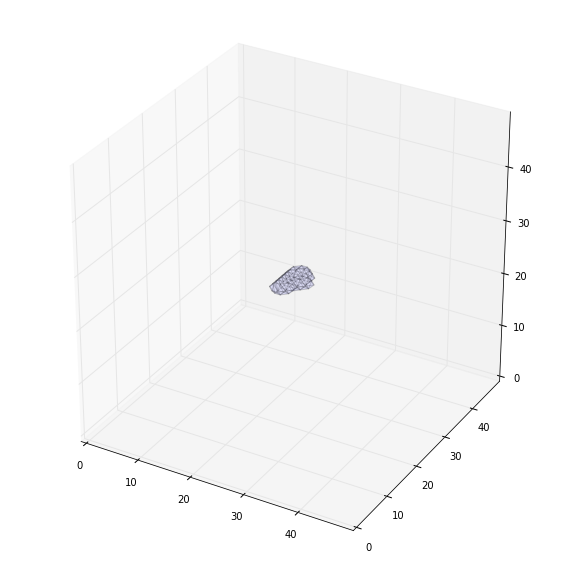

(49, 49, 49)
-8 -1000


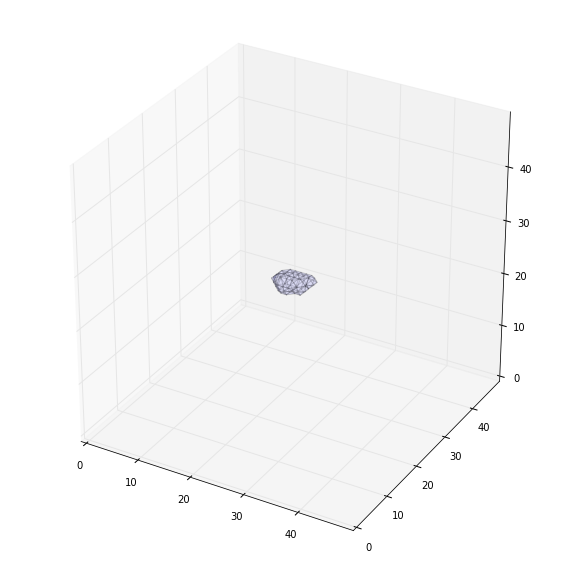

(49, 49, 49)
78 -1000


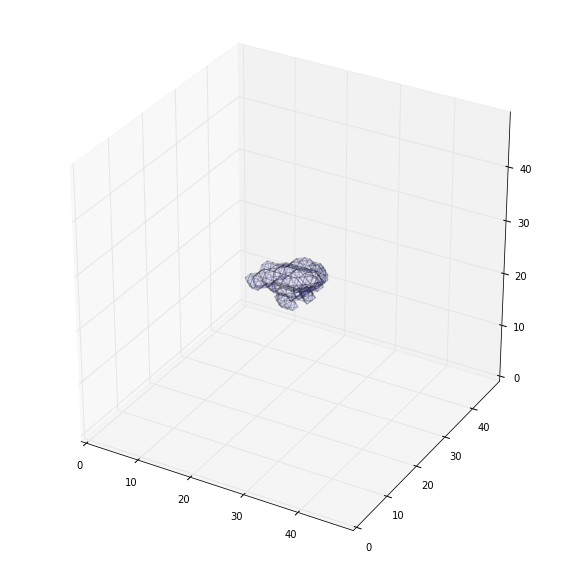

(49, 49, 49)
54 -1000


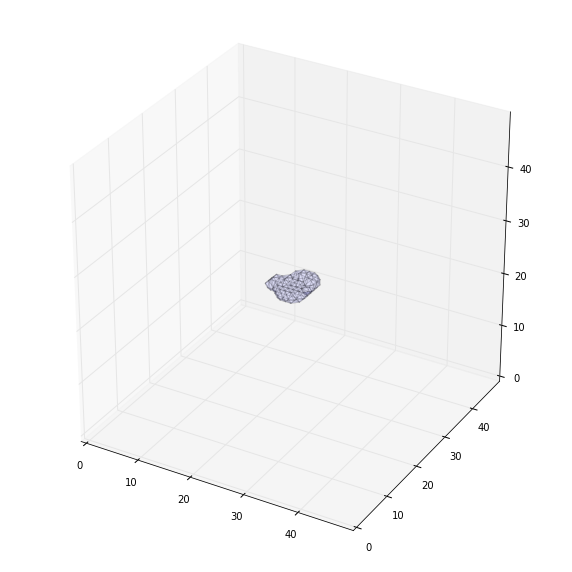

(49, 49, 49)
26 -1000


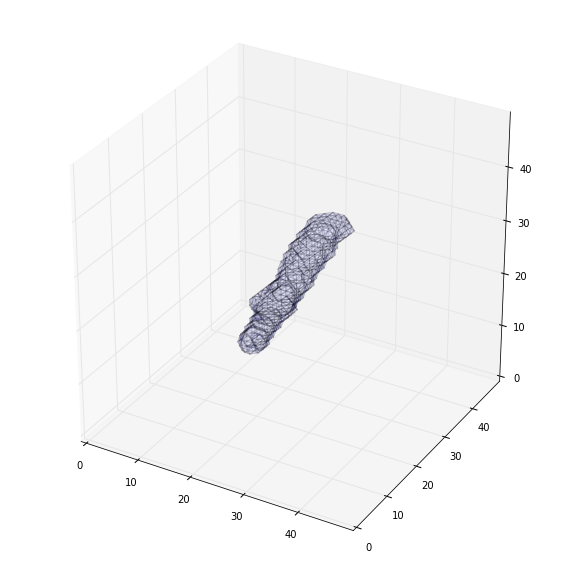

(49, 49, 49)
-7 -1000


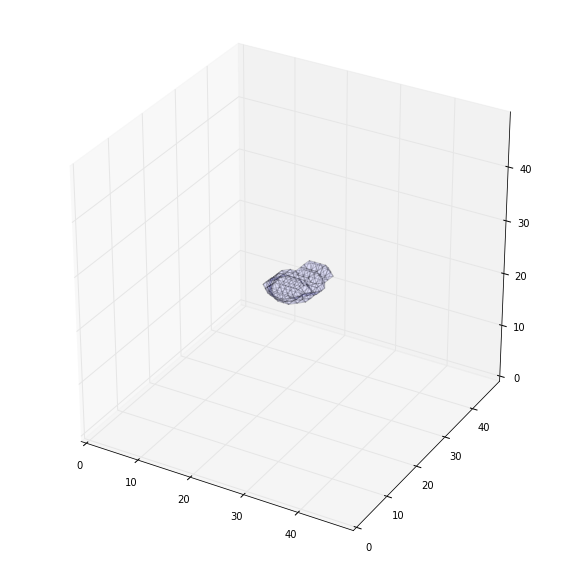

(49, 49, 49)
57 -1000


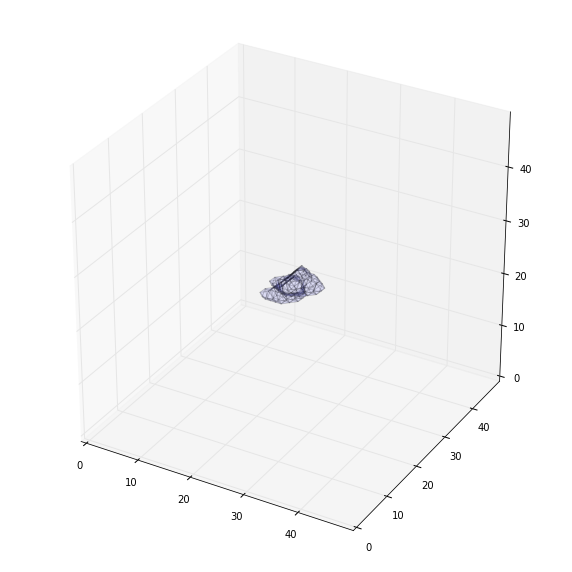

(49, 49, 49)
31 -1000


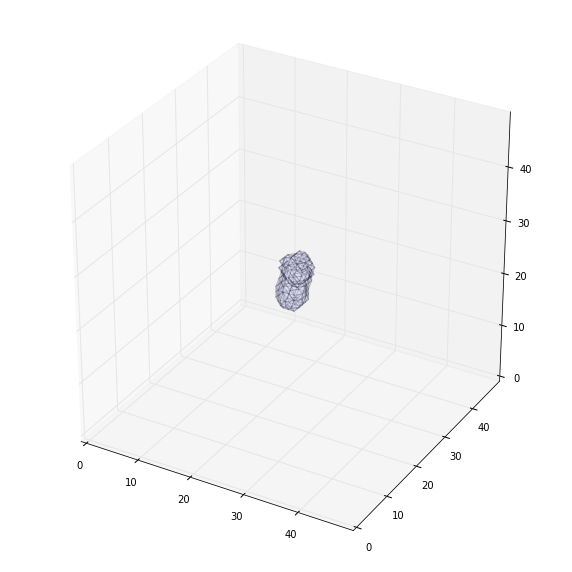

(49, 49, 49)
-165 -1000


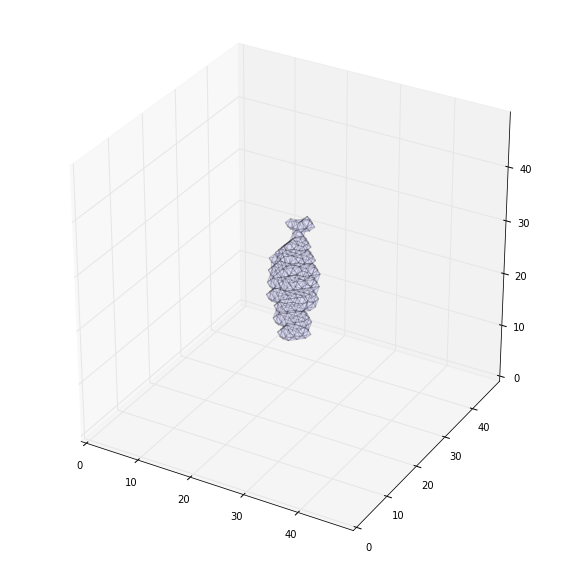

(49, 49, 49)
-46 -1000


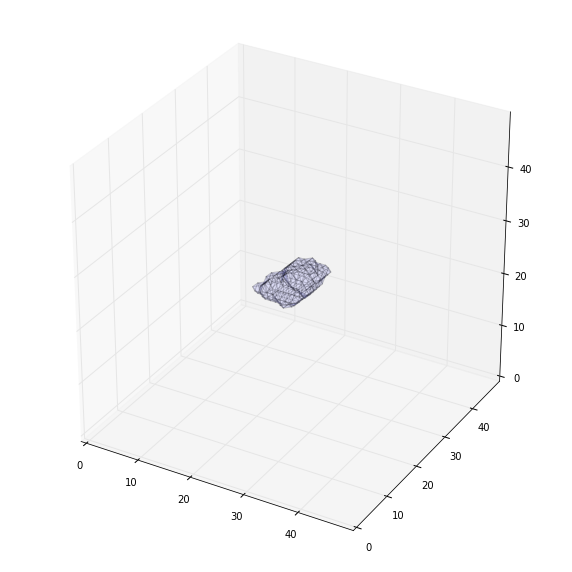

(49, 49, 49)
16 -1000


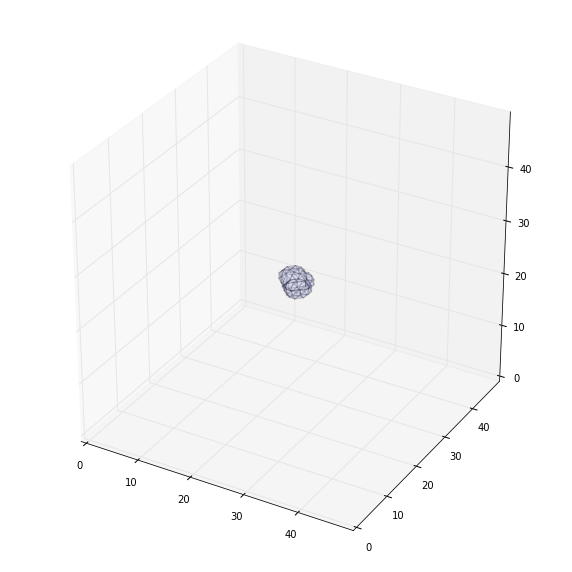

(49, 49, 49)
12 -1000


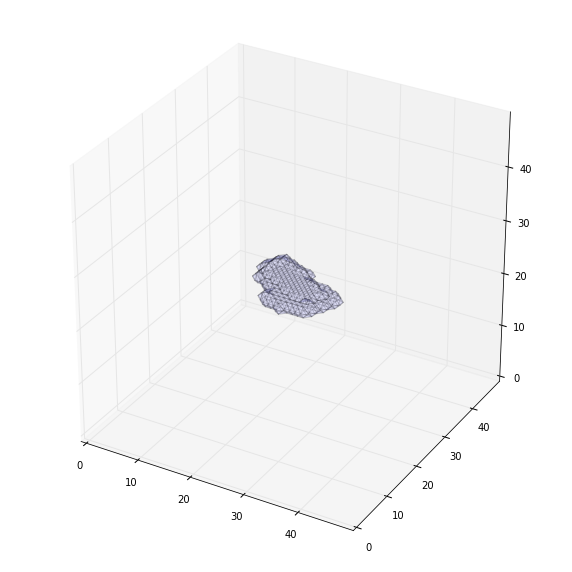

(49, 49, 49)
40 -1000


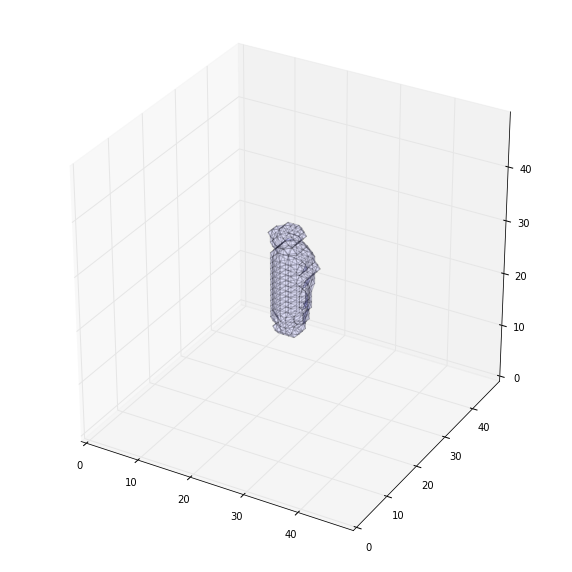

(49, 49, 49)
57 -1000


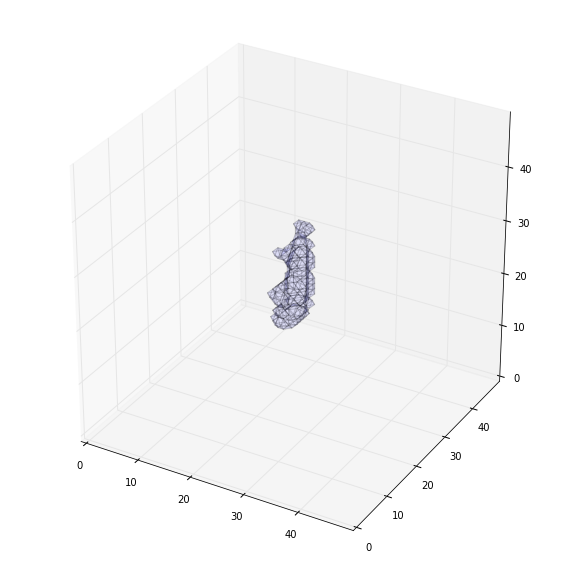

(49, 49, 49)
-51 -1000


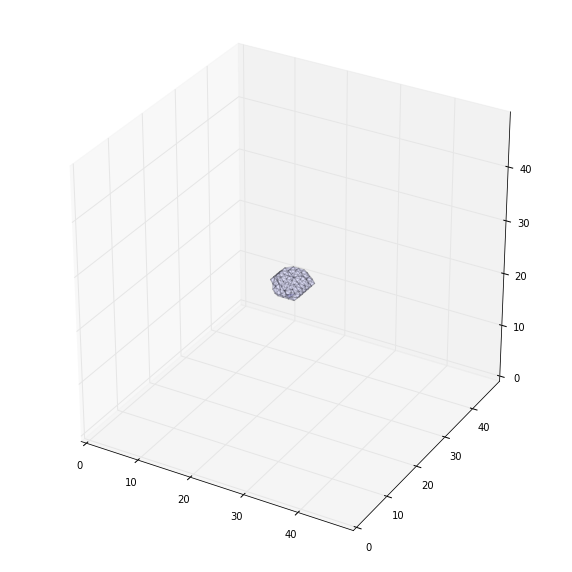

(49, 49, 49)
64 -1000


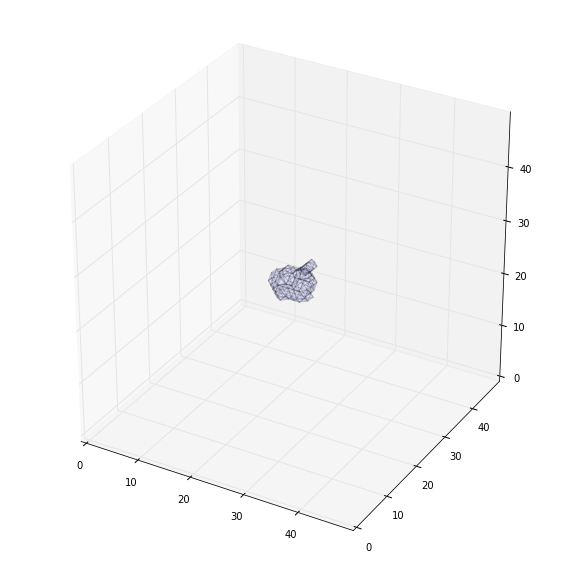

(49, 49, 49)
-63 -1000


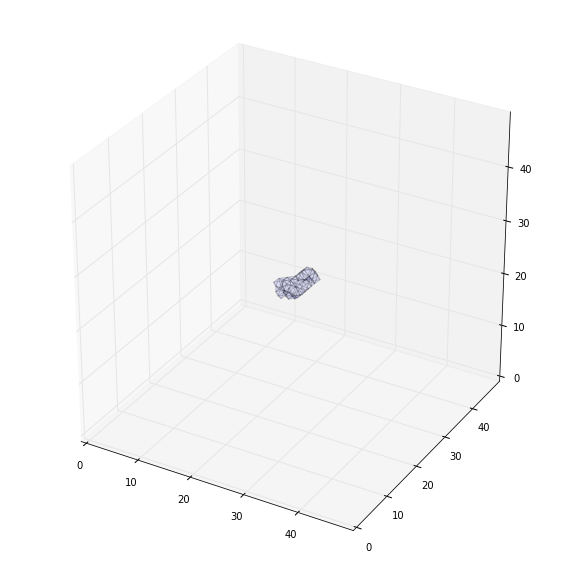

(49, 49, 49)
-47 -1000


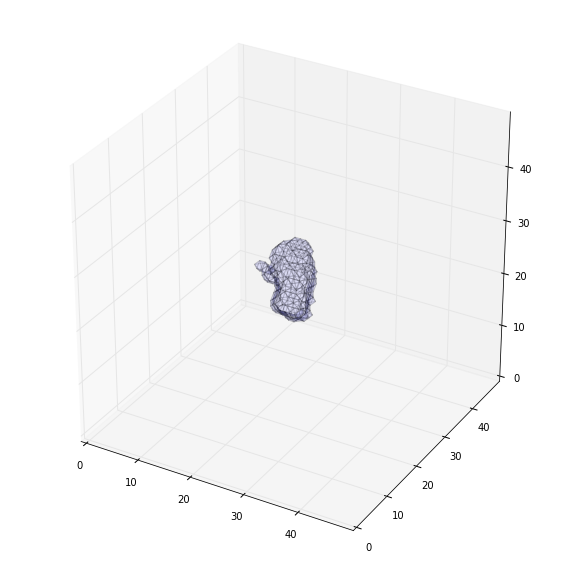

(49, 49, 49)
-134 -1000


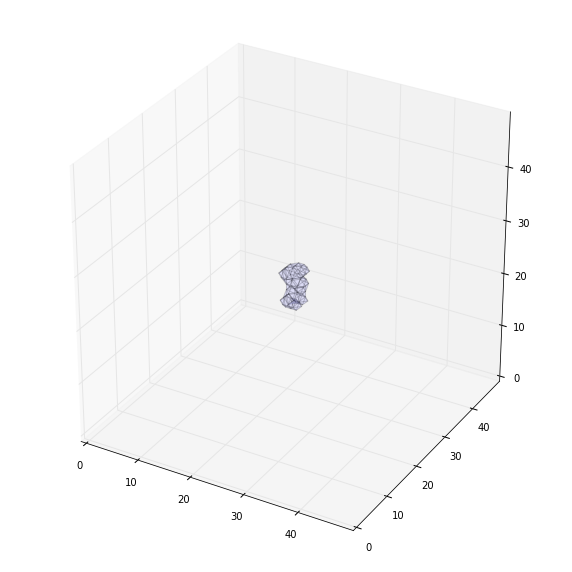

(49, 49, 49)
-91 -1000


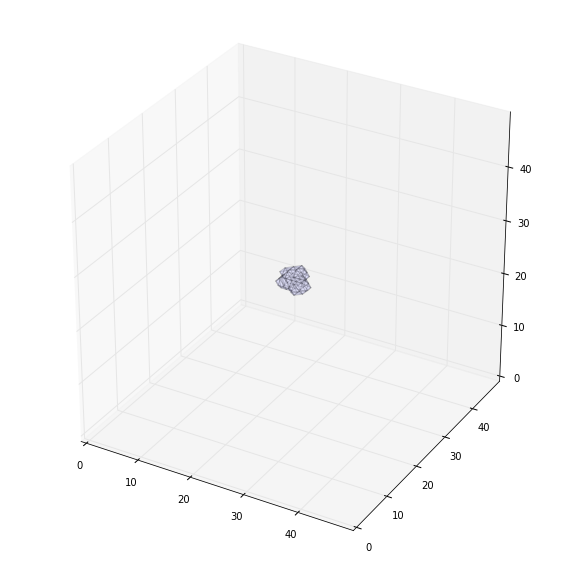

(49, 49, 49)
-20 -1000


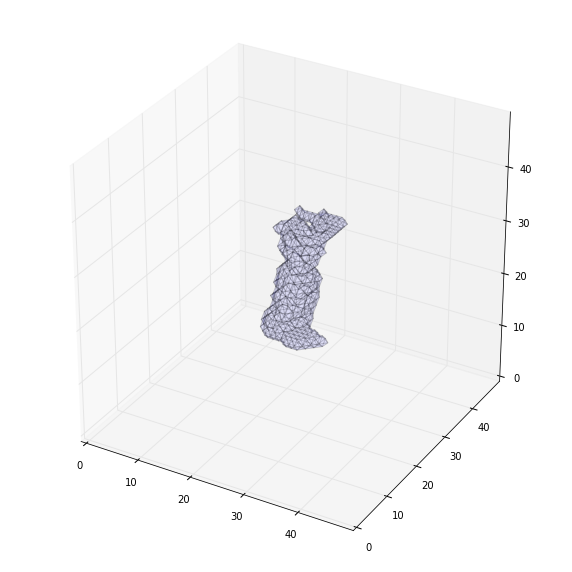

(49, 49, 49)
32 -1000


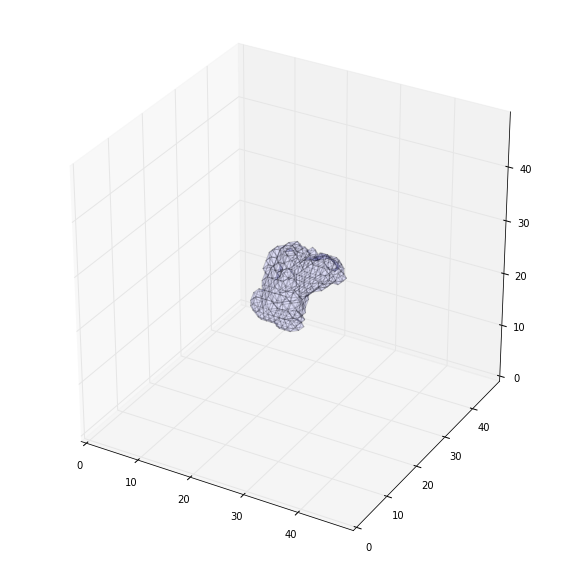

(49, 49, 49)
-1000 -1000
(49, 49, 49)
42 -1000


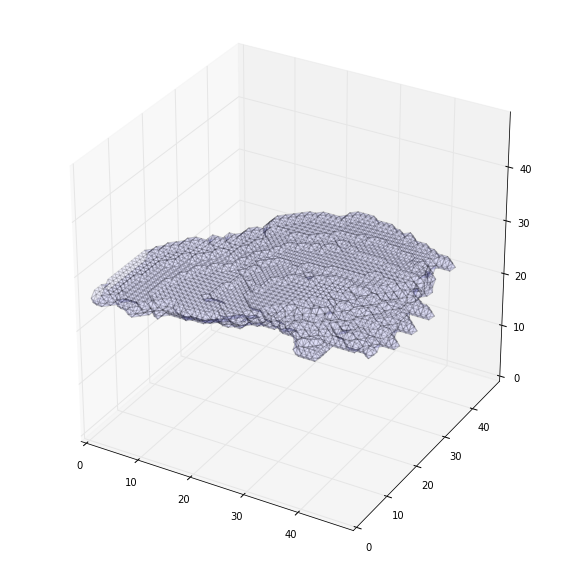

(49, 49, 49)
54 -1000


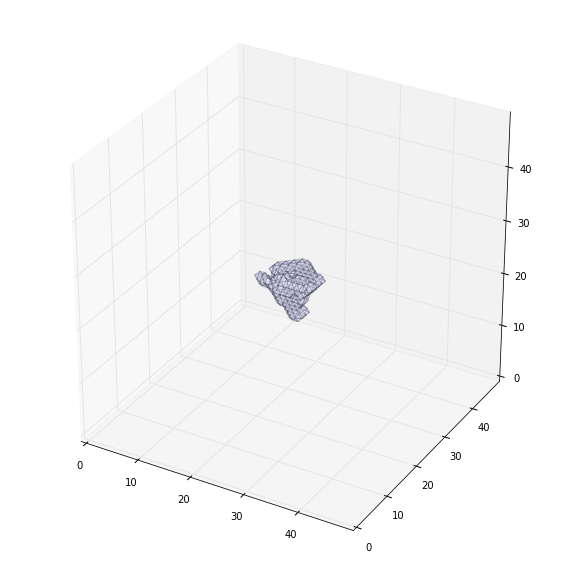

(49, 49, 49)
-151 -1000


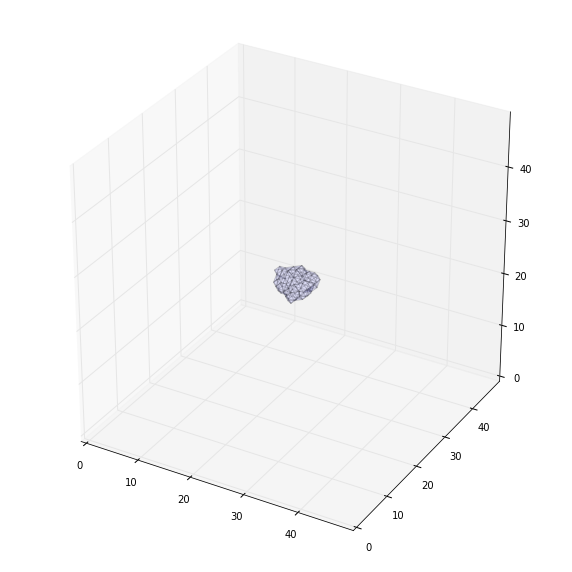

(49, 49, 49)
0 -1000


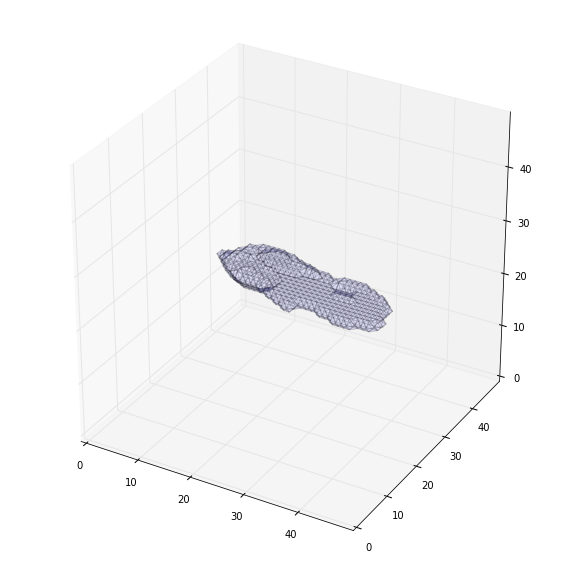

(49, 49, 49)
6 -1000


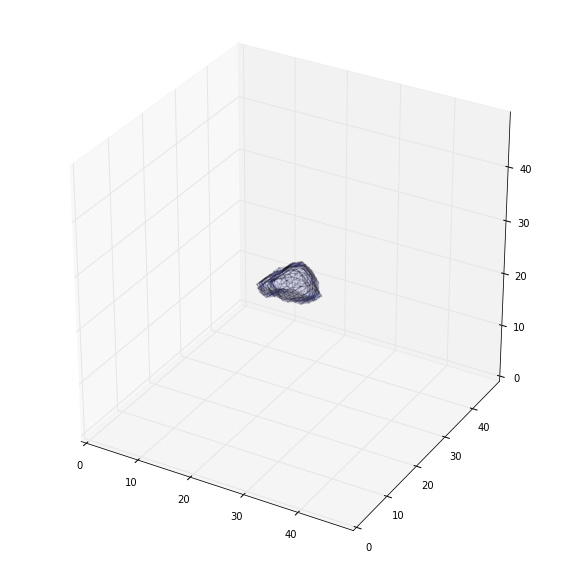

(49, 49, 49)
-99 -1000


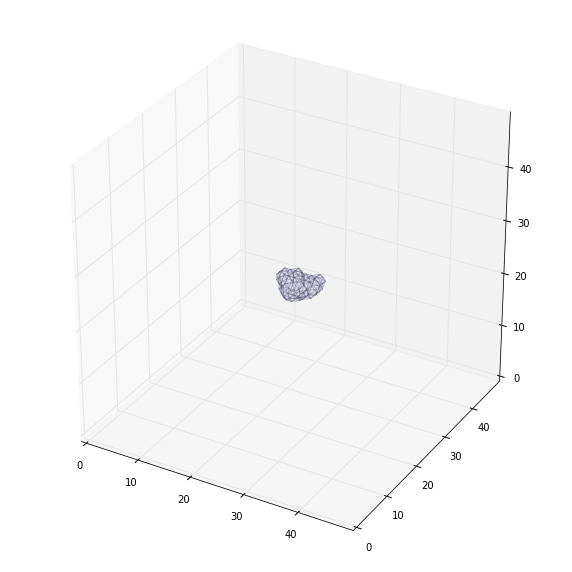

(49, 49, 49)
87 -1000


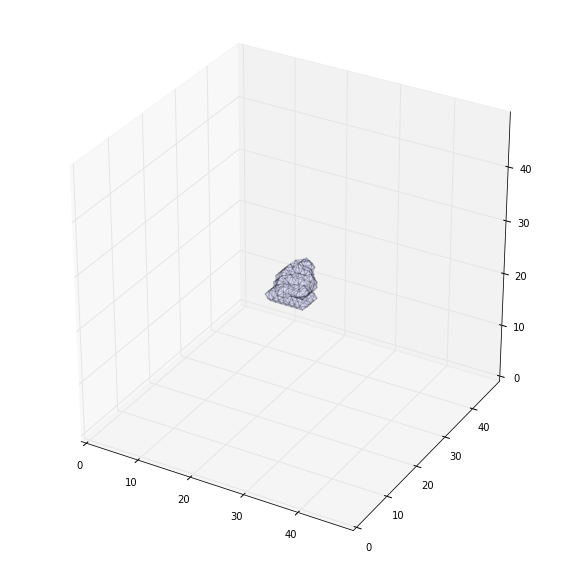

(49, 49, 49)
-1000 -1000
(49, 49, 49)
5 -1000


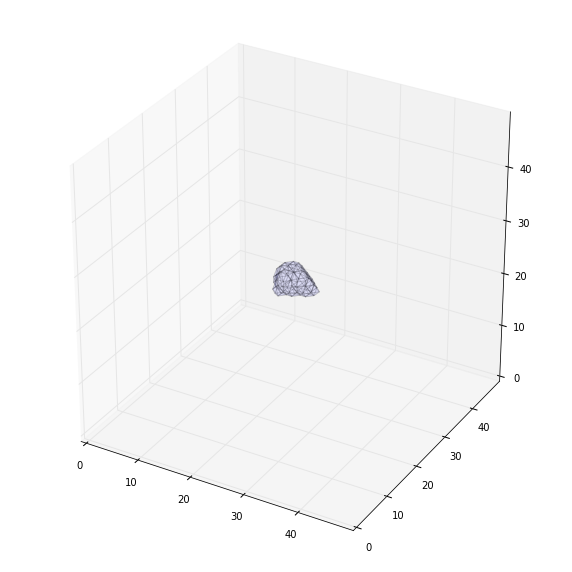

(49, 49, 49)
-44 -1000


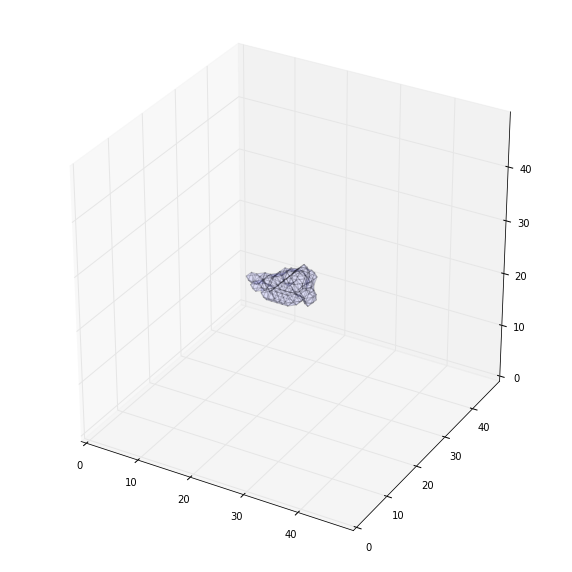

(49, 49, 49)
-18 -1000


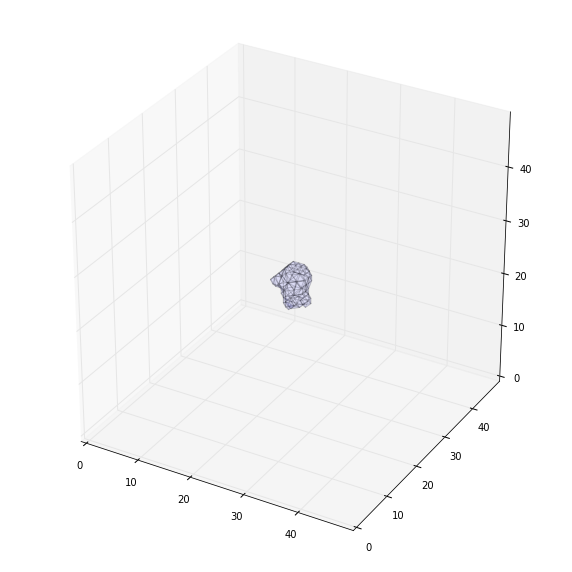

(49, 49, 49)
72 -1000


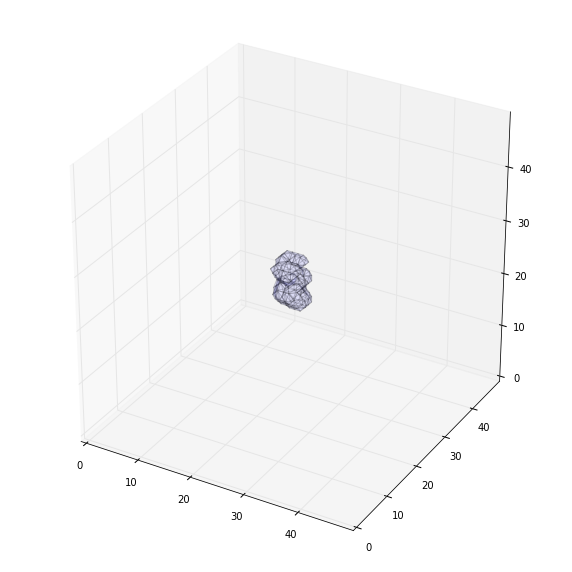

(49, 49, 49)
-24 -1000


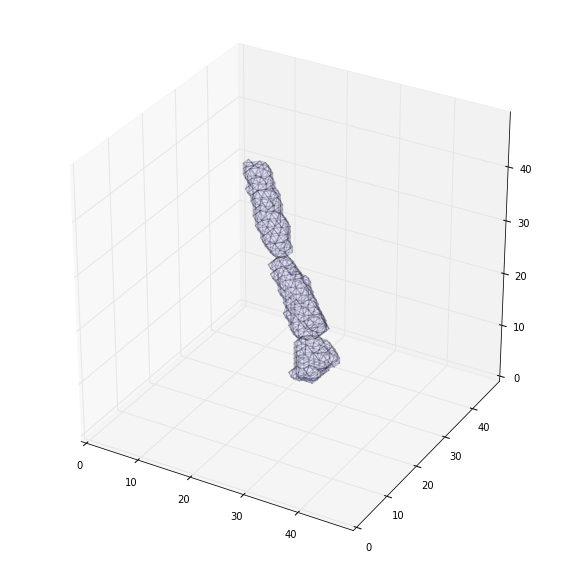

(49, 49, 49)
-208 -1000


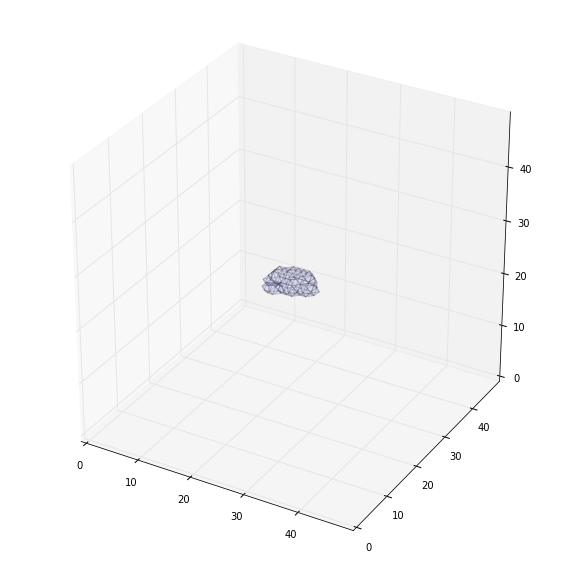

(49, 49, 49)
-146 -1000


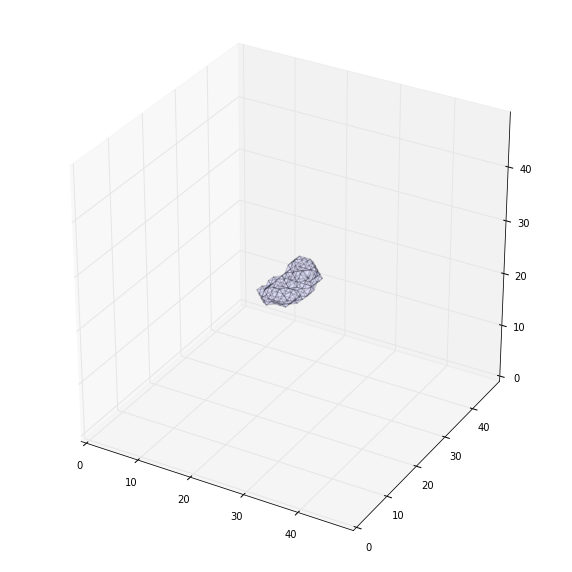

(49, 49, 49)
-126 -1000


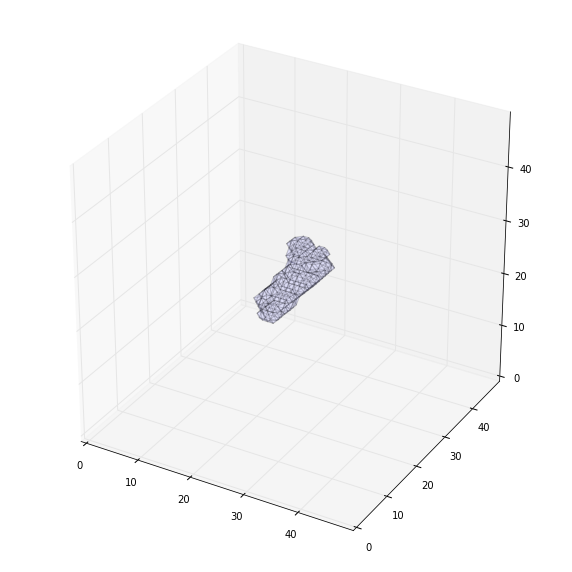

(49, 49, 49)
-164 -1000


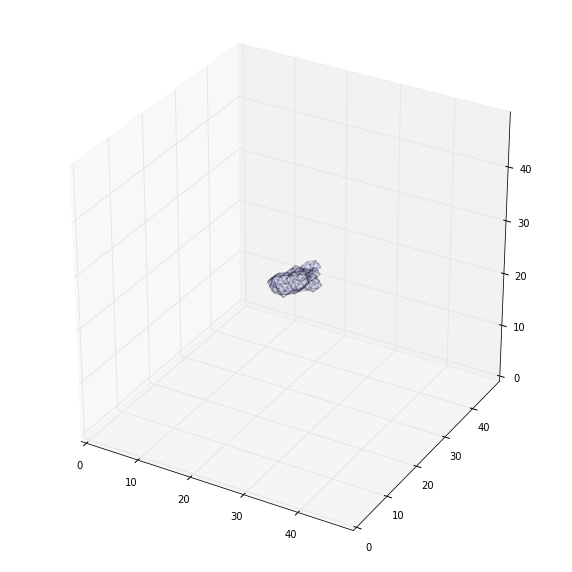

(49, 49, 49)
-168 -1000


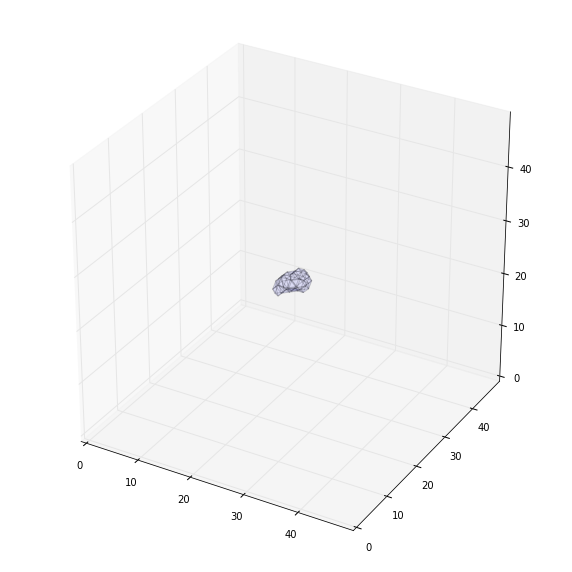

(49, 49, 49)
-93 -1000


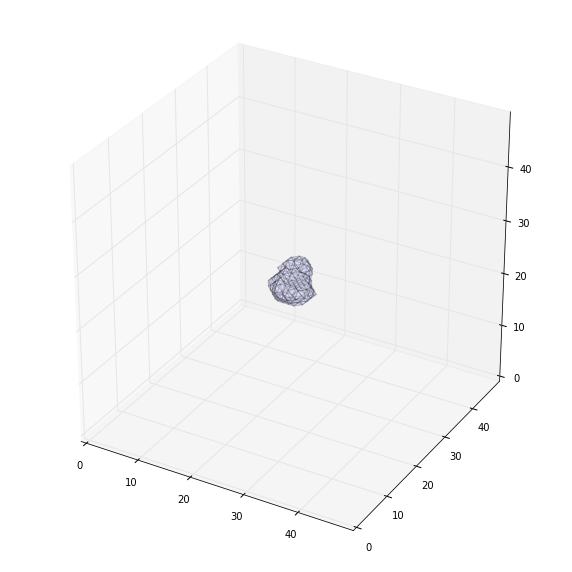

(49, 49, 49)
-93 -1000


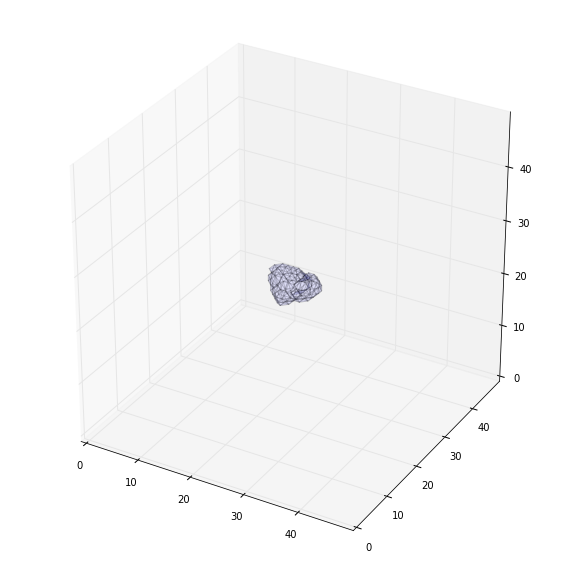

(49, 49, 49)
-164 -1000


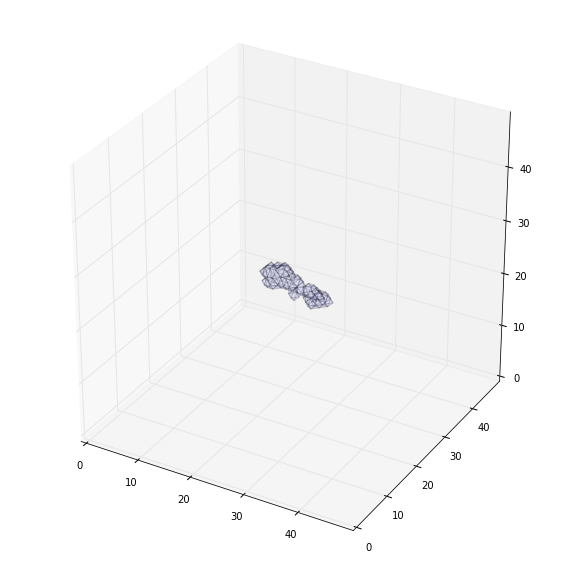

(49, 49, 49)
-191 -1000


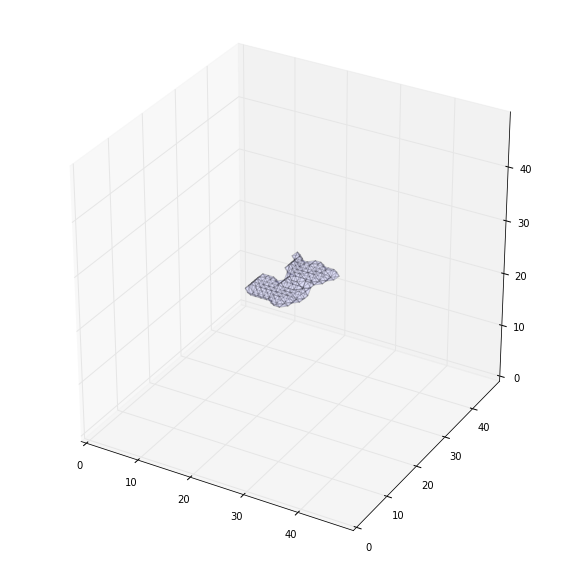

(49, 49, 49)
-246 -1000


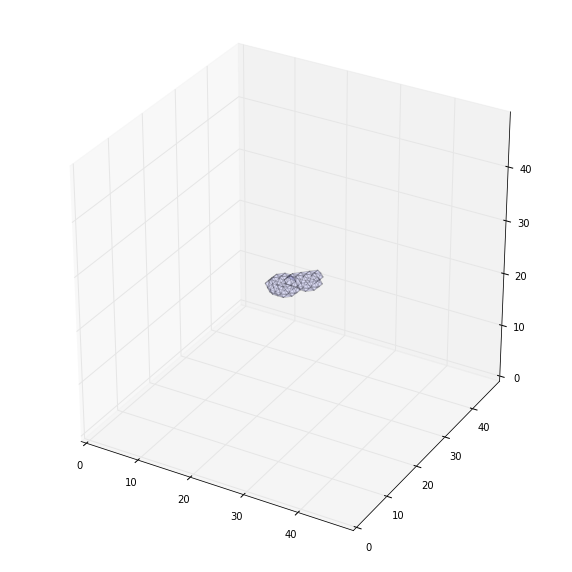

(49, 49, 49)
-234 -1000


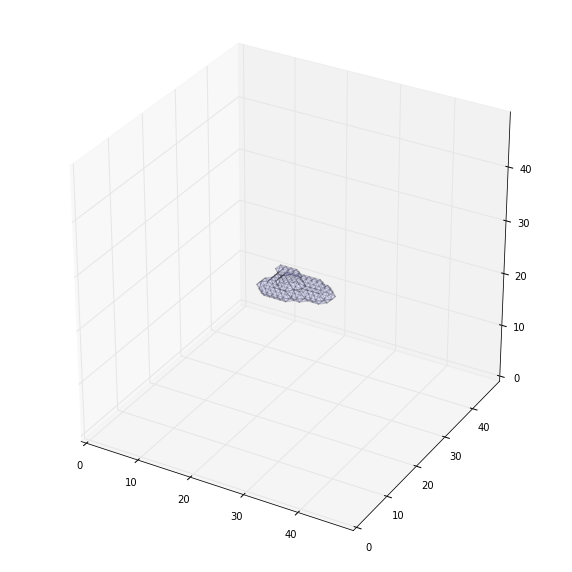

(49, 49, 49)
143 -1000


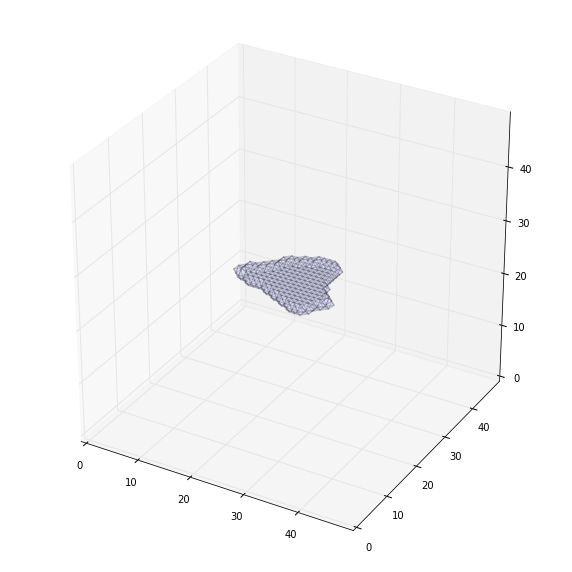

(49, 49, 49)
90 -1000


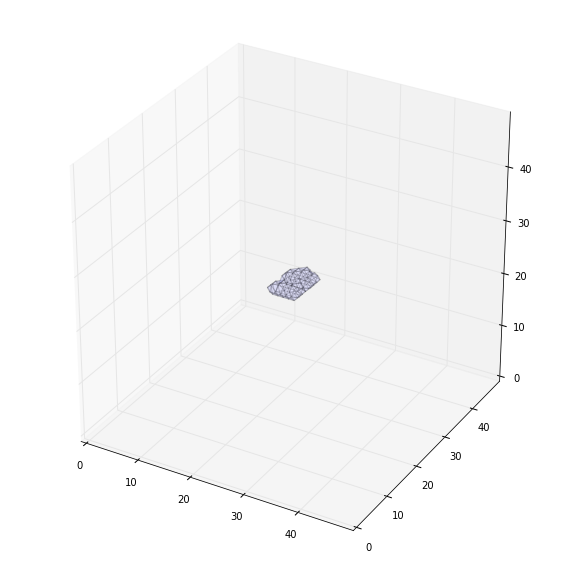

(49, 49, 49)
137 -1000


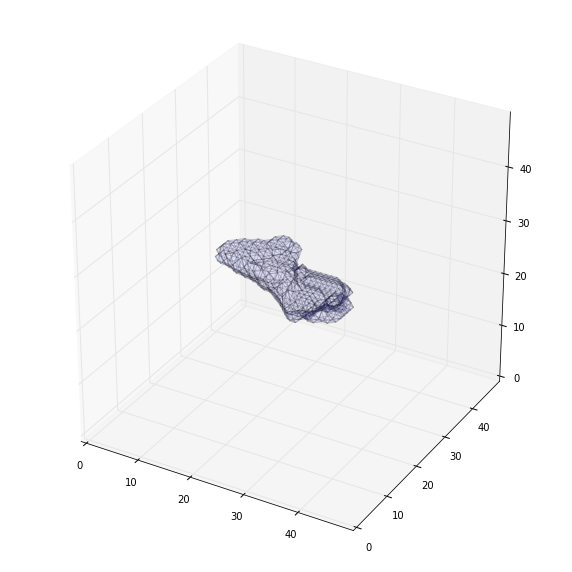

(49, 49, 49)
303 -1000


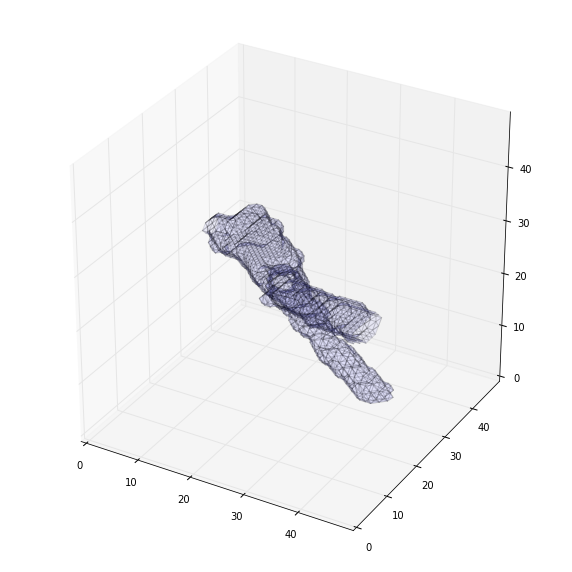

(49, 49, 49)
-63 -1000


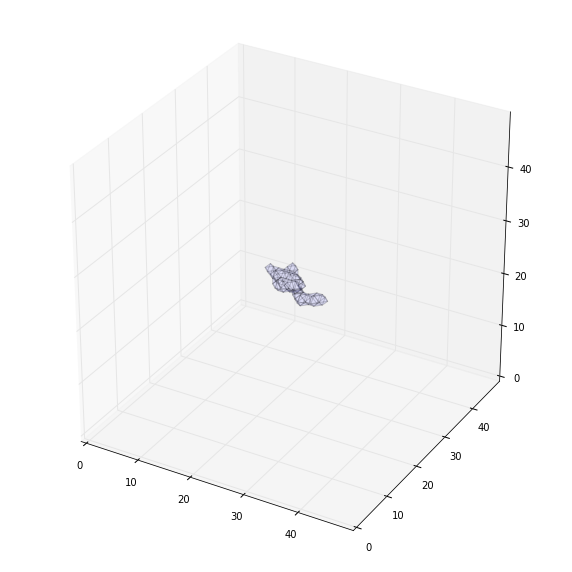

(49, 49, 49)
184 -1000


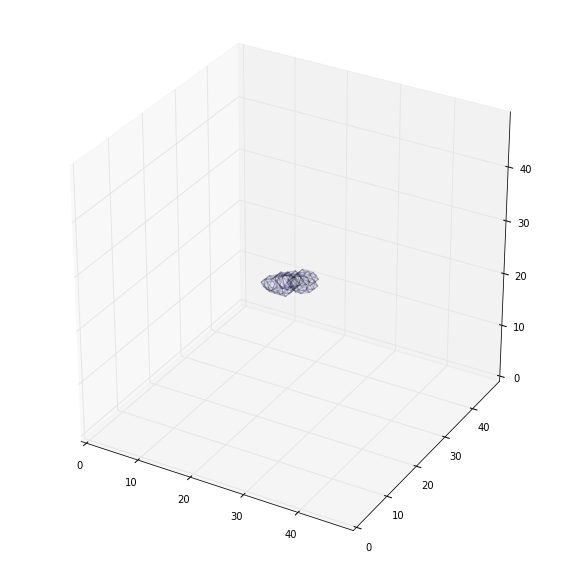

(49, 49, 49)
-221 -1000


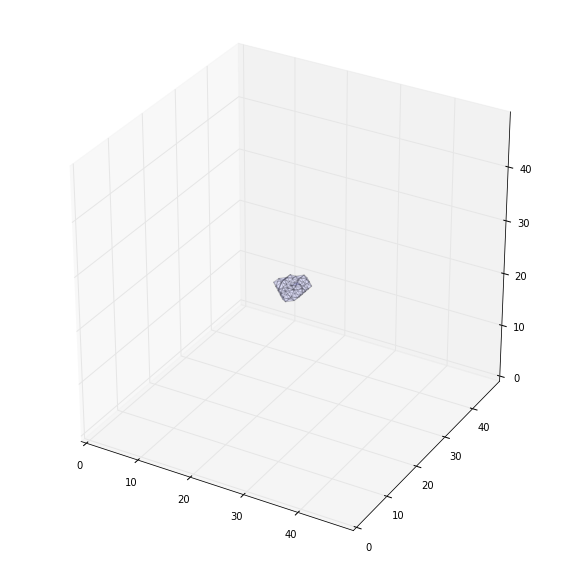

(49, 49, 49)
319 -1000


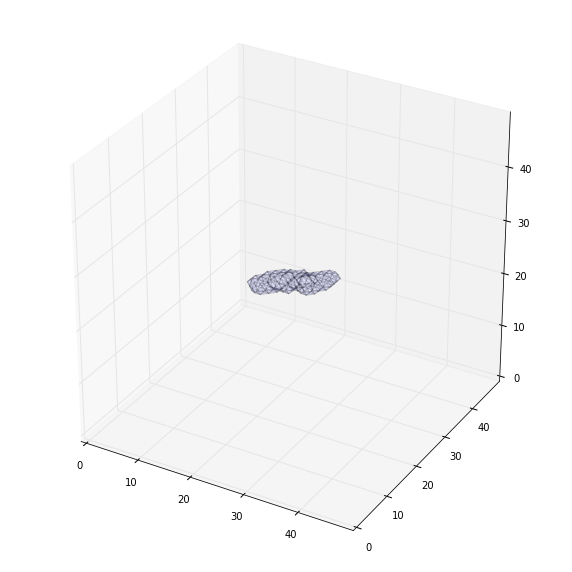

(49, 49, 49)
485 -1000


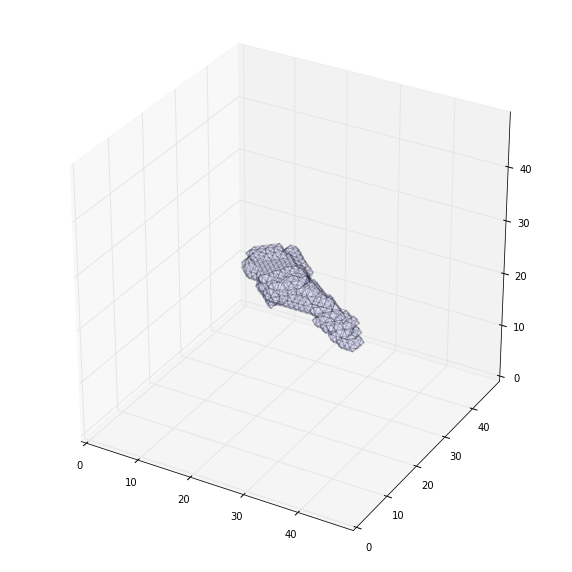

(49, 49, 49)
-1000 -1000
(49, 49, 49)
-200 -1000


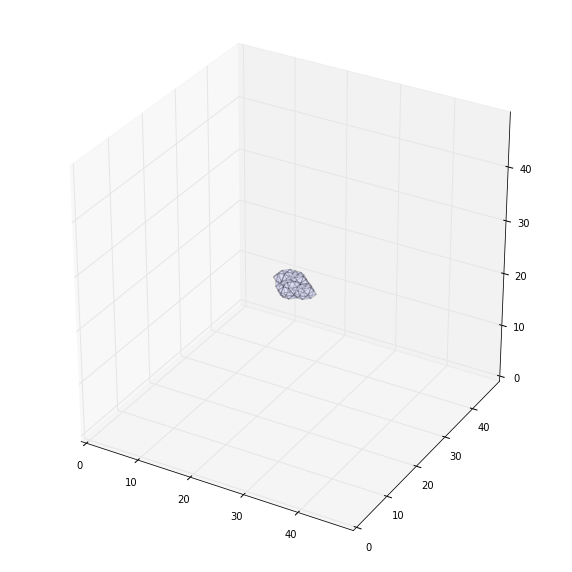

(49, 49, 49)
-249 -1000


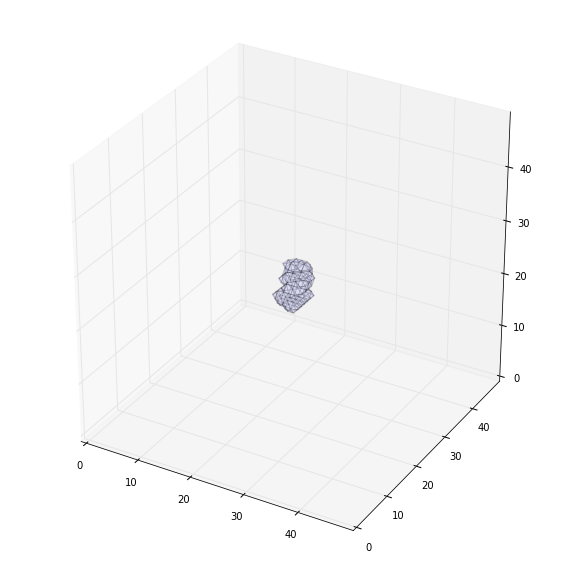

(49, 49, 49)
-200 -1000


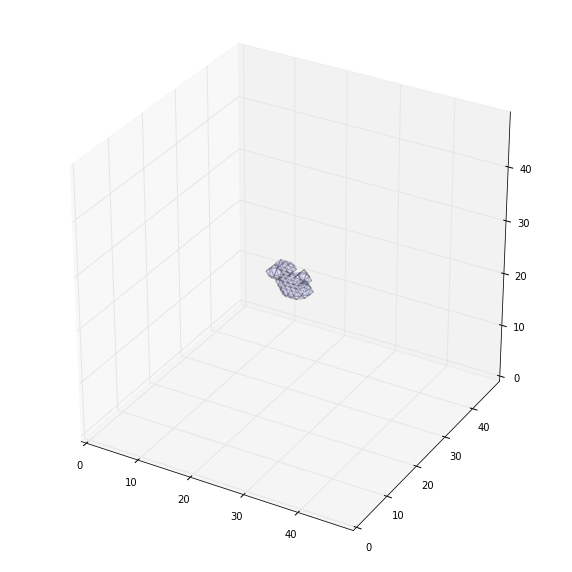

(49, 49, 49)
-297 -1000


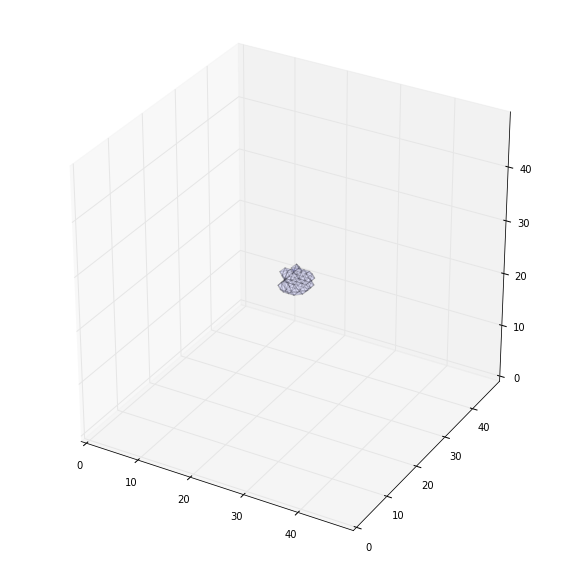

(49, 49, 49)
171 -1000


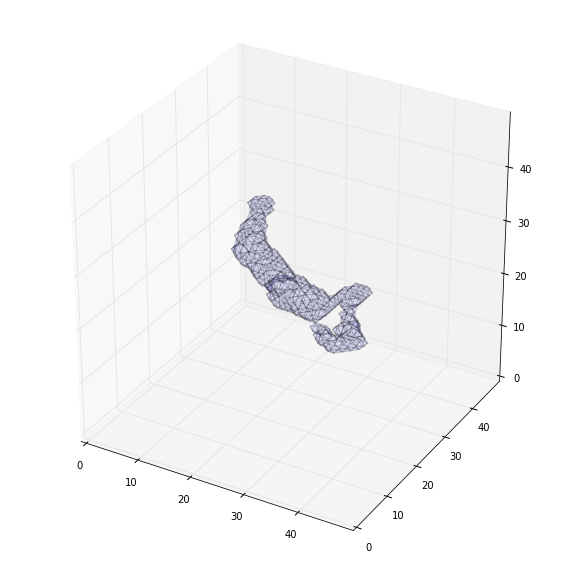

(49, 49, 49)
-103 -1000


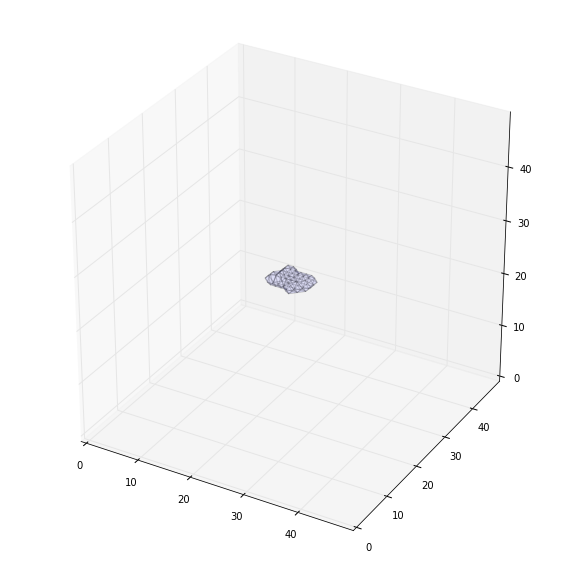

(49, 49, 49)
295 -1000


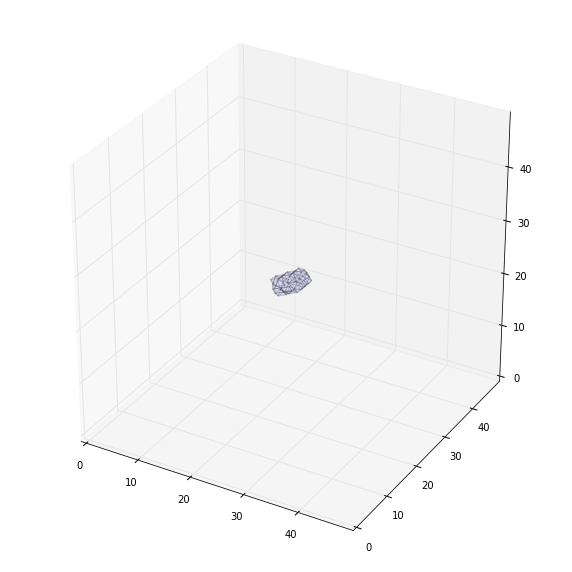

(49, 49, 49)
267 -1000


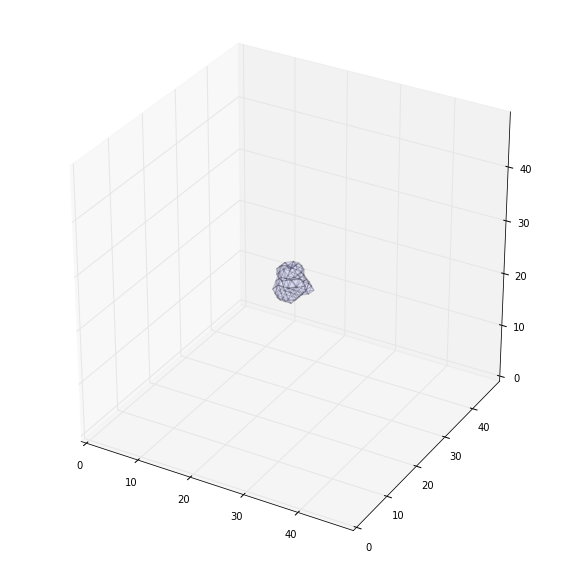

(49, 49, 49)
257 -1000


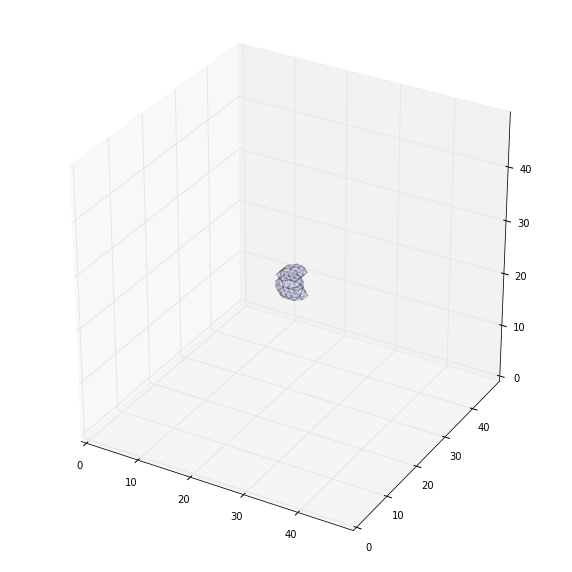

(49, 49, 49)
134 -1000


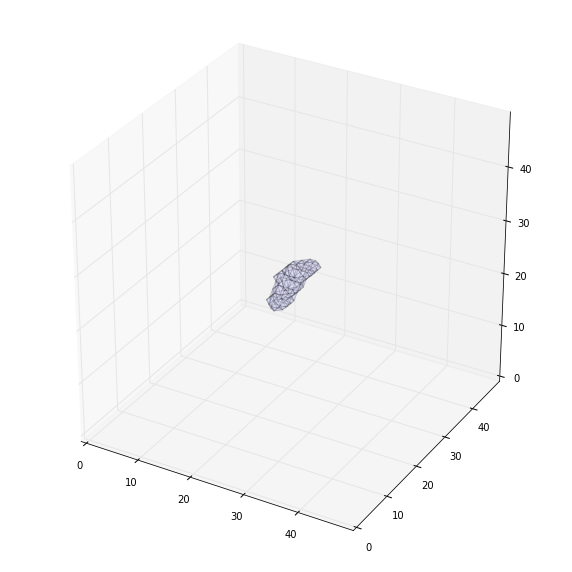

(49, 49, 49)
-139 -1000


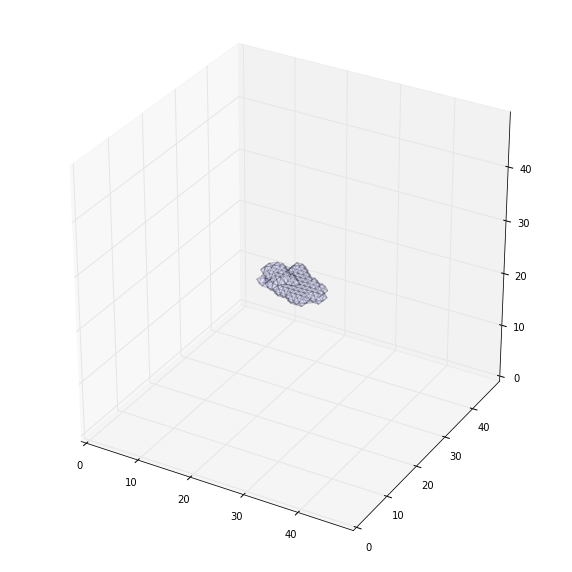

(49, 49, 49)
59 -1000


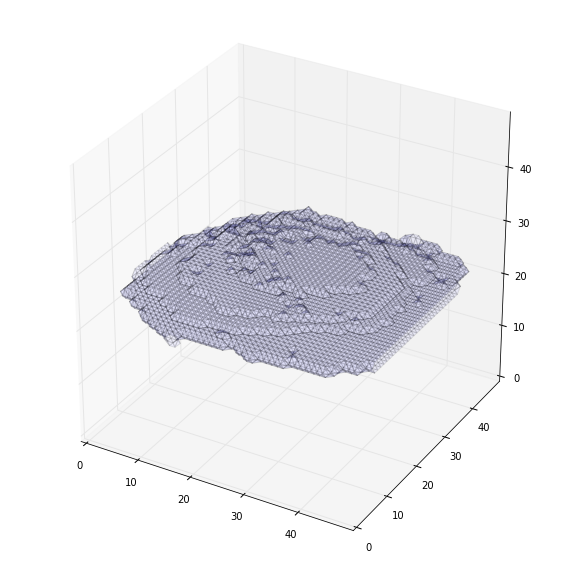

(49, 49, 49)
-50 -1000


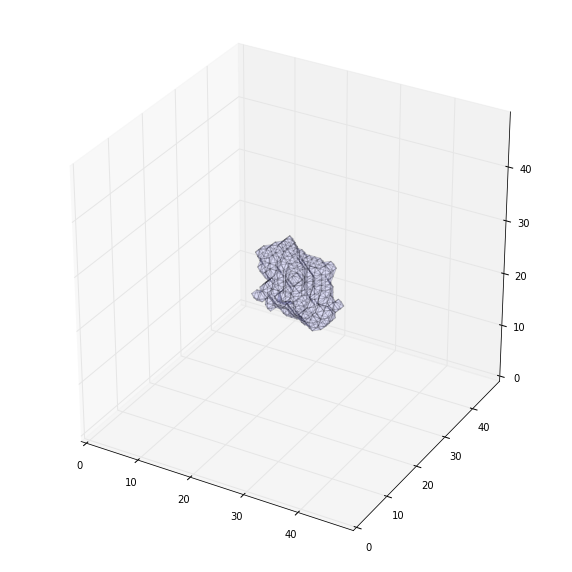

(49, 49, 49)
-92 -1000


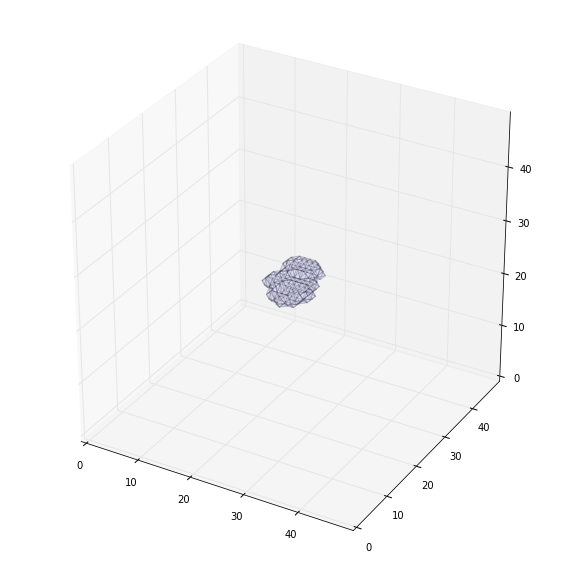

(49, 49, 49)
-13 -1000


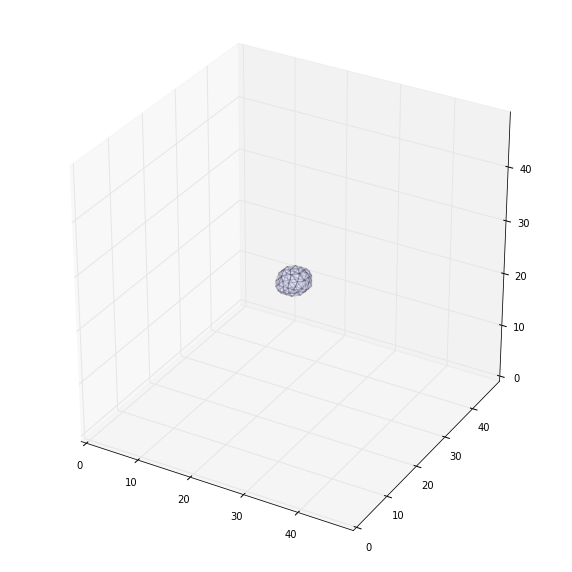

(49, 49, 49)
-133 -1000


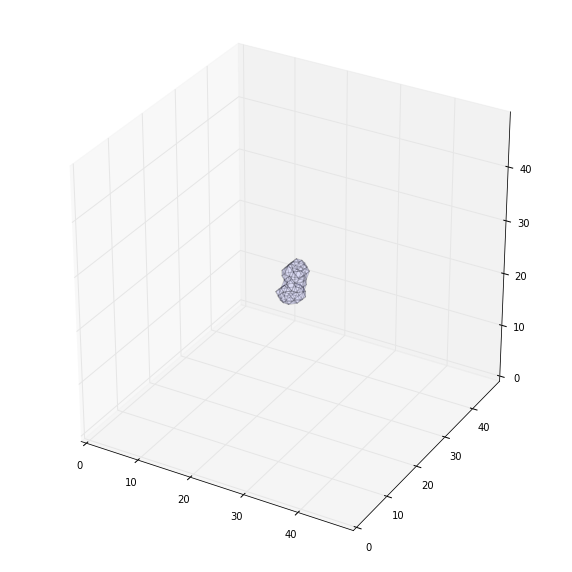

(49, 49, 49)
-53 -1000


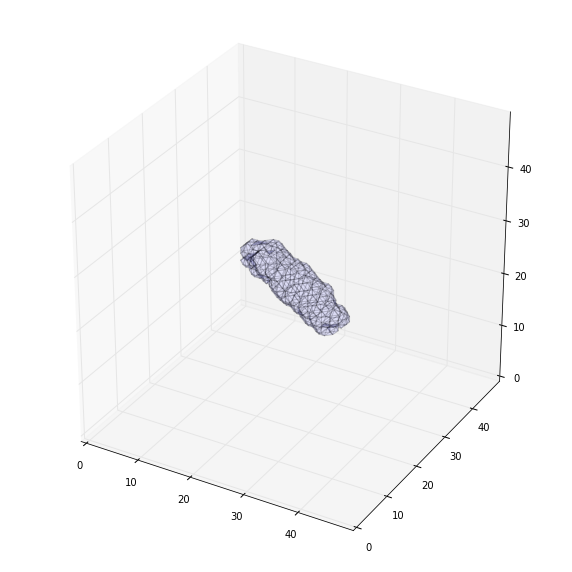

(49, 49, 49)
-55 -1000


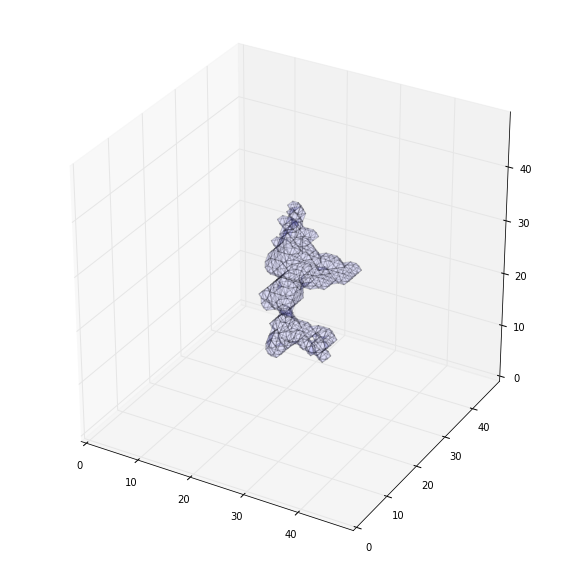

(49, 49, 49)
-58 -1000


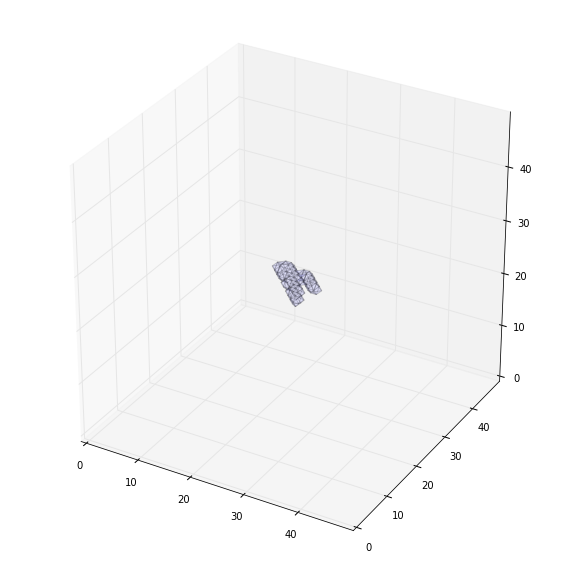

(49, 49, 49)
-18 -1000


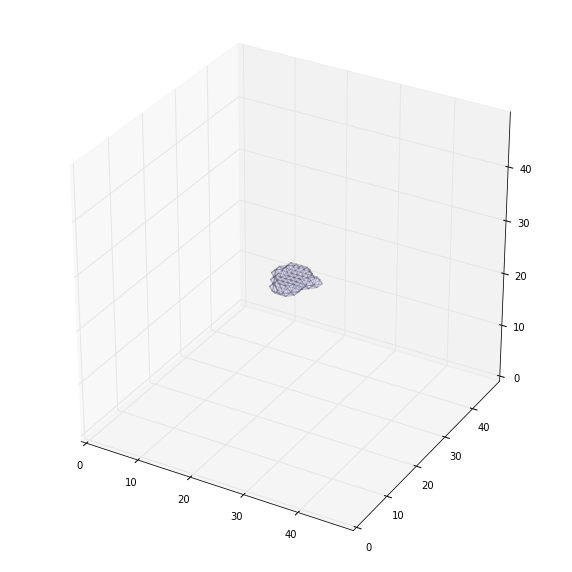

(49, 49, 49)
47 -1000


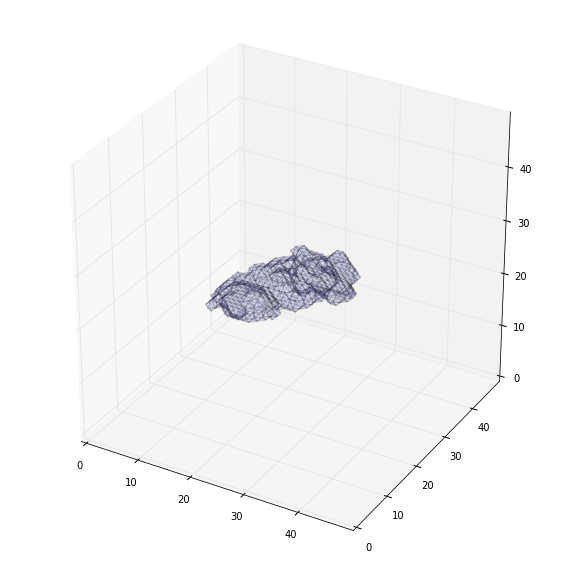

(49, 49, 49)
-130 -1000


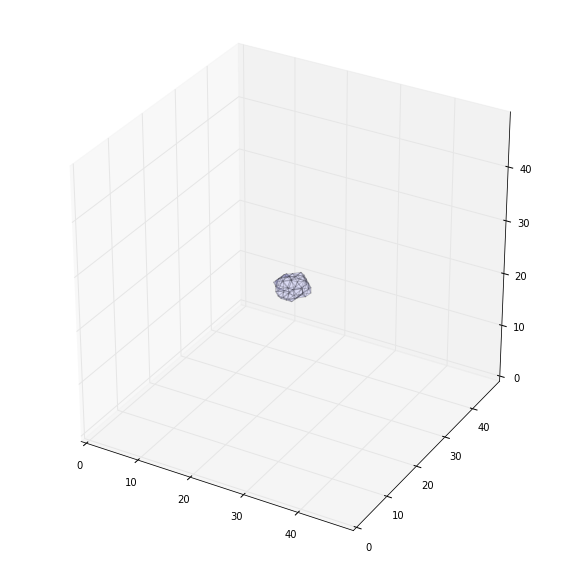

(49, 49, 49)
-49 -1000


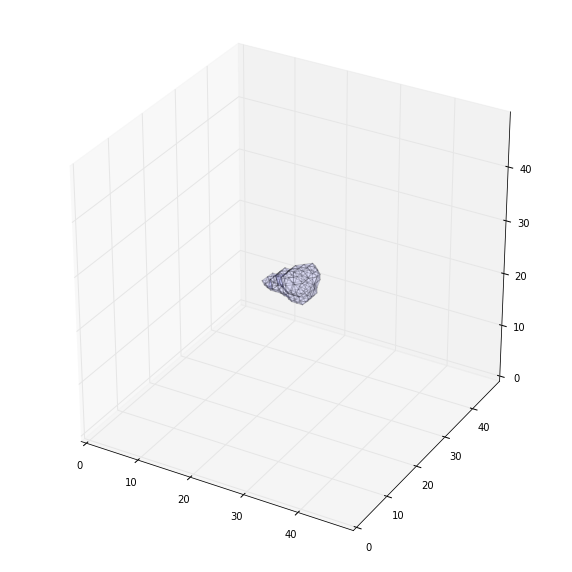

(49, 49, 49)
-109 -1000


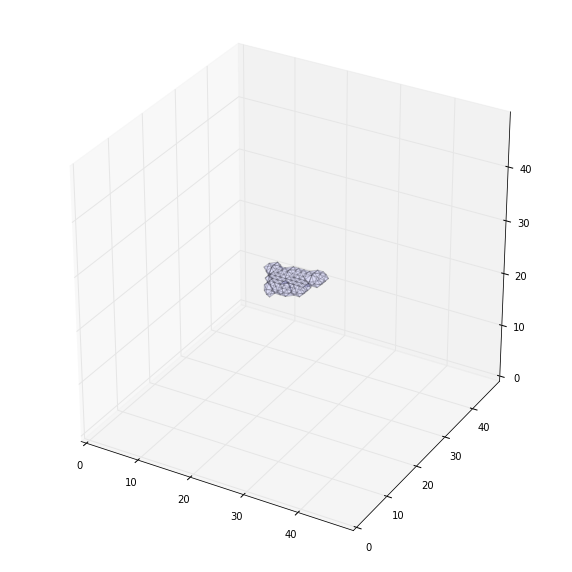

(49, 49, 49)
91 -1000


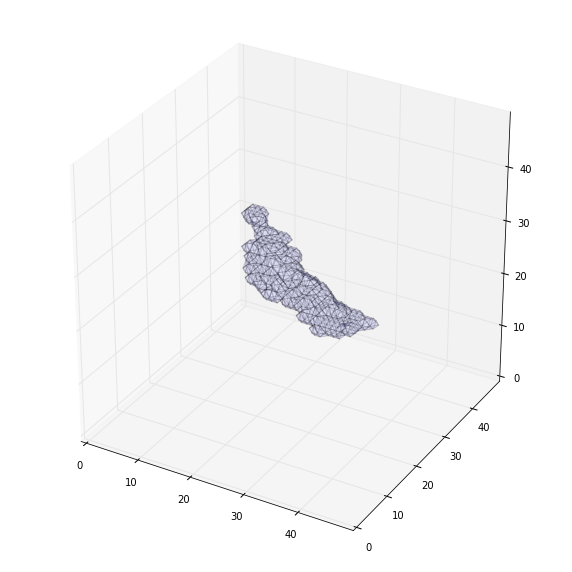

(49, 49, 49)
-186 -1000


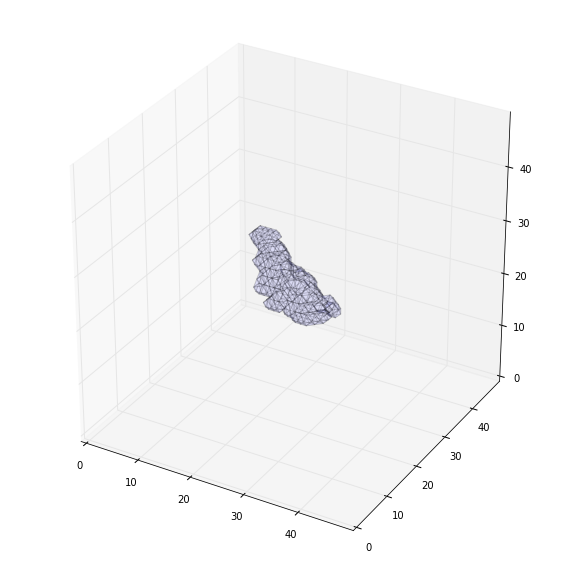

(49, 49, 49)
-159 -1000


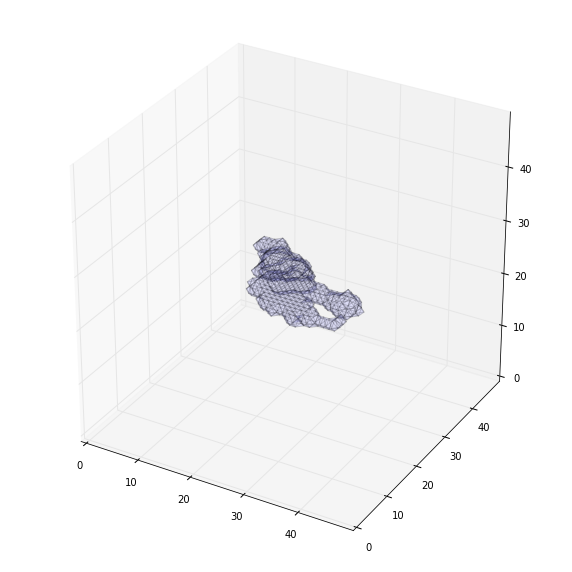

(49, 49, 49)
-40 -1000


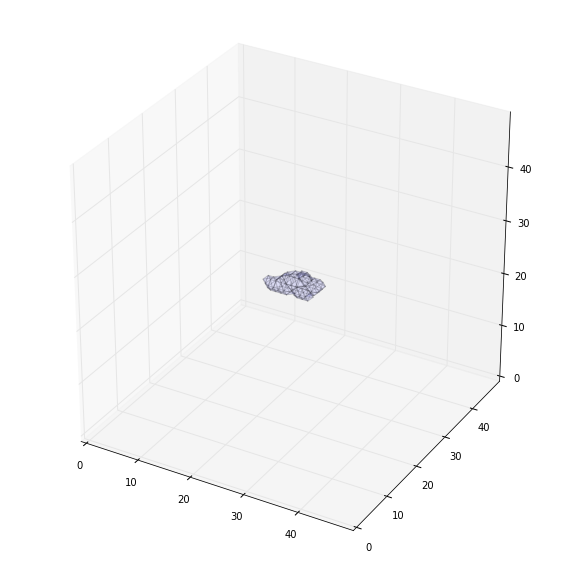

(49, 49, 49)
-41 -1000


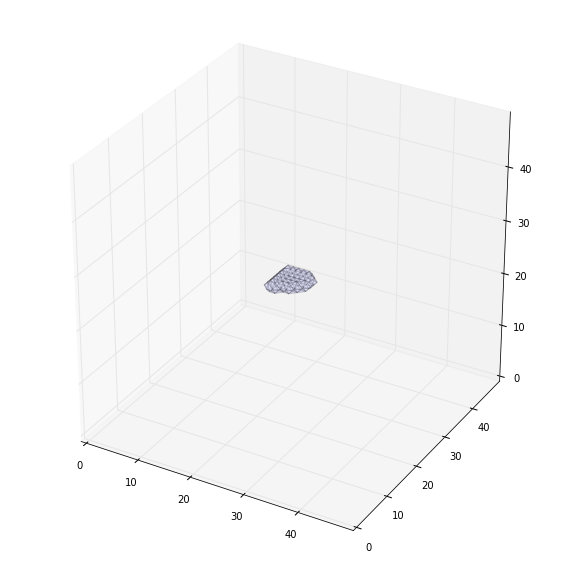

(49, 49, 49)
48 -1000


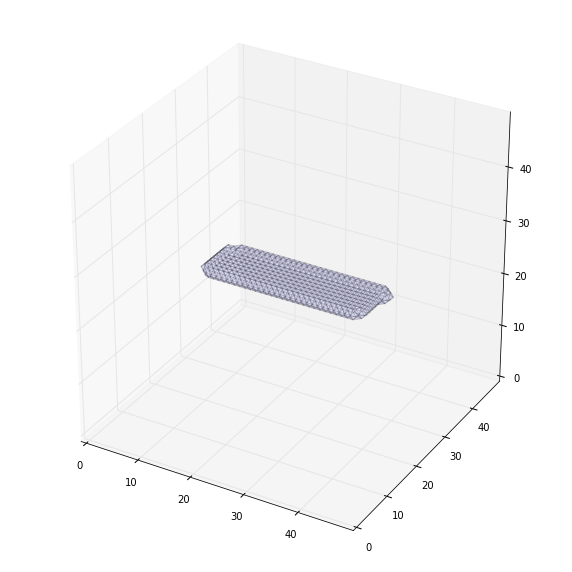

(49, 49, 49)
313 -1000


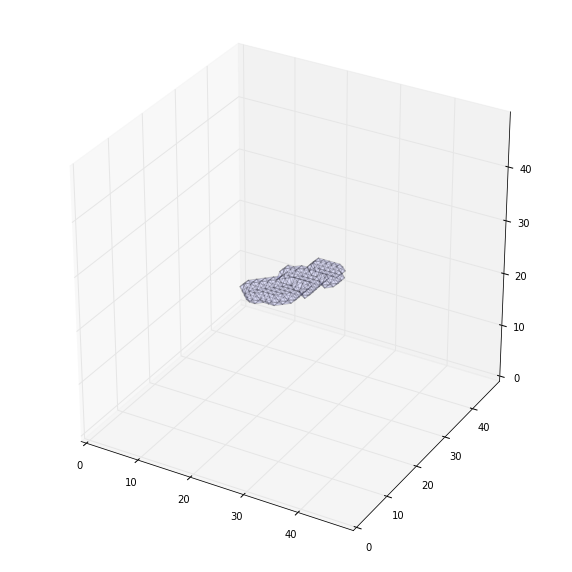

(49, 49, 49)
-305 -1000


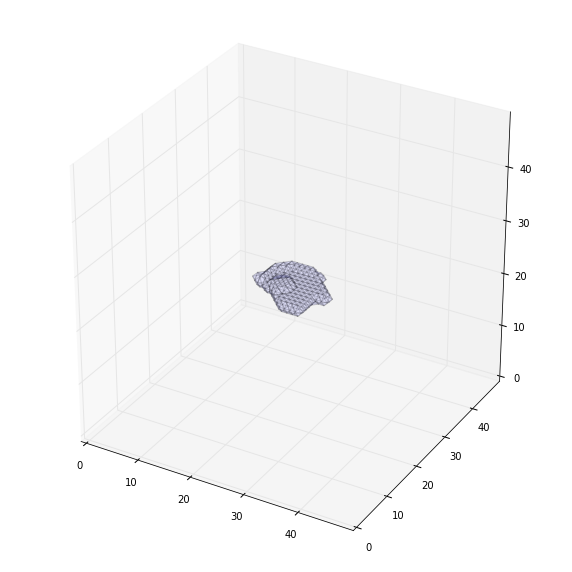

(49, 49, 49)
-140 -1000


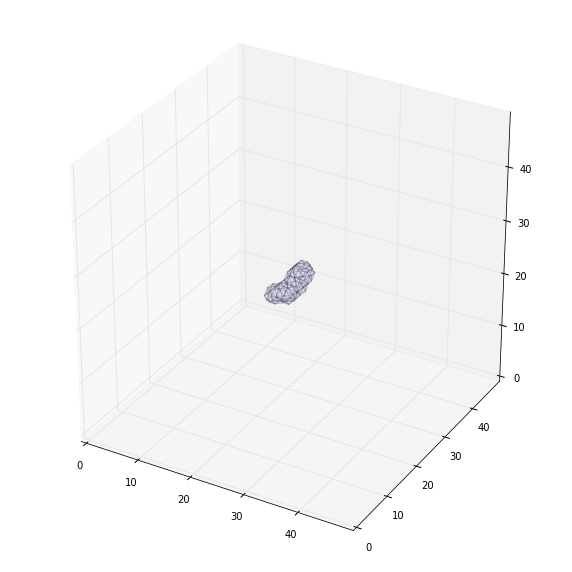

(49, 49, 49)
-201 -1000


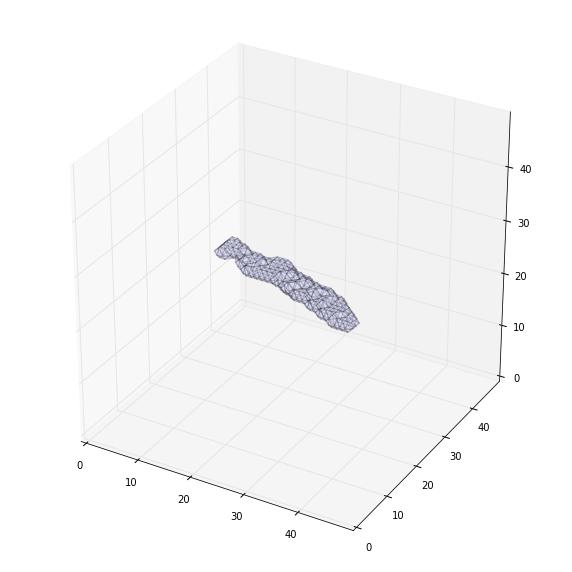

(49, 49, 49)
-25 -1000


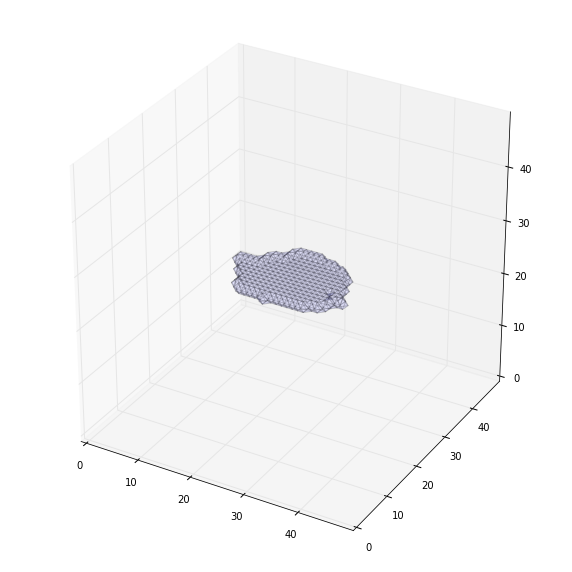

(49, 49, 49)
-137 -1000


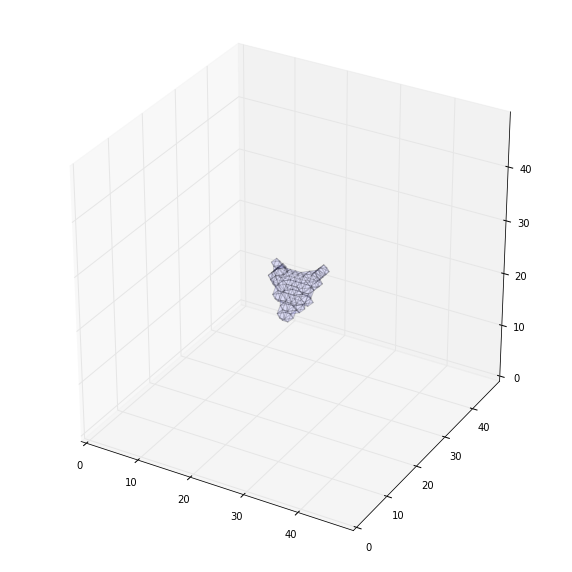

(49, 49, 49)
-176 -1000


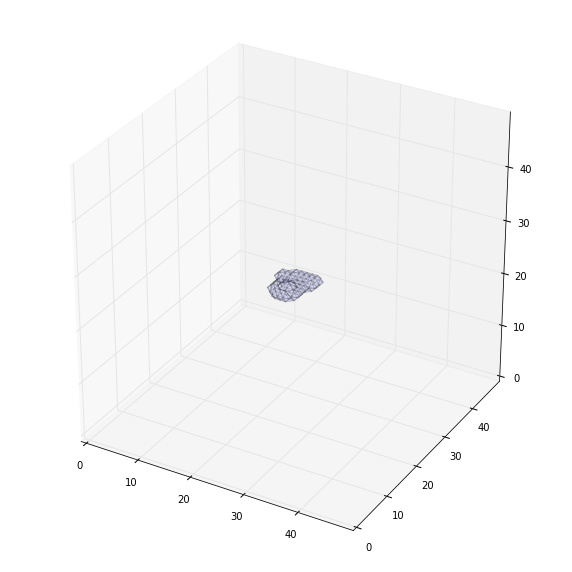

(49, 49, 49)
-111 -1000


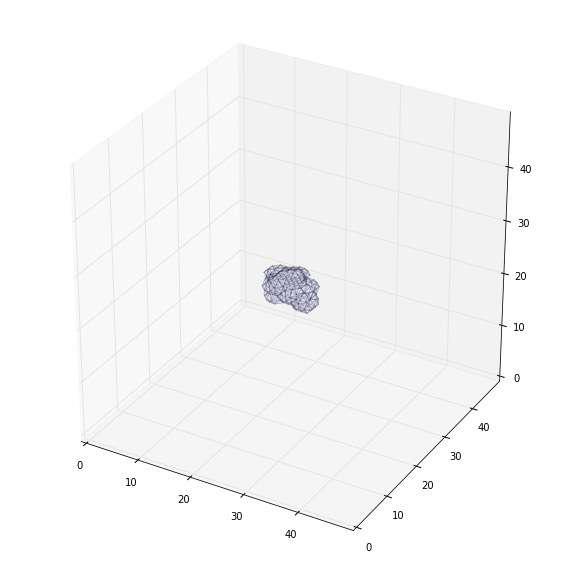

(49, 49, 49)
121 -1000


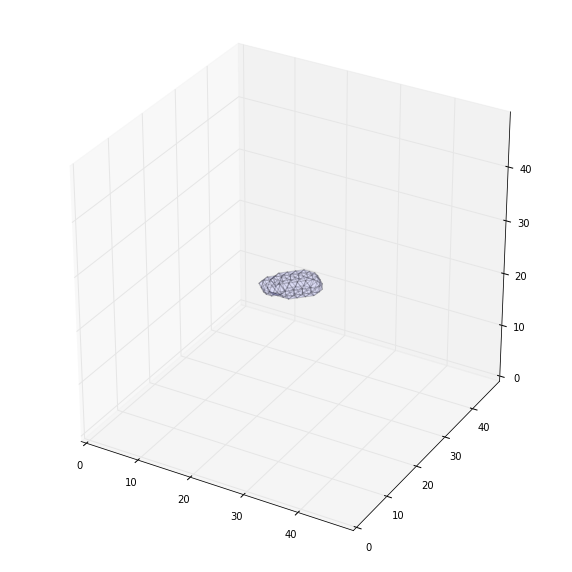

(49, 49, 49)
-73 -1000


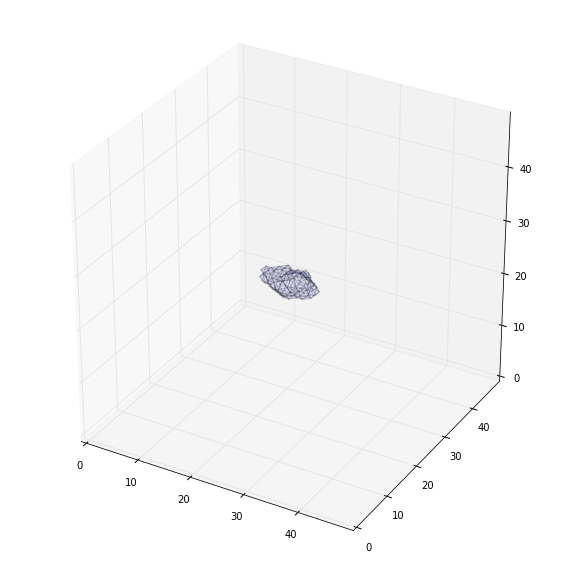

(49, 49, 49)
-1000 -1000
(49, 49, 49)
8 -1000


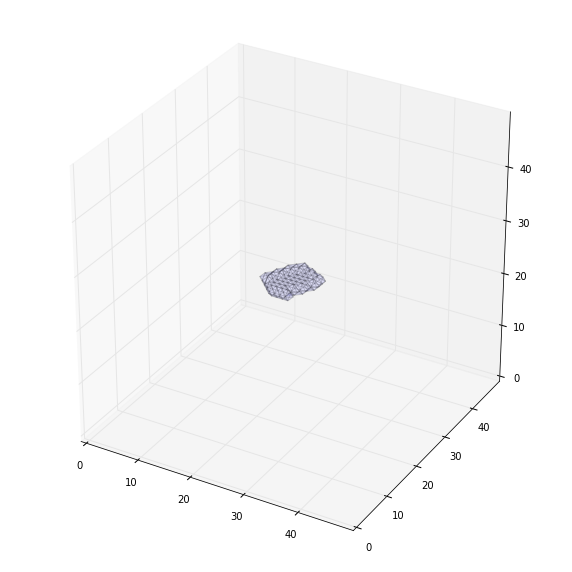

(49, 49, 49)
-1000 -1000
(49, 49, 49)
-139 -1000


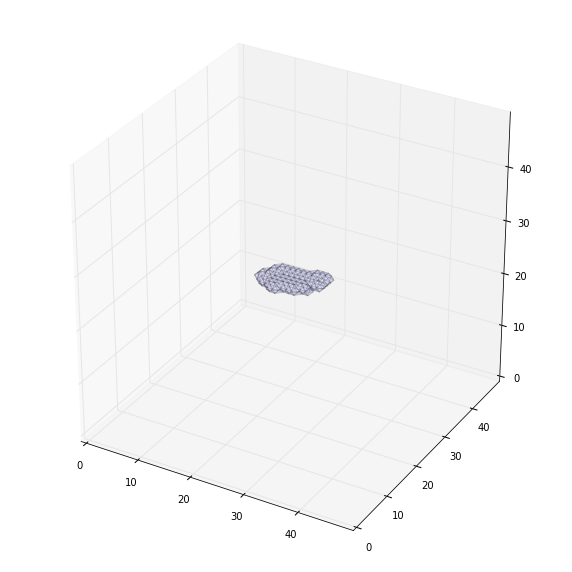

(49, 49, 49)
-22 -1000


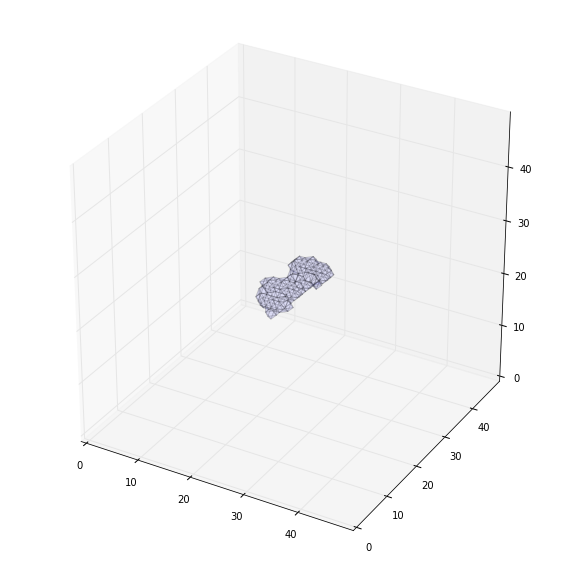

(49, 49, 49)
-60 -1000


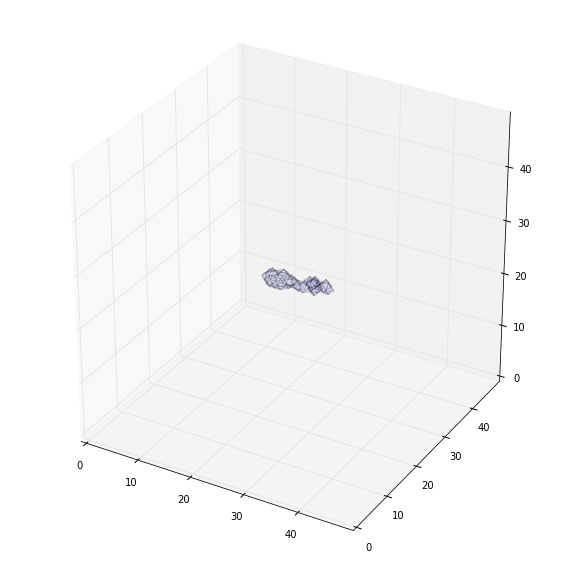

(49, 49, 49)
-98 -1000


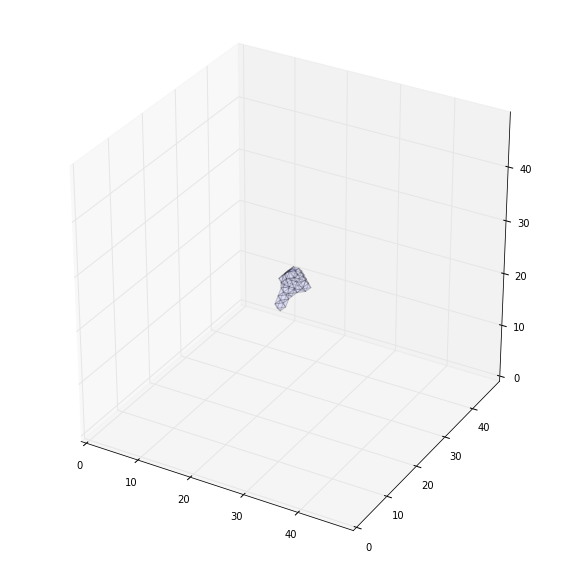

(49, 49, 49)
-35 -1000


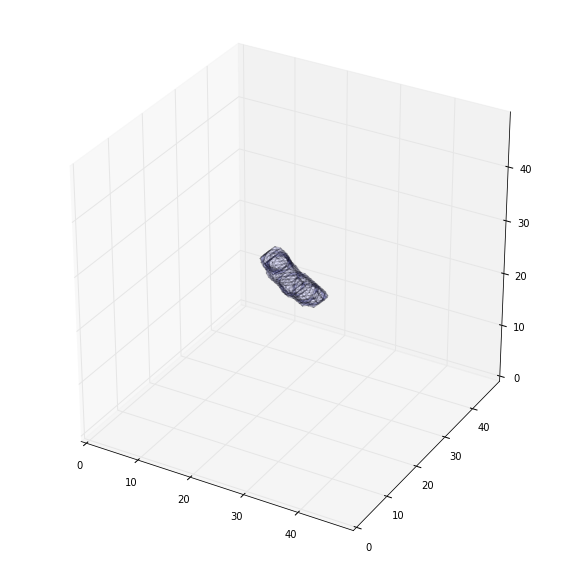

(49, 49, 49)
-109 -1000


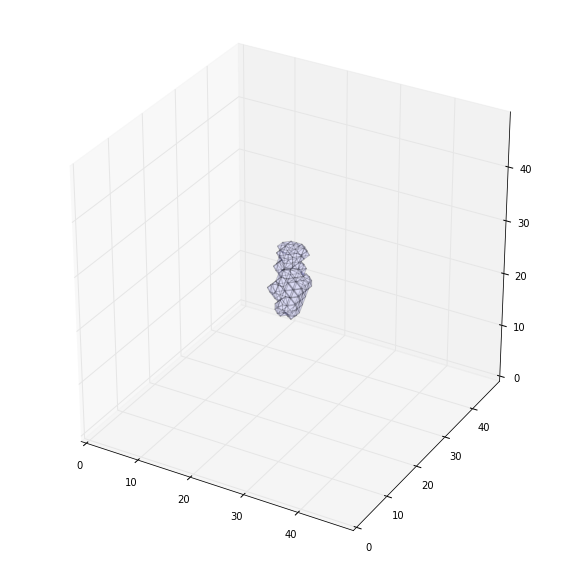

(49, 49, 49)
6 -1000


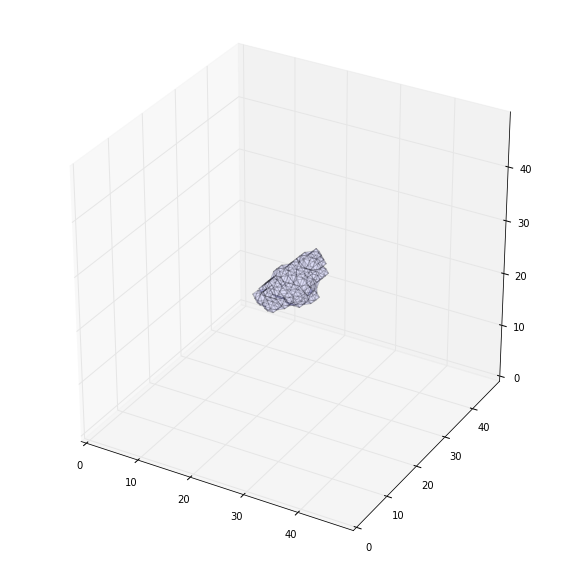

(49, 49, 49)
-1000 -1000
(49, 49, 49)
-1000 -1000
(49, 49, 49)
-163 -1000


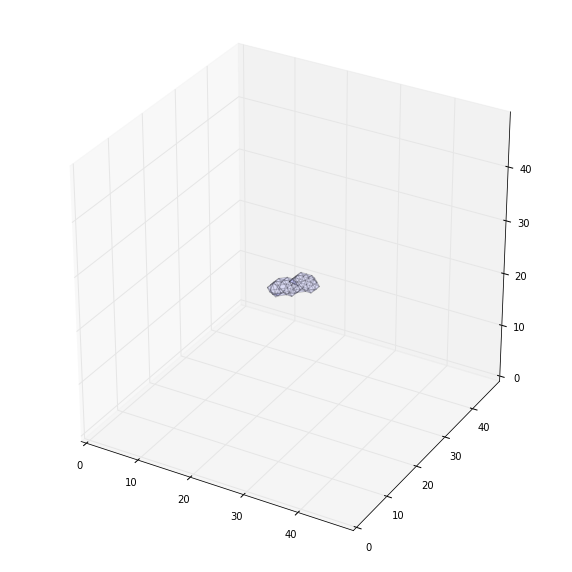

(49, 49, 49)
-4 -1000


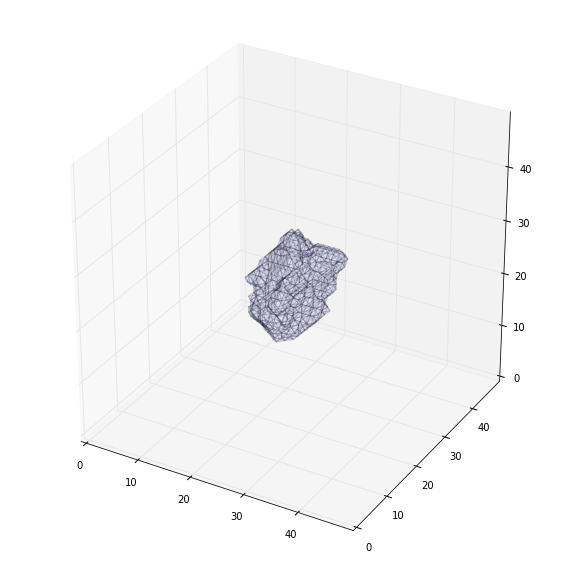

(49, 49, 49)
-149 -1000


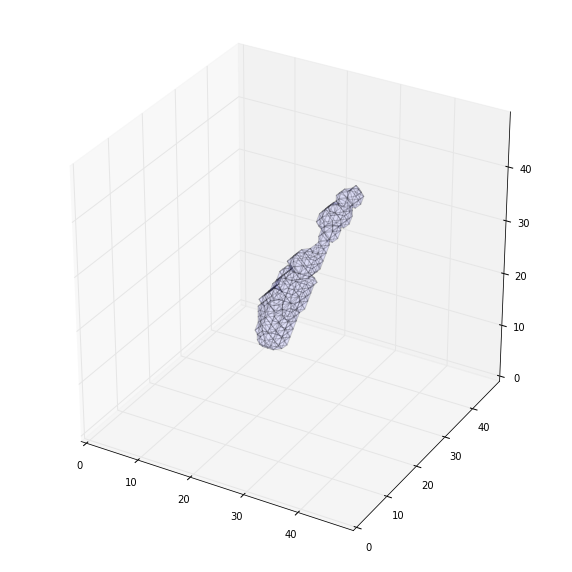

(49, 49, 49)
-220 -1000


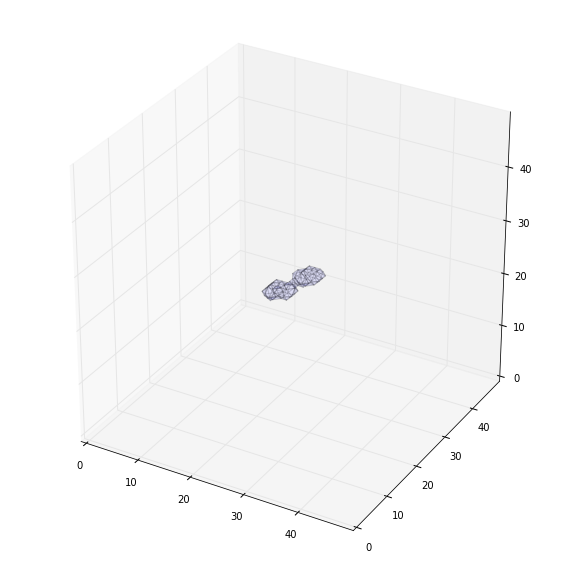

(49, 49, 49)
-195 -1000


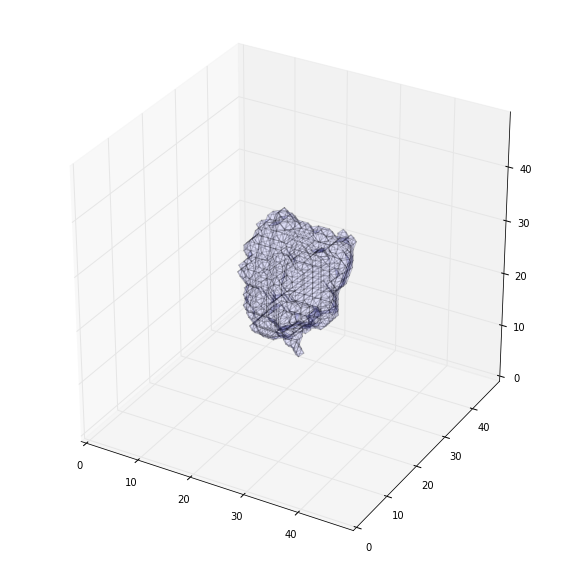

(49, 49, 49)
-277 -1000


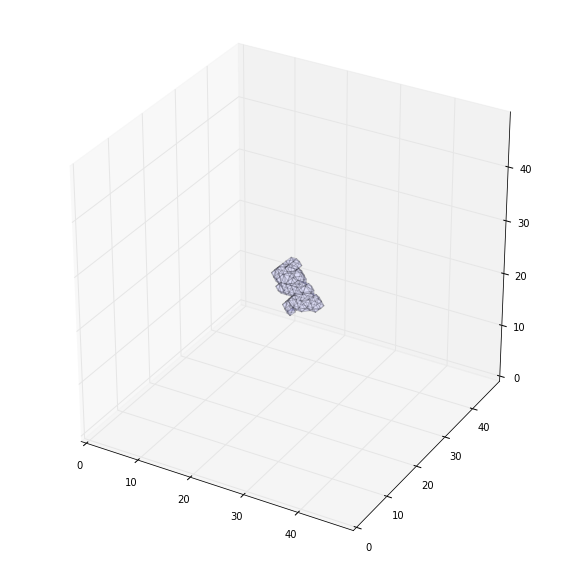

(49, 49, 49)
3 -1000


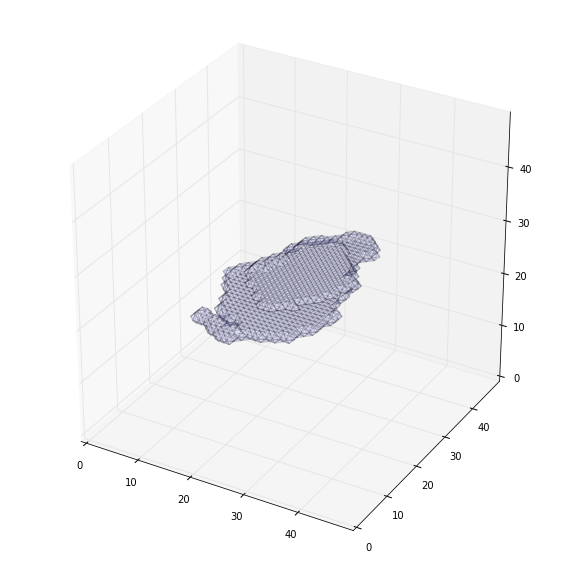

(49, 49, 49)
148 -1000


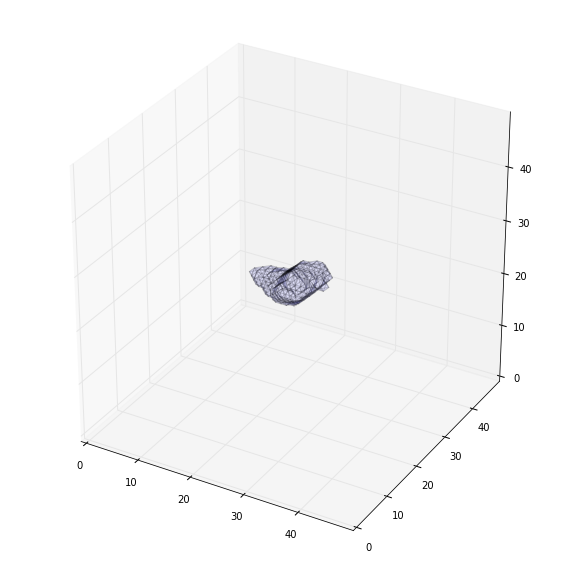

(49, 49, 49)
67 -1000


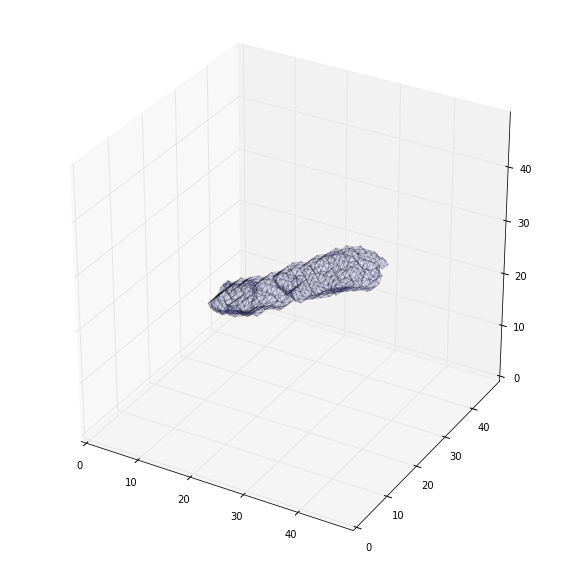

(49, 49, 49)
8 -1000


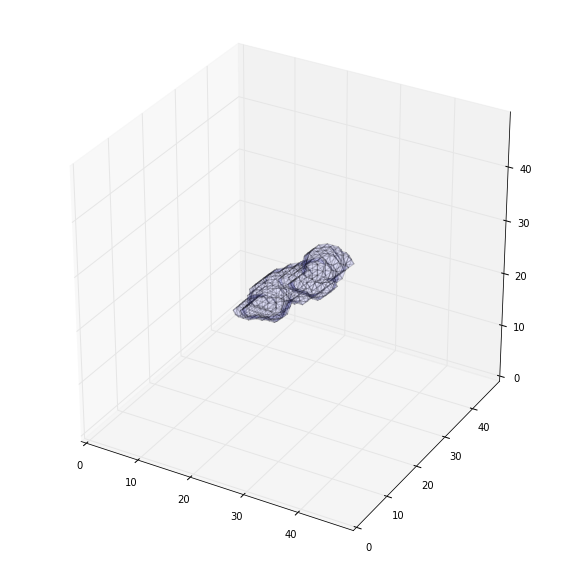

(49, 49, 49)
90 -1000


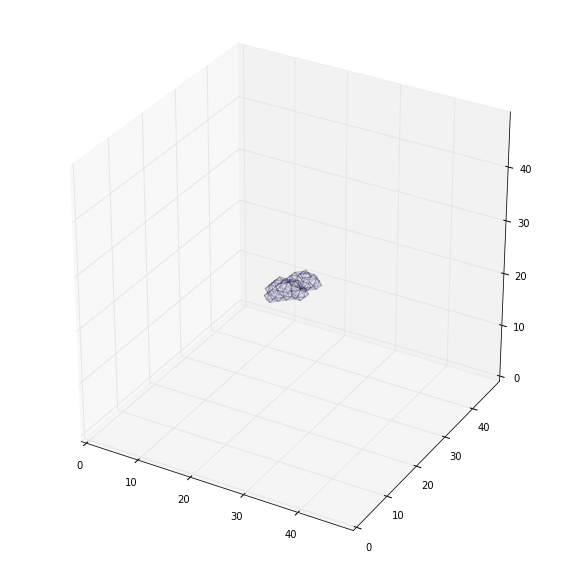

In [17]:
for idx in range(len(train_data)):
    if train_lb[idx] == 1:
        tmp = train_data[idx].transpose(3,0,1,2)
        tmp = tmp[0]
        print tmp.shape
        print np.max(tmp), np.min(tmp)
        if np.max(tmp) == -1000:
            continue
        plot_3d(tmp, 'a', -1000)